In [93]:
#basics
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns

#get census data
from cenpy import products

#spatial
import libpysal
import esda

#mapping/visualization
import geoplot
import mapclassify
from legendgram import legendgram
from palettable import colorbrewer

%matplotlib inline 

In [94]:
sns.set_theme(style="white")
plt.rcParams["figure.dpi"] = 300

In [95]:
!pip list

zsh:1: command not found: pip


In [96]:
###

# plot rate vs rate

In [97]:
case_info = pd.read_csv('case_info.csv')

In [98]:
case_info

,index,Case #,Type,Status,Date Filed,Date Closed
0,NaN,8822364,Traffic,WARRANT,3/12/2020,NaN
1,NaN,8822364,Traffic,WARRANT,3/12/2020,NaN
2,NaN,8822364,Traffic,TERMINATED,12/11/2013,3/13/2018
3,NaN,8822364,Traffic,WARRANT,3/12/2020,NaN
4,NaN,8822364,Traffic,WARRANT,3/12/2020,NaN
...,...,...,...,...,...,...
95367,NaN,8851535,Traffic,JUDGE TO SIGN,5/8/2021,NaN
95368,NaN,8851542,Traffic,JUDGE TO SIGN,5/8/2021,NaN
95369,NaN,8851543,Traffic,WARRANT,5/8/2021,NaN
95370,NaN,8851551,Traffic,WARRANT,5/8/2021,NaN


In [99]:
case_table = pd.read_csv('case_table.csv')

In [100]:
case_table.head()

,level_0,index,Case #,Citation,Date Ticket Issued,Time,Latest Action,Balance Due,Status,ID
0,0.0,0,8012492,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,12/9/2013,09:37 AM,Issued,$0.00,TERMINATED,1390
1,1.0,1,8822364,FAILED TO MAINTAIN ASSURED CLEAR DISTANCE-COLL...,3/9/2020,02:14 PM,Issued,$499.20,WARRANT,1390
2,2.0,2,8822365,FAILED TO MAINTAIN FINANCIAL RESP w/ PRIOR CON...,3/9/2020,02:14 PM,Issued,$943.10,WARRANT,1390
3,3.0,3,8822366,DRIVING WHILE LICENSE INVALID - SUSPENDED,3/9/2020,02:14 PM,Issued,$415.30,WARRANT,1390
4,4.0,0,6515562,SPEEDING-STATE HIGHWAYS,7/1/2007,10:00 AM,Issued,$0.00,Terminated Admin,82


In [101]:
ignore_fields = ['FID', 'Loc_name', 'Status', 'Score', 'Match_type', 'Match_addr',
       'LongLabel', 'ShortLabel', 'Addr_type', 'Type', 'PlaceName',
       'Place_addr', 'Phone', 'URL', 'Rank', 'AddBldg', 'AddNum', 'AddNumFrom',
       'AddNumTo', 'AddRange', 'Side', 'StPreDir', 'StPreType', 'StName',
       'StType', 'StDir', 'BldgType', 'BldgName', 'LevelType', 'LevelName',
       'UnitType', 'UnitName', 'SubAddr', 'StAddr', 'Block', 'Sector', 'Nbrhd',
       'District', 'City', 'MetroArea', 'Subregion', 'Region', 'RegionAbbr',
       'Territory', 'Zone', 'Postal', 'PostalExt', 'Country', 'CntryName',
       'LangCode', 'Distance', 'X', 'Y', 'DisplayX', 'DisplayY', 'Xmin',
       'Xmax', 'Ymin', 'Ymax', 'ExInfo', 'ARC_Addres', 'ARC_Addr_1',
       'ARC_Addr_2', 'ARC_Neighb', 'ARC_City', 'ARC_Subreg', 'ARC_Region',
       'ARC_Postal', 'ARC_Post_1', 'ARC_Countr', 'Field1', 'Street', 'City_1', 
       'State', 'Zip', 'index_sear', 'zip9', 'zip5','zip_plus4', 'index_right', 
       'NAME', 'state','county', 'tract']

In [102]:
ids = gpd.read_file('ids_with_tracts.geojson', ignore_fields=ignore_fields)

In [103]:
ids.columns

Index(['ID', 'Name', 'GEOID', 'level_0', 'index', 'Case #', 'Citation',
       'Date Ticket Issued', 'Time', 'Latest Action', 'Balance Due',
       'Status_y', 'geometry'],
      dtype='object')

In [104]:
ids.shape

(62382, 13)

In [105]:
ids = ids.rename(columns={'Status_y':'Status'})

In [106]:
ids['ID'].isin(case_table['ID']).sum() / len(ids['ID'])

0.9985572761373473

In [107]:
ids = ids.merge(case_info[['Case #','Type']], on='Case #', how='left')

In [108]:
ids

,ID,Name,GEOID,level_0,index,Case #,Citation,Date Ticket Issued,Time,Latest Action,Balance Due,Status,geometry,Type
0,913064,"Abbott, Randall R",48453001774,NaN,0.0,8082522,ALCOHOL AT PARK,4/30/2014,04:14:00,Issued,456.3,WARRANT,POINT (-97.84550 30.15781),City Ordinance
1,2137171,"Acosta, Jose",48453001774,NaN,0.0,8638021,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,11/6/2017,12:20:00,Issued,514.8,WARRANT,POINT (-97.84166 30.15631),Traffic
2,2137171,"Acosta, Jose",48453001774,NaN,1.0,8638022,NO DRIVERS LICENSE,11/6/2017,12:20:00,Issued,292.5,WARRANT,POINT (-97.84166 30.15631),Traffic
3,2137171,"Acosta, Jose",48453001774,NaN,2.0,8638023,SPEEDING - STATE HIGHWAY - LESS THAN 10% OVER ...,11/6/2017,12:20:00,Issued,280.8,WARRANT,POINT (-97.84166 30.15631),Traffic
4,2153515,"Aguilar-Garcia, Jessica",48453001774,NaN,0.0,8820781,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,2/27/2020,04:07:00,Issued,514.1,WARRANT,POINT (-97.83633 30.15367),Traffic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74523,2243277,"Martinez, Richard",48453001919,NaN,0.0,8745028,ELECTRONIC DEVICE USE WHILE DRIVING,2/7/2019,08:22:00,Issued,448.5,WARRANT,POINT (-97.78762 30.27831),City Ordinance
74524,2243277,"Martinez, Richard",48453001919,NaN,1.0,8745029,NO DRIVERS LICENSE,2/7/2019,08:22:00,Issued,292.5,WARRANT,POINT (-97.78762 30.27831),Traffic
74525,1787280,"Gutierres, Maria",48453001918,NaN,0.0,8231835,ELECTRONIC DEVICE USE WHILE DRIVING,2/10/2015,10:05:00,Issued,448.5,WARRANT,POINT (-97.81685 30.29616),City Ordinance
74526,1787280,"Gutierres, Maria",48453001918,NaN,1.0,8231836,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,2/10/2015,10:05:00,Issued,514.8,WARRANT,POINT (-97.81685 30.29616),Traffic


In [109]:
ids = ids[ids['Status'] == 'WARRANT']

In [110]:
ids = ids.drop(['level_0','index'], axis=1)

In [111]:
ids = ids.drop_duplicates()

In [112]:
ids.shape

(33416, 12)

## check tract feature correlations

In [113]:
tract_features = gpd.read_file('tract_features.geojson')

In [114]:
tract_features.columns

Index(['GEOID', 'total population', '[denominator: total population for Race]',
       'total: White', 'total: Black', 'total: Asian',
       '[denominator: total population for Hispanic or Latino]',
       'total: Hispanic or Latino (any race)',
       '[denominator: total population for poverty]',
       'total: income below poverty level', 'median gross rent',
       '[denominator: total population for income on rent]',
       'total: paying >50 percent of income on rent', 'NAME', 'state',
       'county', 'tract', 'count of individuals with warrant record',
       'warrant prevalence', 'geometry'],
      dtype='object')

<AxesSubplot:xlabel='total: White', ylabel='count of individuals with warrant record'>

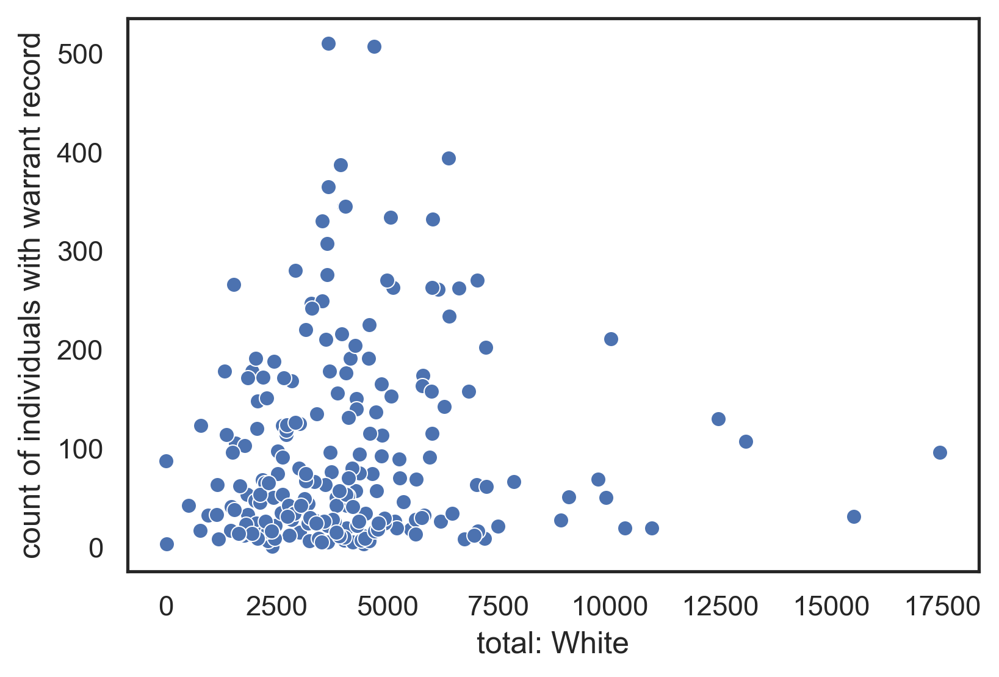

In [115]:
sns.scatterplot(data=tract_features,
               x='total: White',
               y='count of individuals with warrant record')

In [116]:
tract_features[
    ['GEOID','count of individuals with warrant record','total: White', 'total: Black', 'total: Asian','total: Hispanic or Latino (any race)' ]
    ].melt(id_vars='GEOID')

,GEOID,variable,value
0,48453001779,count of individuals with warrant record,26.0
1,48453001778,count of individuals with warrant record,7.0
2,48453001740,count of individuals with warrant record,19.0
3,48453001729,count of individuals with warrant record,57.0
4,48453002423,count of individuals with warrant record,89.0
...,...,...,...
1085,48453000306,total: Hispanic or Latino (any race),1162.0
1086,48453002201,total: Hispanic or Latino (any race),1117.0
1087,48453002319,total: Hispanic or Latino (any race),827.0
1088,48453002207,total: Hispanic or Latino (any race),6561.0


<AxesSubplot:xlabel='count of individuals with warrant record', ylabel='value'>

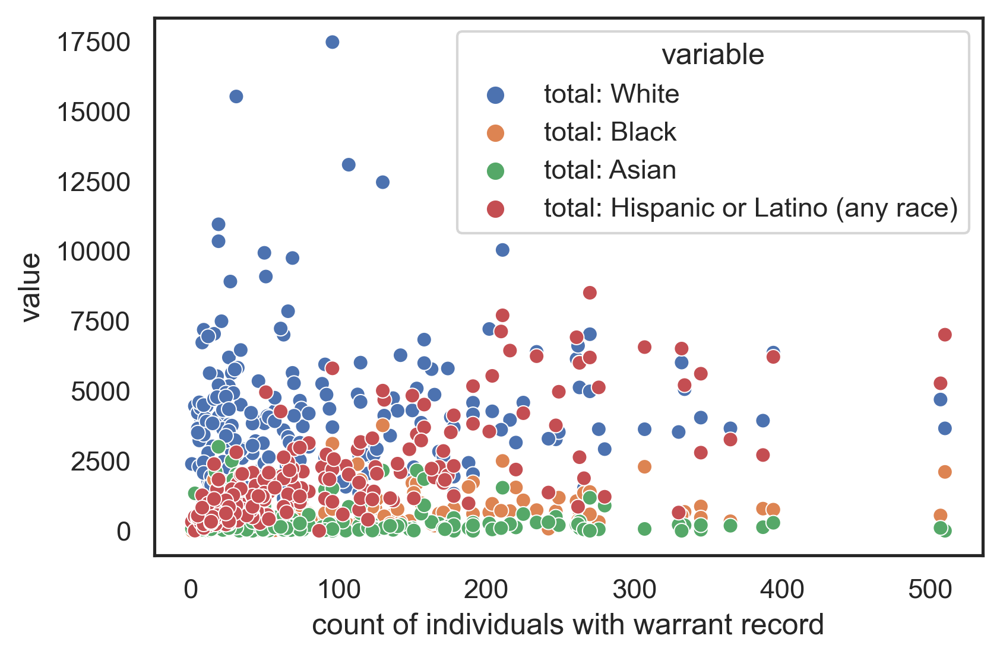

In [117]:
sns.scatterplot(data=tract_features[
    ['count of individuals with warrant record','total: White', 'total: Black', 'total: Asian','total: Hispanic or Latino (any race)' ]
    ].melt(id_vars='count of individuals with warrant record'),
               x='count of individuals with warrant record',
               y='value',
               hue='variable')

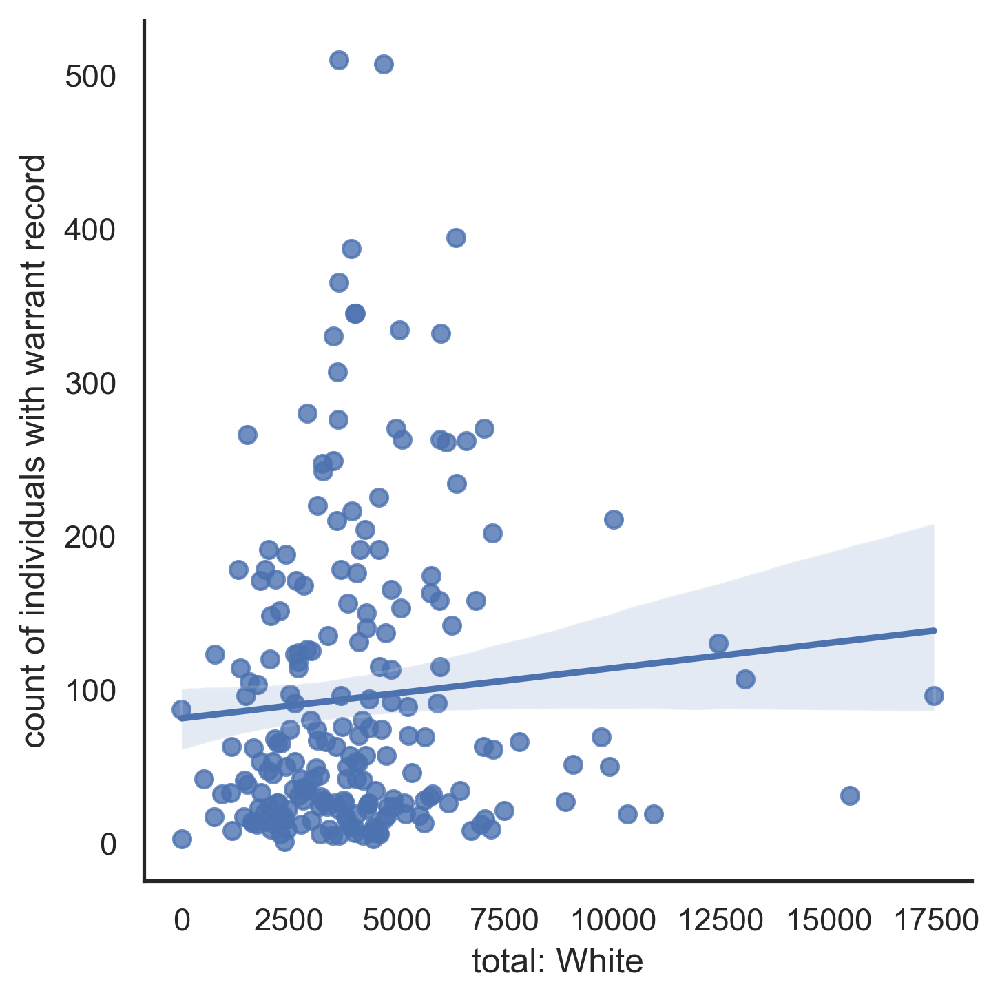

In [118]:
sns.lmplot(data=tract_features,
           y='count of individuals with warrant record',
           x='total: White')

/opt/anaconda3/envs/mapper2/lib/python3.7/site-packages/seaborn/axisgrid.py:1740: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  f.tight_layout()


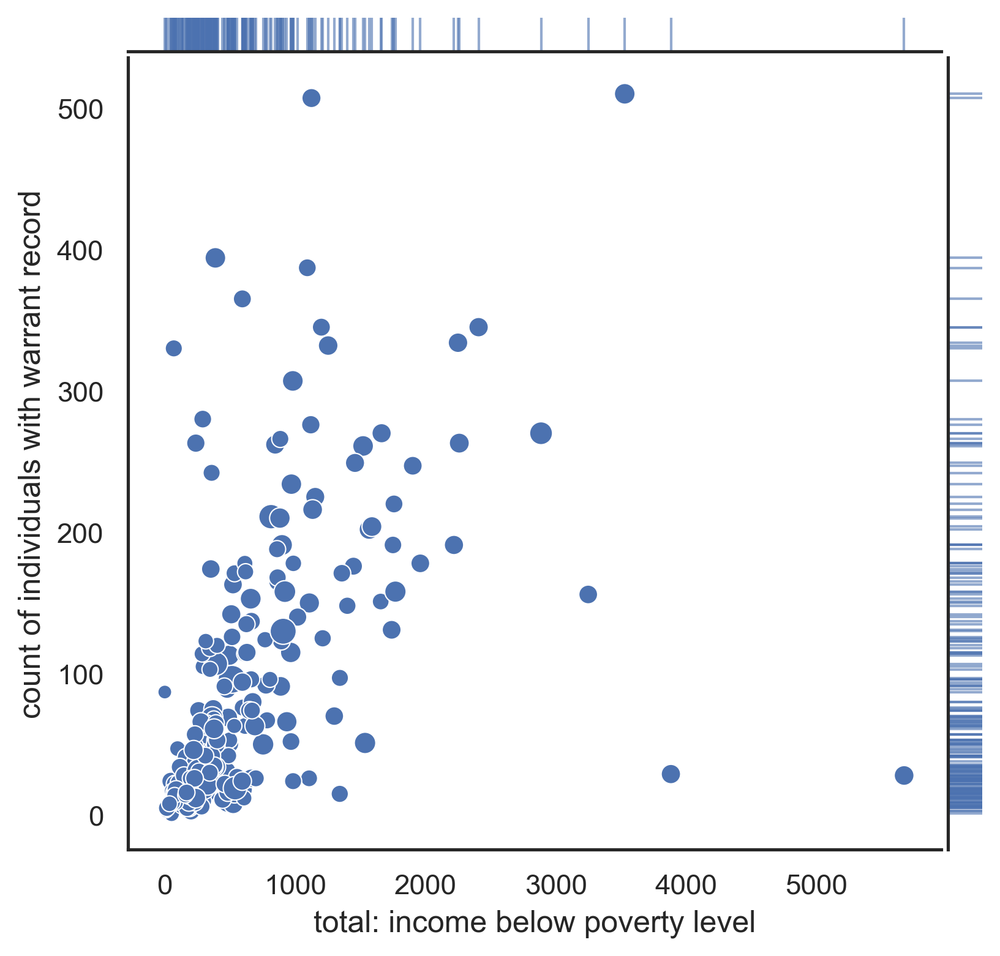

In [119]:
g = sns.JointGrid(data=tract_features,
                  x='total: income below poverty level',
                  y='count of individuals with warrant record', 
                  ratio=20)
g.plot_joint(sns.scatterplot, 
             size=tract_features['total population'], 
             sizes=(30, 120),
             legend=False)
g.plot_marginals(sns.rugplot, 
                 height=1, 
                 alpha=.6)

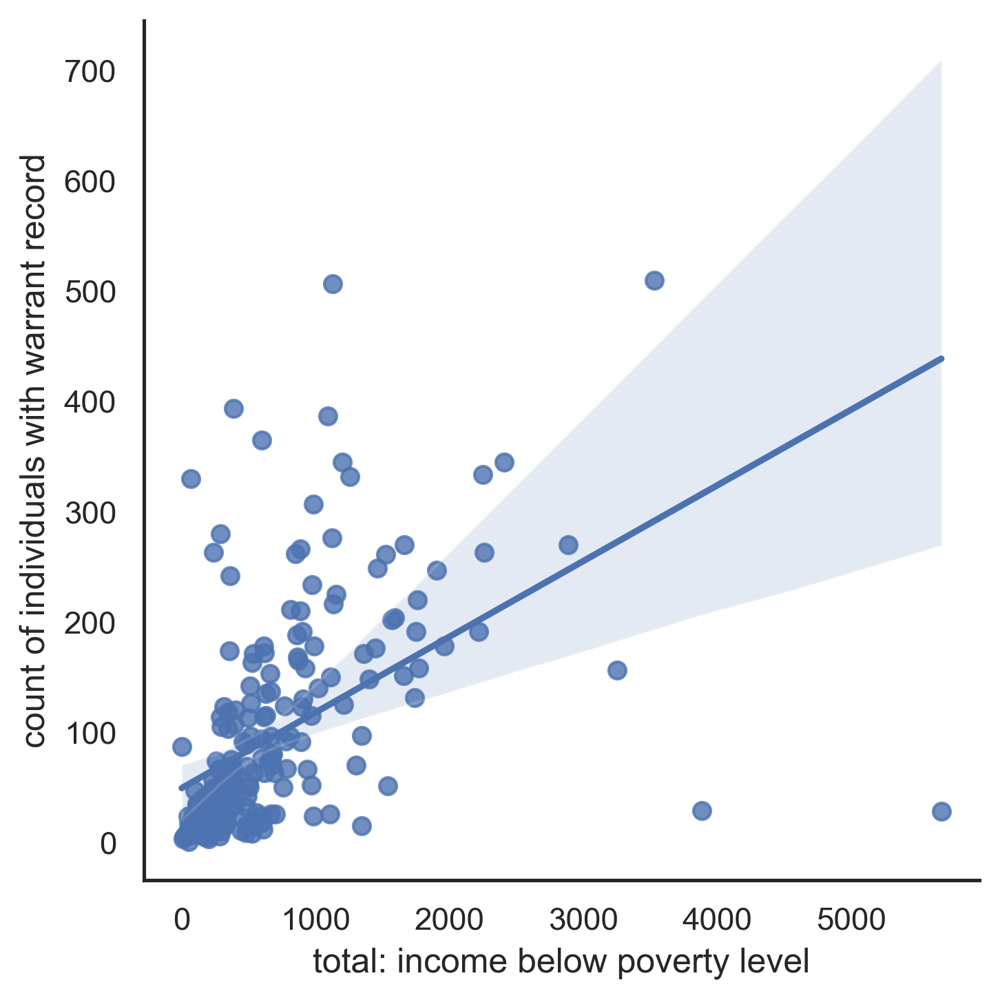

In [120]:
sns.lmplot(data=tract_features,
                  x='total: income below poverty level',
                  y='count of individuals with warrant record')

In [121]:
tract_features.columns[:-3]

Index(['GEOID', 'total population', '[denominator: total population for Race]',
       'total: White', 'total: Black', 'total: Asian',
       '[denominator: total population for Hispanic or Latino]',
       'total: Hispanic or Latino (any race)',
       '[denominator: total population for poverty]',
       'total: income below poverty level', 'median gross rent',
       '[denominator: total population for income on rent]',
       'total: paying >50 percent of income on rent', 'NAME', 'state',
       'county', 'tract'],
      dtype='object')

In [122]:
plot_vars = ['count of individuals with warrant record',
             'total: White', 
             'total: Black', 
             'total: Asian', 
             'total: Hispanic or Latino (any race)',
             'total: income below poverty level', 
             'median gross rent',
             'total: paying >50 percent of income on rent']

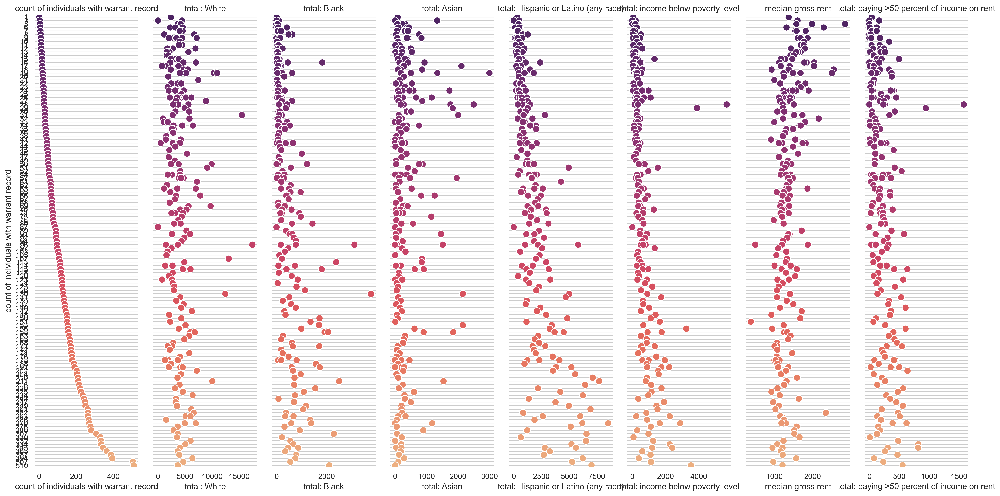

In [123]:
g = sns.PairGrid(data=tract_features.sort_values(by='count of individuals with warrant record', ascending=False),
                 x_vars=plot_vars,
                 y_vars=['count of individuals with warrant record'],
                 height=10, aspect=.25)

g.map(sns.stripplot, size=10, orient="h", jitter=False,
      palette="flare_r", linewidth=1, edgecolor="w")

sns.despine(left=True, bottom=True)


titles = plot_vars

for ax, title in zip(g.axes.flat, titles):

    # Set a different title for each axes
    ax.set(title=title)

    # Make the grid horizontal instead of vertical
    ax.xaxis.grid(False)
    ax.yaxis.grid(True)


In [124]:
## plot portion of warrants vs portion of race

In [125]:
tract_features.columns

Index(['GEOID', 'total population', '[denominator: total population for Race]',
       'total: White', 'total: Black', 'total: Asian',
       '[denominator: total population for Hispanic or Latino]',
       'total: Hispanic or Latino (any race)',
       '[denominator: total population for poverty]',
       'total: income below poverty level', 'median gross rent',
       '[denominator: total population for income on rent]',
       'total: paying >50 percent of income on rent', 'NAME', 'state',
       'county', 'tract', 'count of individuals with warrant record',
       'warrant prevalence', 'geometry'],
      dtype='object')

In [126]:
portion_cols = ['total population',
 'total: White',
 'total: Black', 
 'total: Asian',
 'total: Hispanic or Latino (any race)',
 'total: income below poverty level',
 'total: paying >50 percent of income on rent',
 'count of individuals with warrant record']

In [127]:
tract_features[portion_cols].sum()

total population                               1226805.0
total: White                                    889046.0
total: Black                                    101955.0
total: Asian                                     82257.0
total: Hispanic or Latino (any race)            414745.0
total: income below poverty level               143785.0
total: paying >50 percent of income on rent      48386.0
count of individuals with warrant record         20621.0
dtype: float64

In [128]:
(tract_features[portion_cols] / tract_features[portion_cols].sum())

,total population,total: White,total: Black,total: Asian,total: Hispanic or Latino (any race),total: income below poverty level,total: paying >50 percent of income on rent,count of individuals with warrant record
0,0.005336,0.006965,0.001952,0.000644,0.002876,0.001968,0.000785,0.001261
1,0.003537,0.004522,0.001775,0.000717,0.000911,0.000536,0.002563,0.000339
2,0.004089,0.004575,0.002099,0.006091,0.002375,0.001523,0.002315,0.000921
3,0.004137,0.004805,0.000186,0.005835,0.003933,0.002309,0.007482,0.002764
4,0.004896,0.005907,0.003658,0.001617,0.005476,0.003324,0.007626,0.004316
...,...,...,...,...,...,...,...,...
213,0.004914,0.005176,0.003884,0.007574,0.002802,0.004382,0.008577,0.005577
214,0.001812,0.000876,0.008347,0.000097,0.002693,0.002184,0.003203,0.005965
215,0.001930,0.001323,0.006238,0.000486,0.001994,0.000250,0.000000,0.000388
216,0.008102,0.004080,0.022431,0.000802,0.015819,0.006830,0.002645,0.014888


In [129]:
portions = gpd.GeoDataFrame(
    data=tract_features[portion_cols] / tract_features[portion_cols].sum(),
    geometry=tract_features.geometry)

In [130]:
portions

,total population,total: White,total: Black,total: Asian,total: Hispanic or Latino (any race),total: income below poverty level,total: paying >50 percent of income on rent,count of individuals with warrant record,geometry
0,0.005336,0.006965,0.001952,0.000644,0.002876,0.001968,0.000785,0.001261,"POLYGON ((-98.03709 30.42049, -98.03706 30.421..."
1,0.003537,0.004522,0.001775,0.000717,0.000911,0.000536,0.002563,0.000339,"POLYGON ((-97.98135 30.36760, -97.98082 30.367..."
2,0.004089,0.004575,0.002099,0.006091,0.002375,0.001523,0.002315,0.000921,"POLYGON ((-97.86957 30.19587, -97.86929 30.196..."
3,0.004137,0.004805,0.000186,0.005835,0.003933,0.002309,0.007482,0.002764,"POLYGON ((-97.84230 30.19542, -97.84024 30.198..."
4,0.004896,0.005907,0.003658,0.001617,0.005476,0.003324,0.007626,0.004316,"POLYGON ((-97.82000 30.17389, -97.81865 30.176..."
...,...,...,...,...,...,...,...,...,...
213,0.004914,0.005176,0.003884,0.007574,0.002802,0.004382,0.008577,0.005577,"POLYGON ((-97.71249 30.30596, -97.71242 30.306..."
214,0.001812,0.000876,0.008347,0.000097,0.002693,0.002184,0.003203,0.005965,"POLYGON ((-97.67323 30.32572, -97.67293 30.325..."
215,0.001930,0.001323,0.006238,0.000486,0.001994,0.000250,0.000000,0.000388,"POLYGON ((-97.64923 30.19899, -97.64446 30.202..."
216,0.008102,0.004080,0.022431,0.000802,0.015819,0.006830,0.002645,0.014888,"POLYGON ((-97.65880 30.22676, -97.65862 30.227..."


<AxesSubplot:>

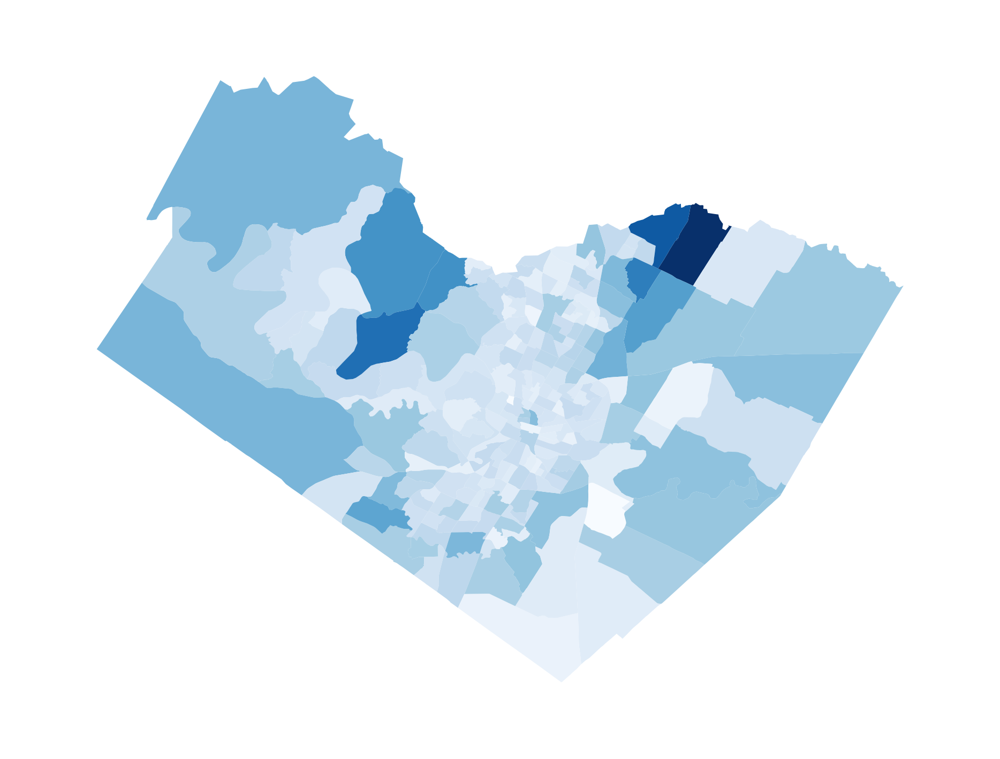

In [131]:
geoplot.choropleth(
    portions,
    hue='total population',
    edgecolor='none',
    cmap='Blues'
)

In [132]:
portions.columns = portions.columns.str.replace('total', 'percent')
portions.columns = portions.columns.str.replace('count', 'percent')

In [133]:
portions

,percent population,percent: White,percent: Black,percent: Asian,percent: Hispanic or Latino (any race),percent: income below poverty level,percent: paying >50 percent of income on rent,percent of individuals with warrant record,geometry
0,0.005336,0.006965,0.001952,0.000644,0.002876,0.001968,0.000785,0.001261,"POLYGON ((-98.03709 30.42049, -98.03706 30.421..."
1,0.003537,0.004522,0.001775,0.000717,0.000911,0.000536,0.002563,0.000339,"POLYGON ((-97.98135 30.36760, -97.98082 30.367..."
2,0.004089,0.004575,0.002099,0.006091,0.002375,0.001523,0.002315,0.000921,"POLYGON ((-97.86957 30.19587, -97.86929 30.196..."
3,0.004137,0.004805,0.000186,0.005835,0.003933,0.002309,0.007482,0.002764,"POLYGON ((-97.84230 30.19542, -97.84024 30.198..."
4,0.004896,0.005907,0.003658,0.001617,0.005476,0.003324,0.007626,0.004316,"POLYGON ((-97.82000 30.17389, -97.81865 30.176..."
...,...,...,...,...,...,...,...,...,...
213,0.004914,0.005176,0.003884,0.007574,0.002802,0.004382,0.008577,0.005577,"POLYGON ((-97.71249 30.30596, -97.71242 30.306..."
214,0.001812,0.000876,0.008347,0.000097,0.002693,0.002184,0.003203,0.005965,"POLYGON ((-97.67323 30.32572, -97.67293 30.325..."
215,0.001930,0.001323,0.006238,0.000486,0.001994,0.000250,0.000000,0.000388,"POLYGON ((-97.64923 30.19899, -97.64446 30.202..."
216,0.008102,0.004080,0.022431,0.000802,0.015819,0.006830,0.002645,0.014888,"POLYGON ((-97.65880 30.22676, -97.65862 30.227..."


In [144]:
import pandas_bokeh
import bokeh.plotting
pandas_bokeh.output_notebook()

Loading BokehJS ...

In [147]:
portions.plot_bokeh(
    figsize=(900, 600),
    dropdown=[
        'percent population',
        'percent: White',
        'percent: Hispanic or Latino (any race)',
        'percent of individuals with warrant record'
        ],
    colormap='PuBu',
    hovertool_columns = [
        'percent: White',
        'percent: Hispanic or Latino (any race)'
        ]
    )
hover_tool.formatters = { "@{percent: White}": "%0.2f"}

NameError: name 'hover_tool' is not defined

In [148]:
from bokeh.io import output_file, show
from bokeh.layouts import gridplot
from bokeh.plotting import figure

In [154]:
portions.plot_bokeh(
    figsize=(300, 300),
    colormap='PuBu',
    category='percent: White',
    hovertool_columns=['percent: White'],
    title='Percent White'
    )

Figure(id='2967', ...)

In [158]:
TOOLS = "box_select,lasso_select,help"

# create a new plot and add a renderer
left = portions.plot_bokeh(
    figsize=(300, 300),
    colormap='PuBu',
    category='percent: White',
    hovertool_columns=['percent: White'],
    title='Percent White'
    )

# create another new plot and add a renderer
right = portions.plot_bokeh(
    figsize=(300, 300),
    colormap='PuOr',
    category='percent: Hispanic or Latino (any race)',
    hovertool_columns=['percent: Hispanic or Latino (any race)'],
    title='Percent : Hispanic or Latino (any race)'
    )

p = gridplot([[left, right]])

show(p)

In [161]:
from bokeh.models import GeoJSONDataSource

In [174]:
portions

,percent population,percent: White,percent: Black,percent: Asian,percent: Hispanic or Latino (any race),percent: income below poverty level,percent: paying >50 percent of income on rent,percent of individuals with warrant record,geometry
0,0.005336,0.006965,0.001952,0.000644,0.002876,0.001968,0.000785,0.001261,"POLYGON ((-98.03709 30.42049, -98.03706 30.421..."
1,0.003537,0.004522,0.001775,0.000717,0.000911,0.000536,0.002563,0.000339,"POLYGON ((-97.98135 30.36760, -97.98082 30.367..."
2,0.004089,0.004575,0.002099,0.006091,0.002375,0.001523,0.002315,0.000921,"POLYGON ((-97.86957 30.19587, -97.86929 30.196..."
3,0.004137,0.004805,0.000186,0.005835,0.003933,0.002309,0.007482,0.002764,"POLYGON ((-97.84230 30.19542, -97.84024 30.198..."
4,0.004896,0.005907,0.003658,0.001617,0.005476,0.003324,0.007626,0.004316,"POLYGON ((-97.82000 30.17389, -97.81865 30.176..."
...,...,...,...,...,...,...,...,...,...
213,0.004914,0.005176,0.003884,0.007574,0.002802,0.004382,0.008577,0.005577,"POLYGON ((-97.71249 30.30596, -97.71242 30.306..."
214,0.001812,0.000876,0.008347,0.000097,0.002693,0.002184,0.003203,0.005965,"POLYGON ((-97.67323 30.32572, -97.67293 30.325..."
215,0.001930,0.001323,0.006238,0.000486,0.001994,0.000250,0.000000,0.000388,"POLYGON ((-97.64923 30.19899, -97.64446 30.202..."
216,0.008102,0.004080,0.022431,0.000802,0.015819,0.006830,0.002645,0.014888,"POLYGON ((-97.65880 30.22676, -97.65862 30.227..."


In [179]:
import geoviews as gv
import geoviews.feature as gf

TypeError: '<' not supported between instances of 'Version' and 'str'

In [163]:
gv.Polygons(
    gpd.read_file(gpd.datasets.get_path('naturalearth_lowres')), vdims=['pop_est', ('name', 'Country')]).opts(
    tools=['hover'], width=600, projection=crs.Robinson()
)

ValueError: failed to validate MultiPolygons(id='5394', ...).xs: expected an element of either String, Dict(Enum('expr', 'field', 'value', 'transform'), Either(String, Instance(Transform), Instance(Expression), Float)) or Float, got GeoJSONDataSource(id='5359', ...)

In [ ]:
source = GeoJSONDataSource(portions.to_json())

# create a column data source for the plots to share
source = ColumnDataSource(data=dict(x=x, y0=y0, y1=y1))

TOOLS = "box_select,lasso_select,help"

# create a new plot and add a renderer
left = figure(tools=TOOLS, width=300, height=300, title=None)
left.circle('x', 'y0', source=source)

# create another new plot and add a renderer
right = figure(tools=TOOLS, width=300, height=300, title=None)
right.circle('x', 'y1', source=source)

p = gridplot([[left, right]])

show(p)

In [ ]:
source = GeoJSONDataSource(portions.to_json())

# create a column data source for the plots to share
source = ColumnDataSource(data=dict(x=x, y0=y0, y1=y1))

TOOLS = "box_select,lasso_select,help"

# create a new plot and add a renderer
left = figure(tools=TOOLS, width=300, height=300, title=None)
left.circle('x', 'y0', source=source)

# create another new plot and add a renderer
right = figure(tools=TOOLS, width=300, height=300, title=None)
right.circle('x', 'y1', source=source)

p = gridplot([[left, right]])

show(p)

<AxesSubplot:>

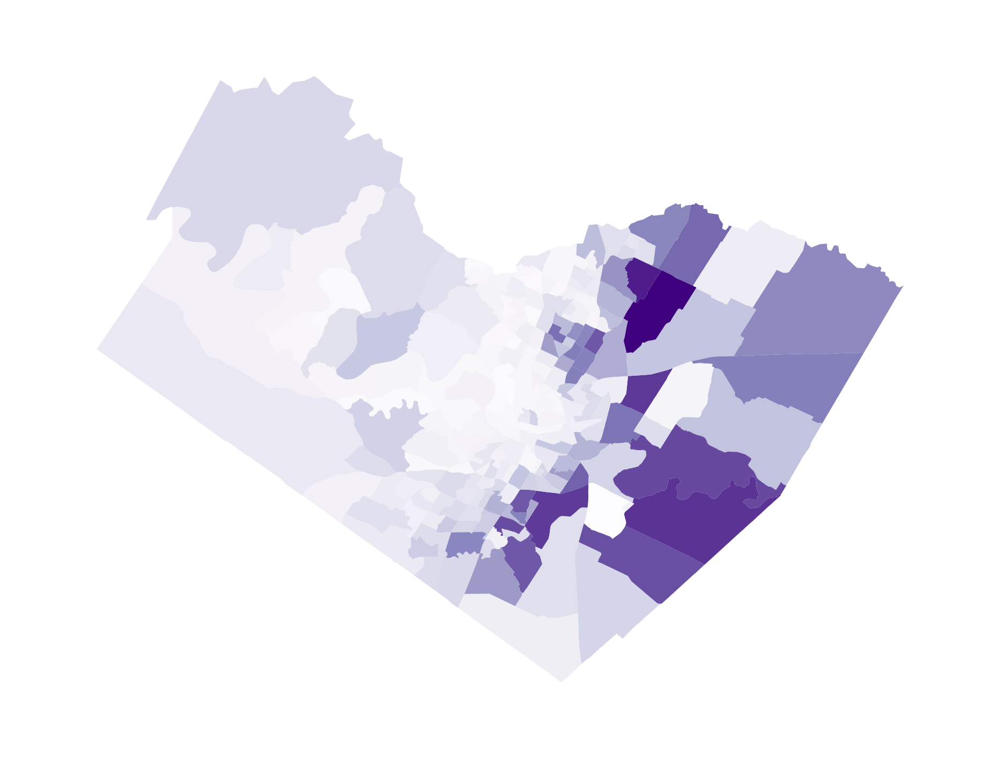

In [40]:
geoplot.choropleth(
    portions,
    hue='total: Hispanic or Latino (any race)',
    edgecolor='none',
    cmap='Purples'
)

<AxesSubplot:>

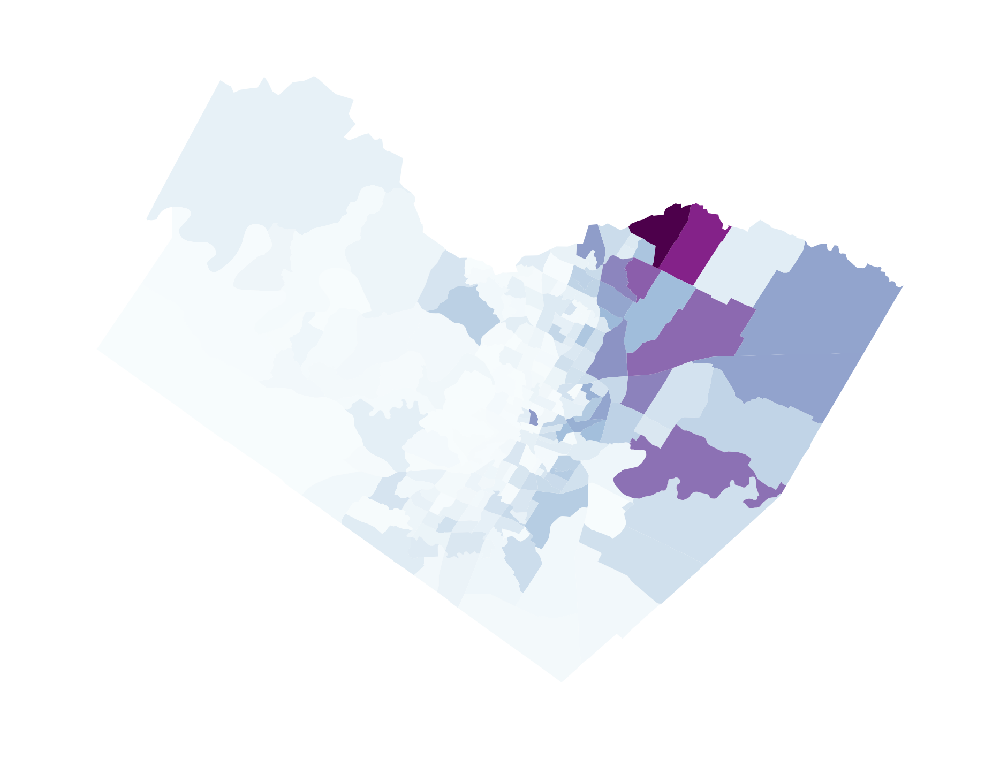

In [41]:
geoplot.choropleth(
    portions,
    hue='total: Black',
    edgecolor='none',
    cmap='BuPu'
)

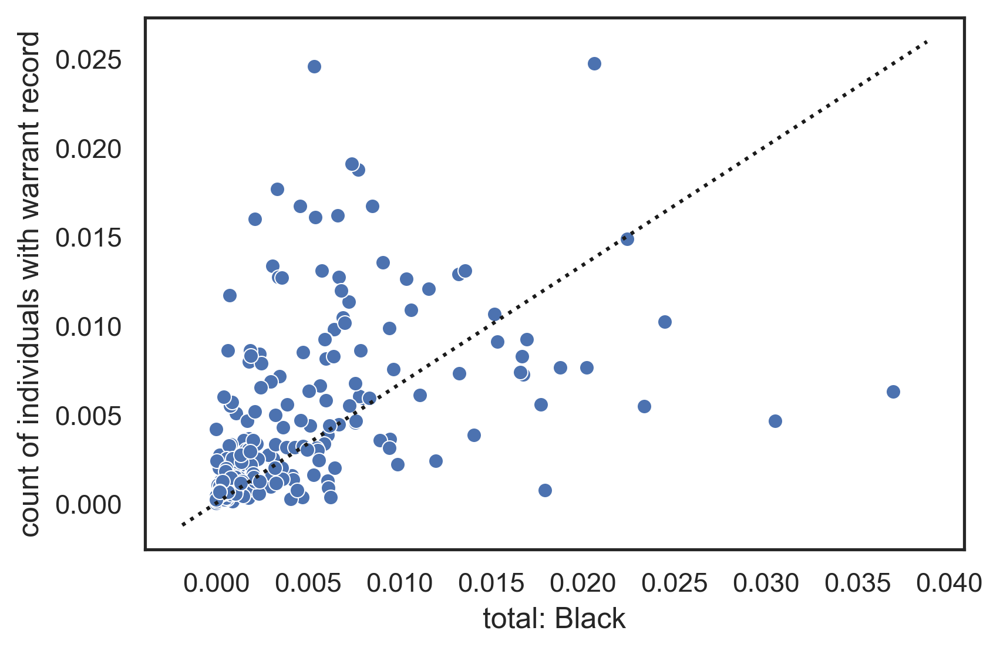

In [42]:
ax = sns.scatterplot(
    data=portions,
    x='total: Black',
    y='count of individuals with warrant record'
)

ax.plot(ax.get_xlim(), ax. get_ylim(), ls=":", c='k')
    

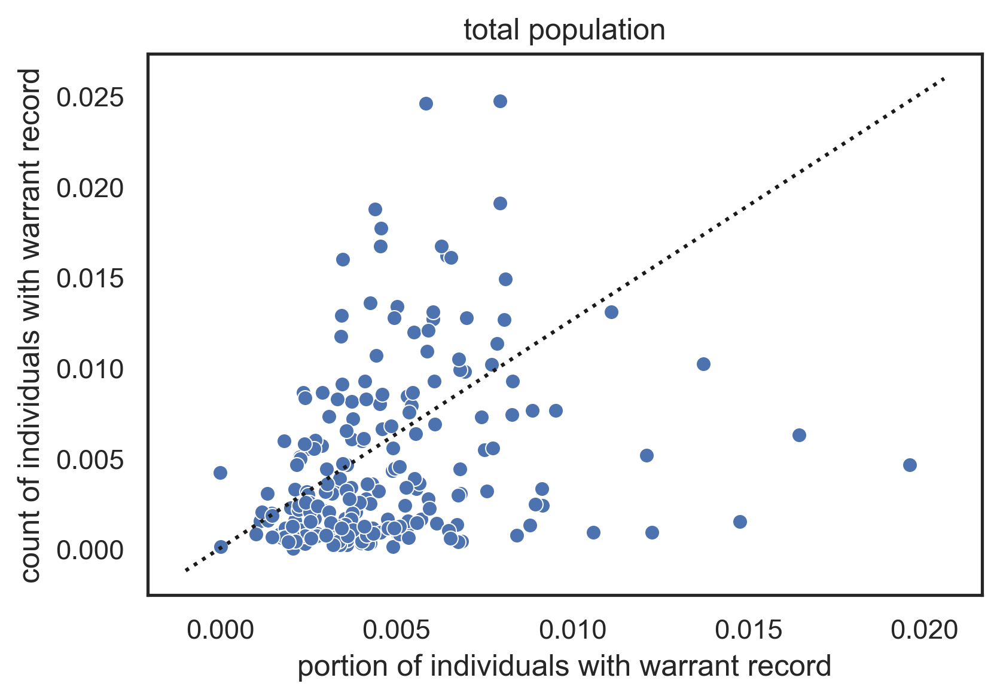

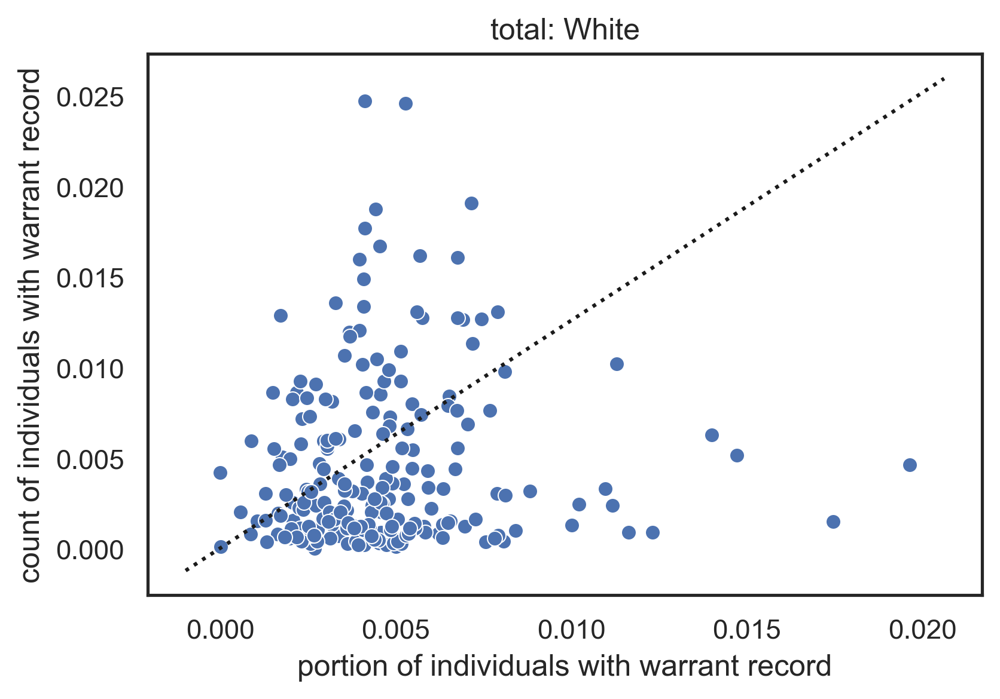

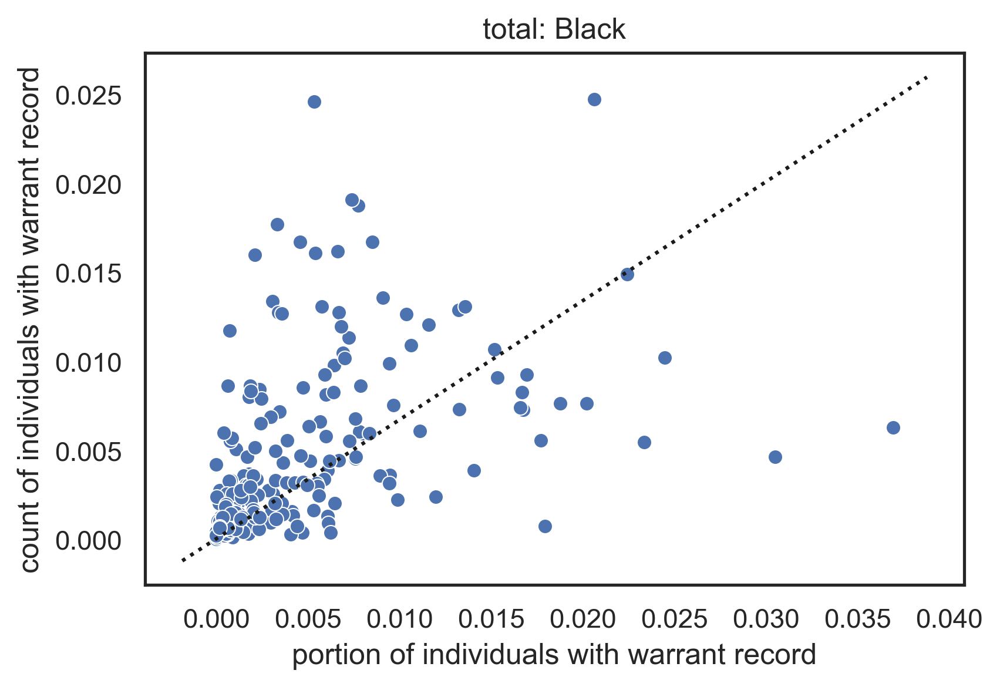

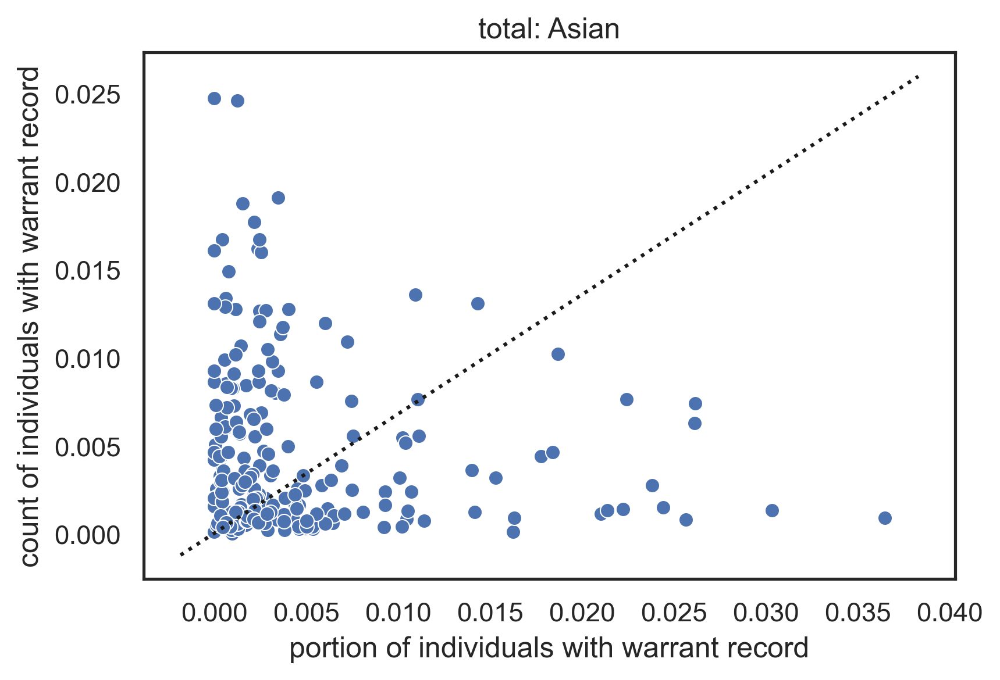

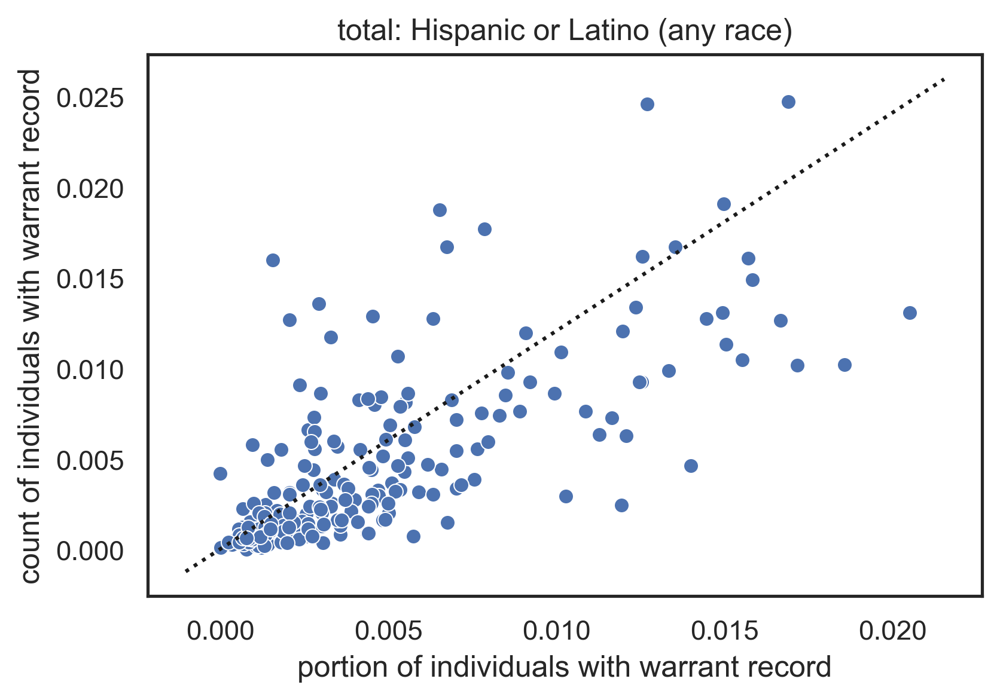

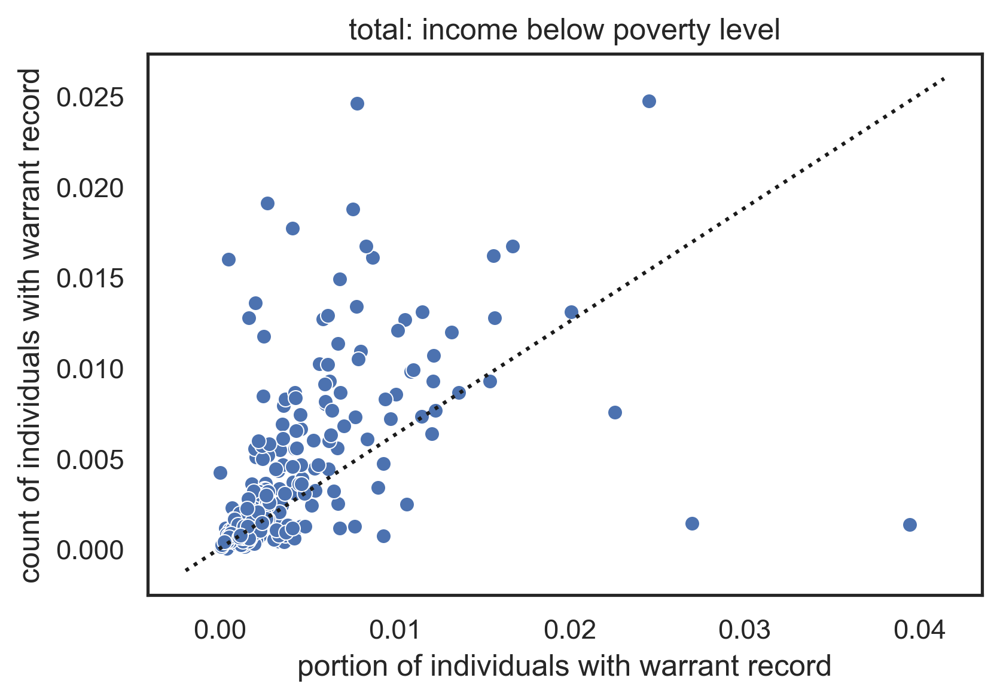

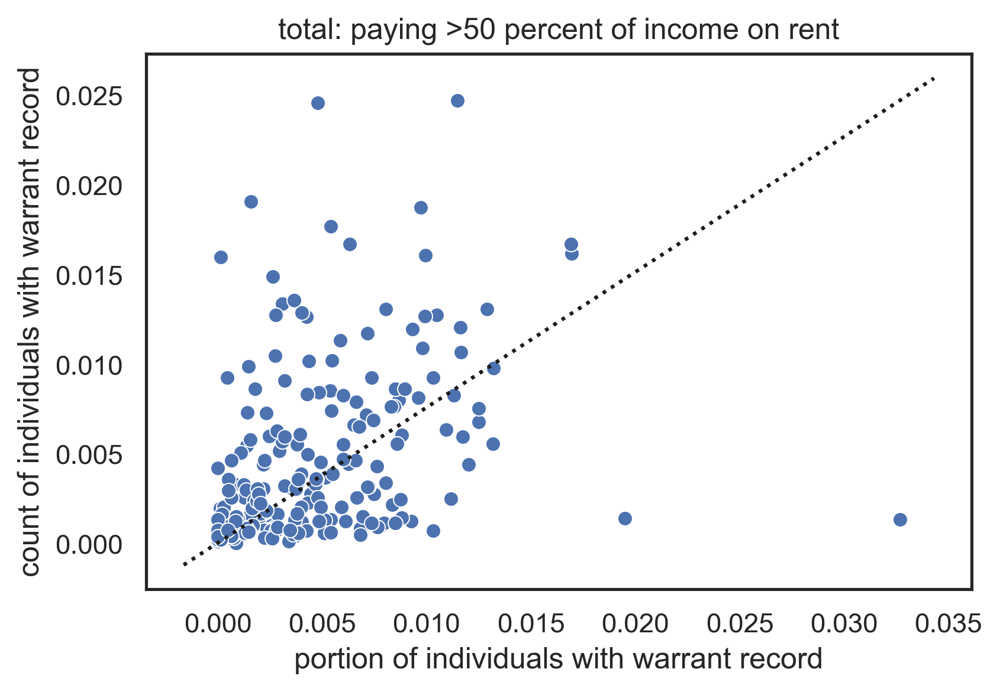

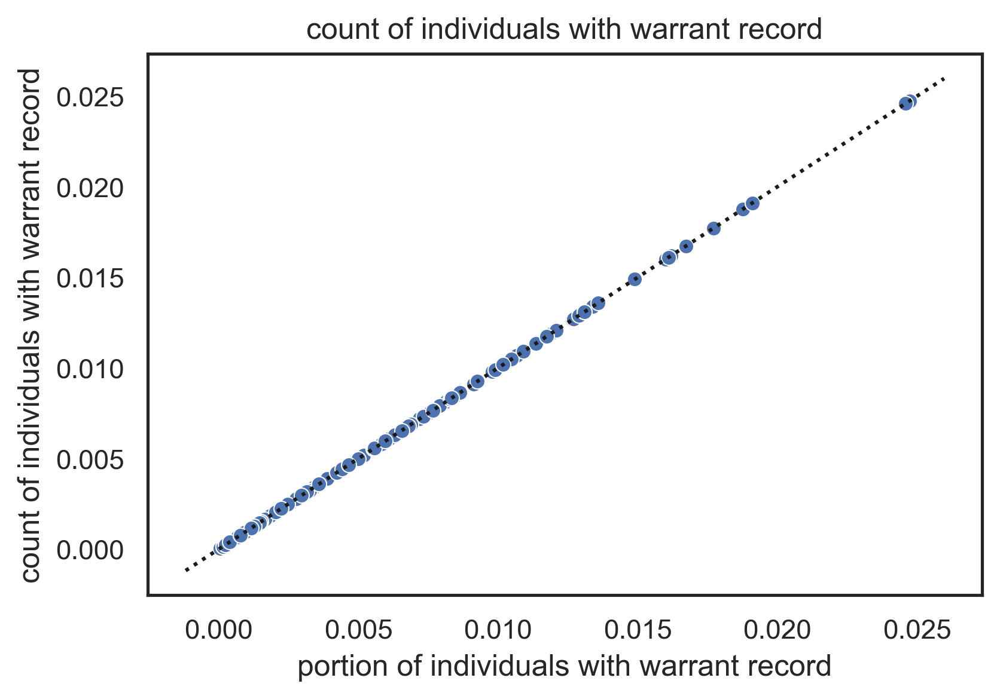

In [43]:
for col in portion_cols:
    ax = sns.scatterplot(
        data=portions,
        x=col,
        y='count of individuals with warrant record'
    )

    ax.plot(ax.get_xlim(), ax. get_ylim(), ls=":", c='k')
    ax.set_title(col)
    ax.set_xlabel('portion of individuals with warrant record')
    ax.set_title(col)
    
    plt.show()

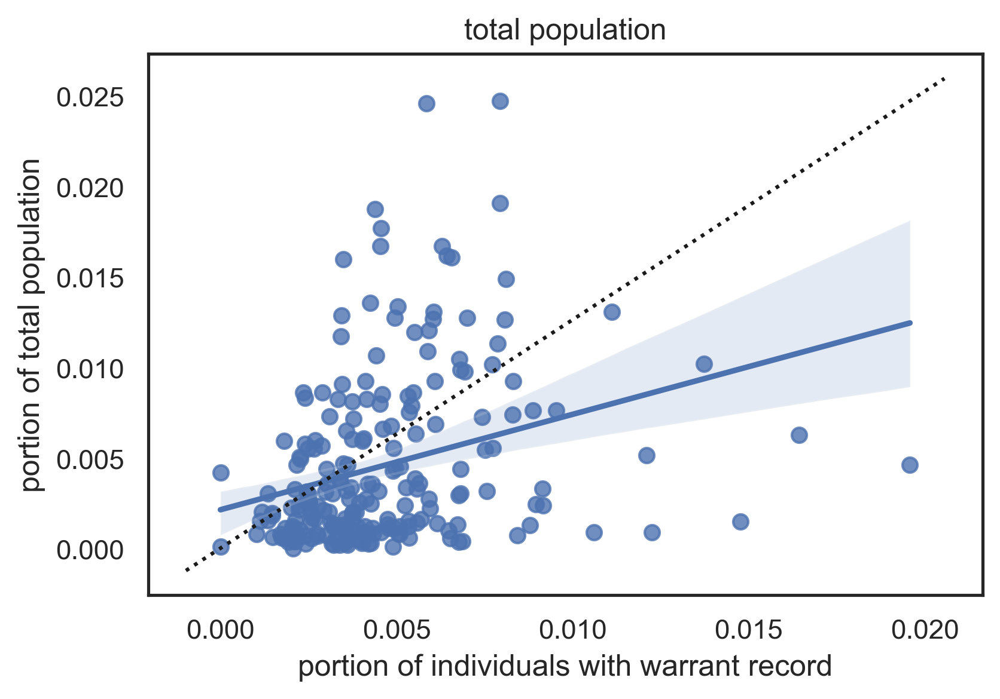

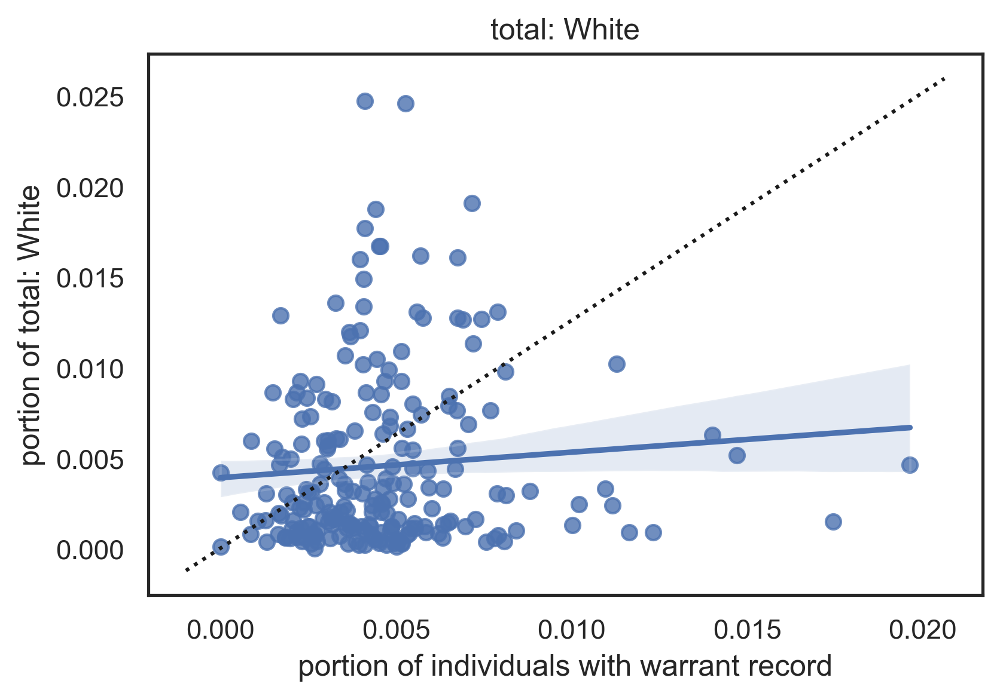

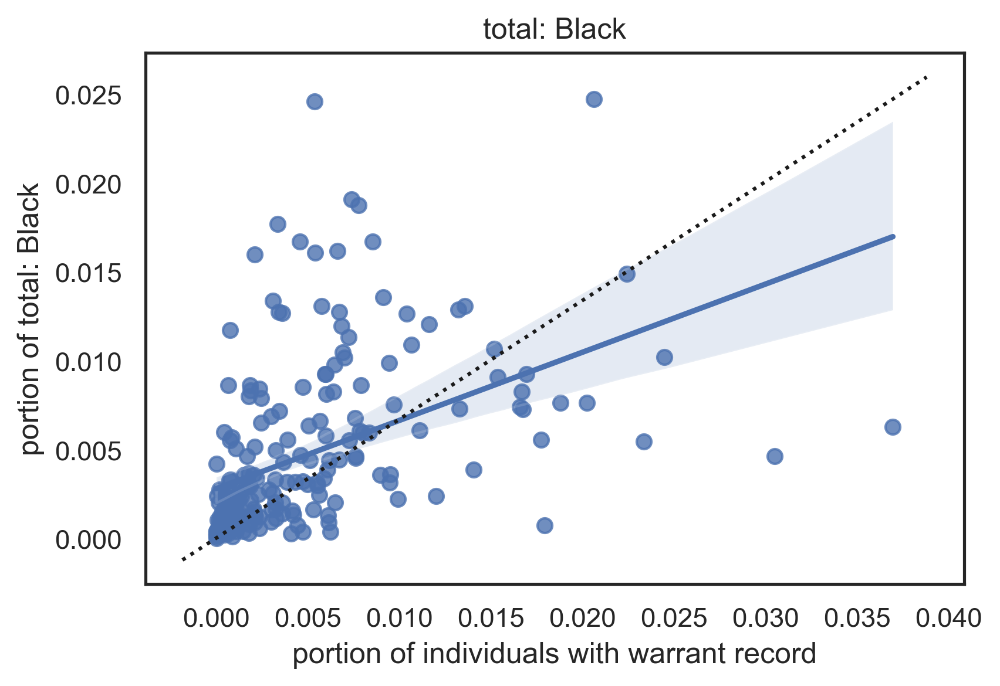

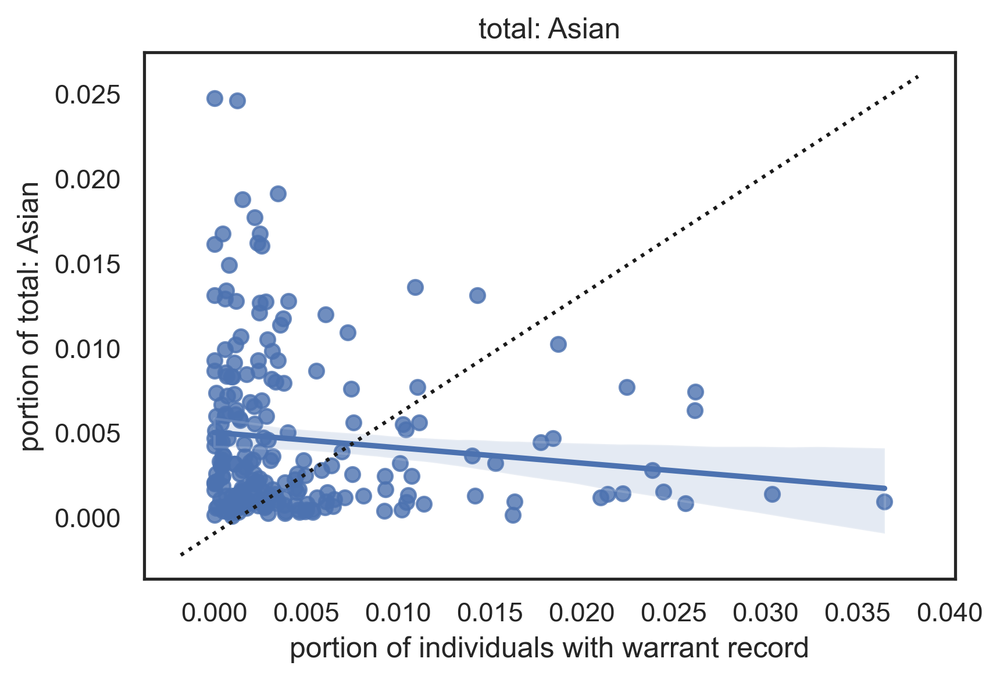

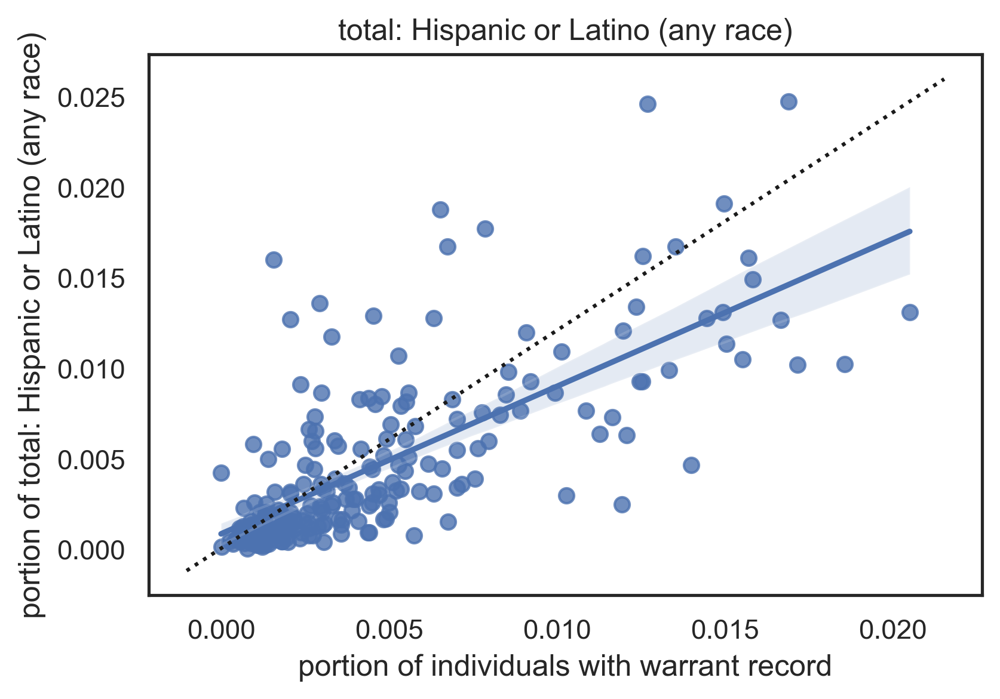

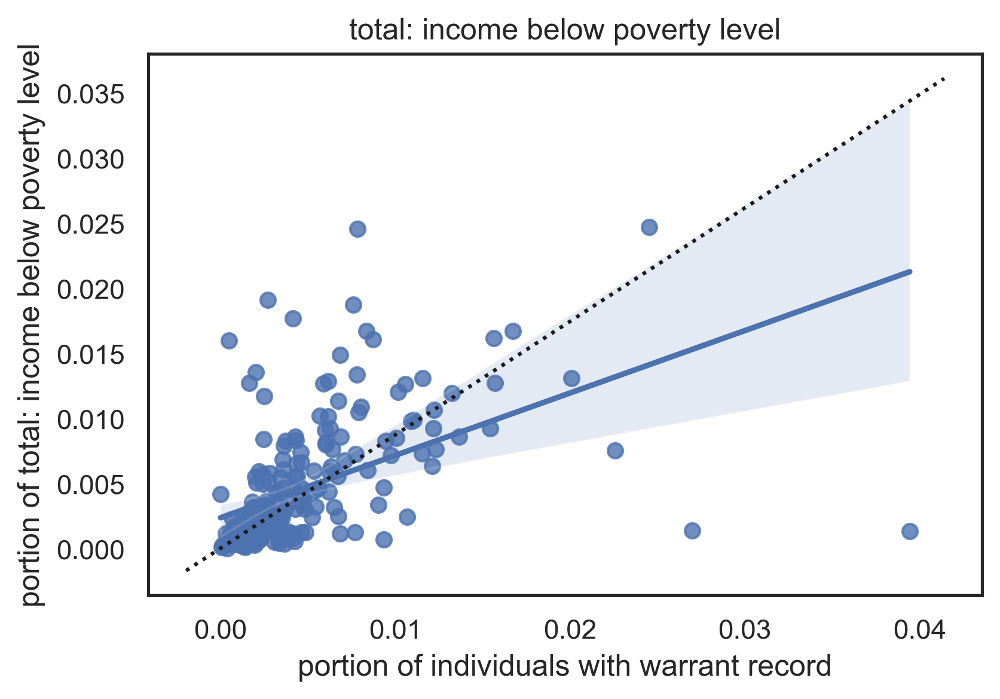

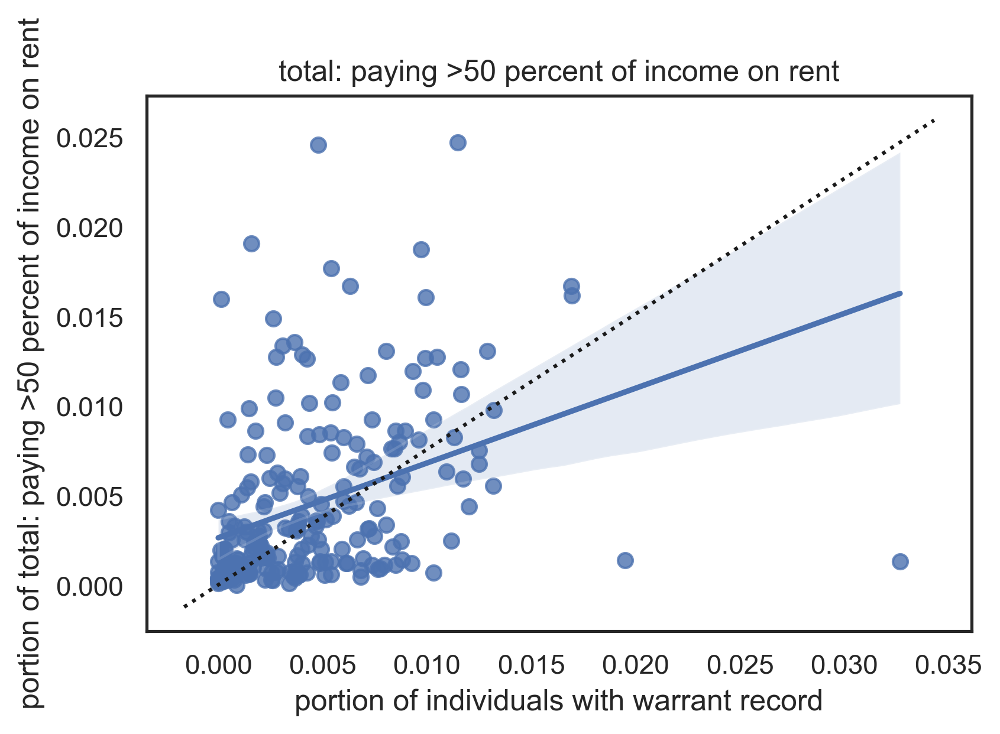

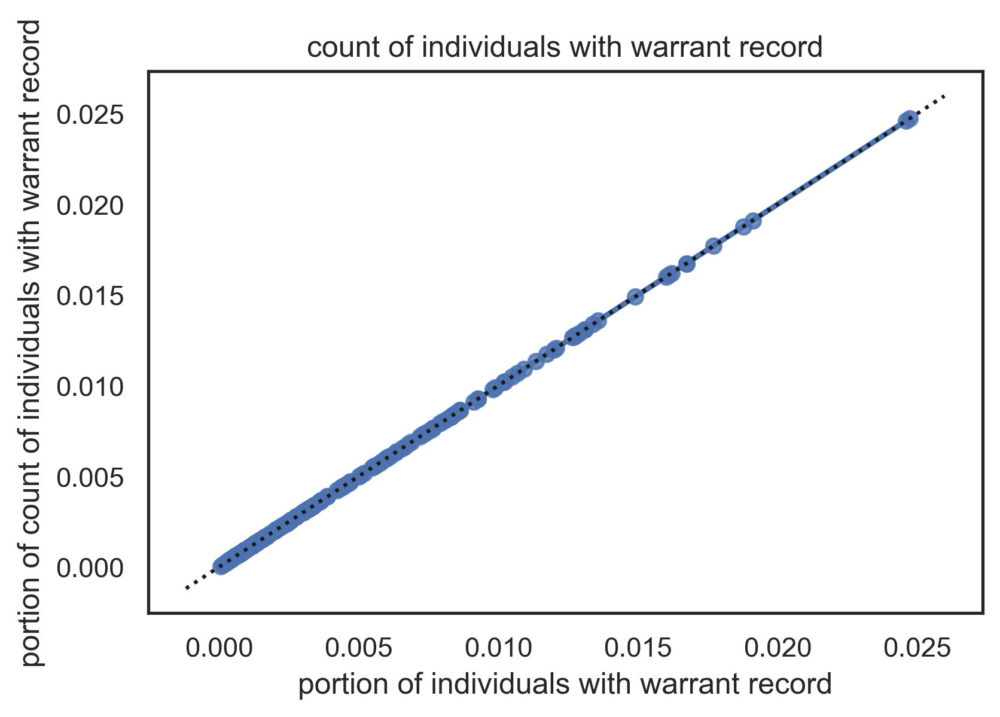

In [44]:
for col in portion_cols:
    ax = sns.regplot(
        data=portions.sort_values(by=col),
        x=col,
        y='count of individuals with warrant record'
    )

    ax.plot(ax.get_xlim(), ax. get_ylim(), ls=":", c='k')
    ax.set_ylabel('portion of '+col)
    ax.set_xlabel('portion of individuals with warrant record')
    ax.set_title(col)
    
    plt.show()

In [45]:
plot_X_cols=['total population',
           'total: White', 
           'total: Black', 
           'total: Asian',
           'total: Hispanic or Latino (any race)',
           'total: income below poverty level', 
           'median gross rent',
           'total: paying >50 percent of income on rent' 
            ]

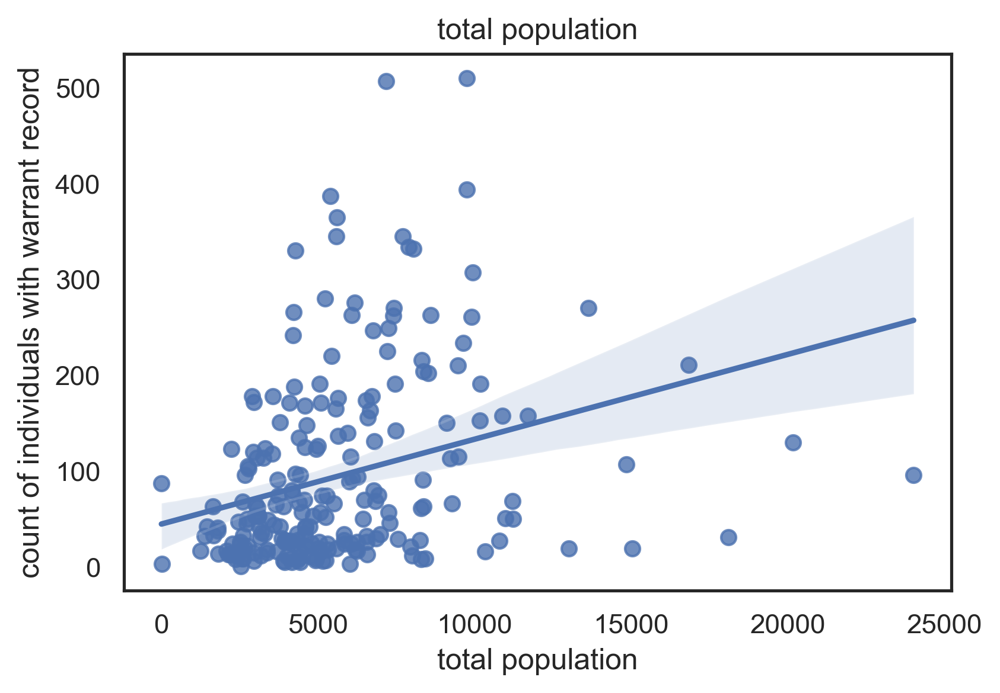

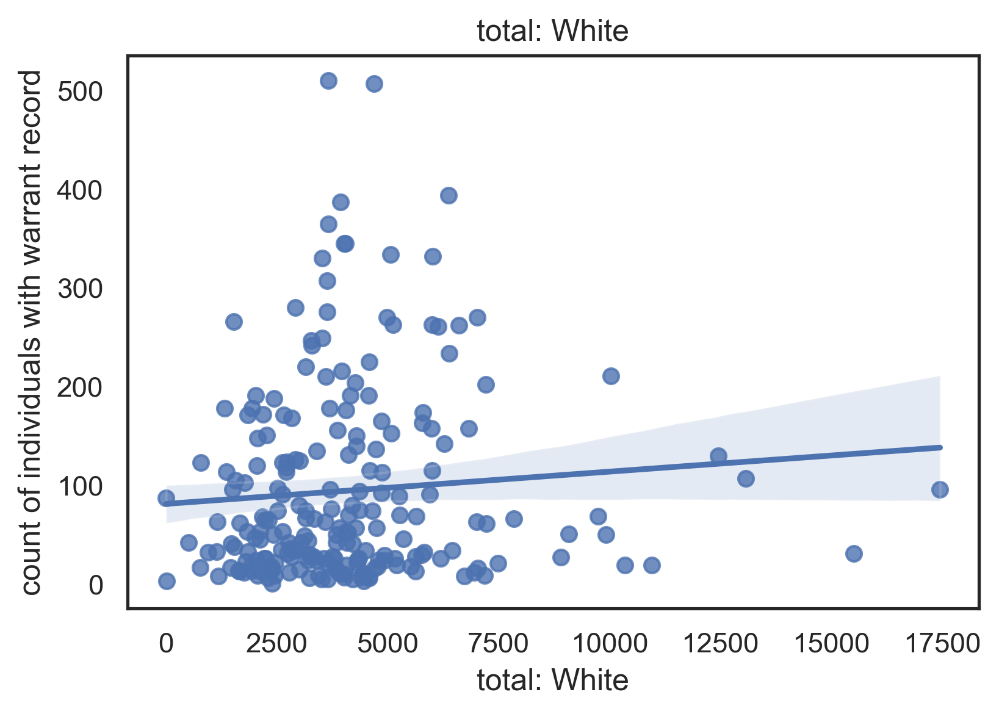

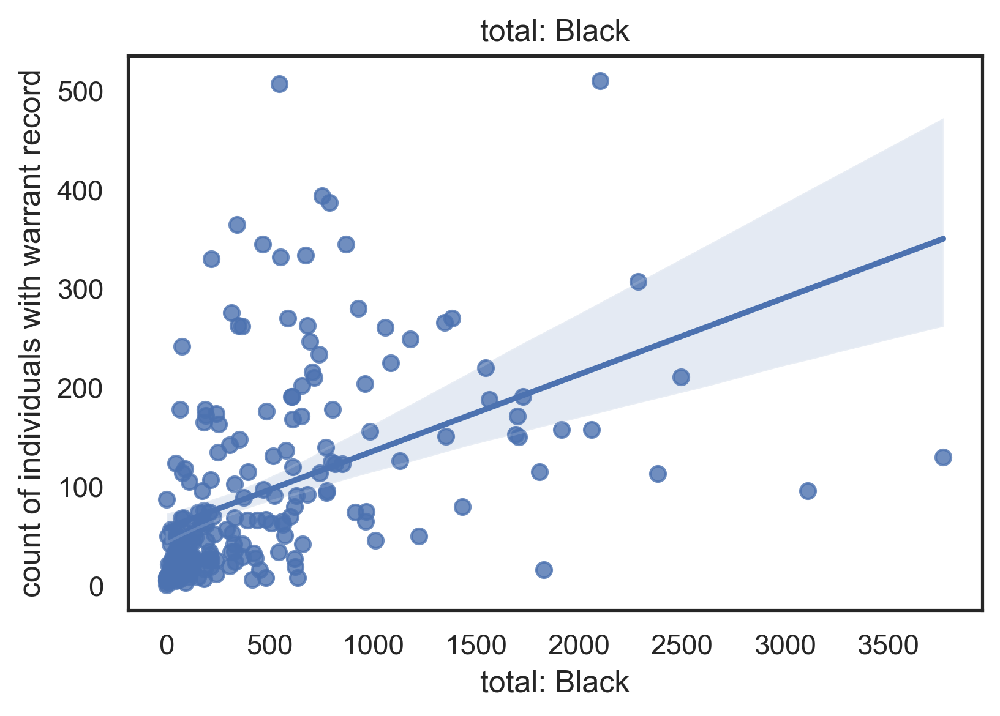

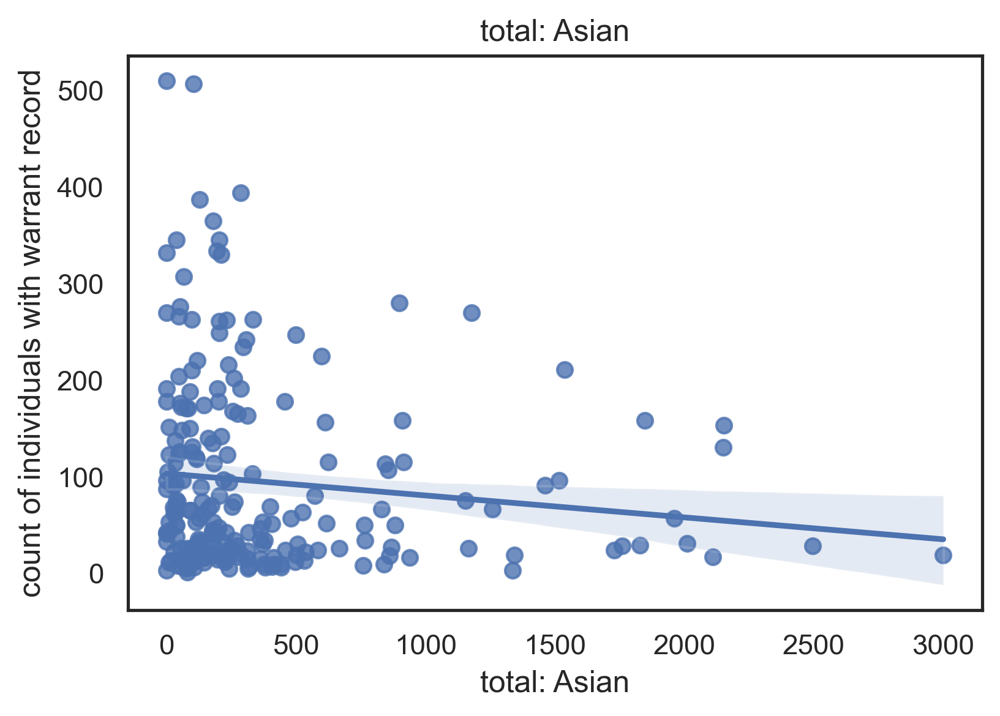

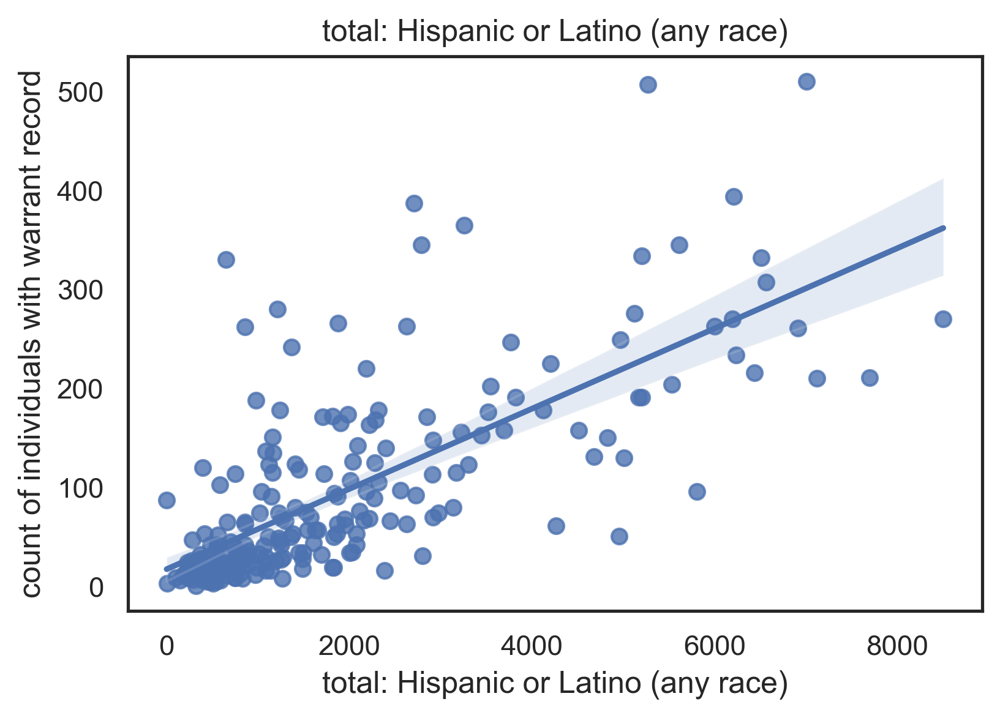

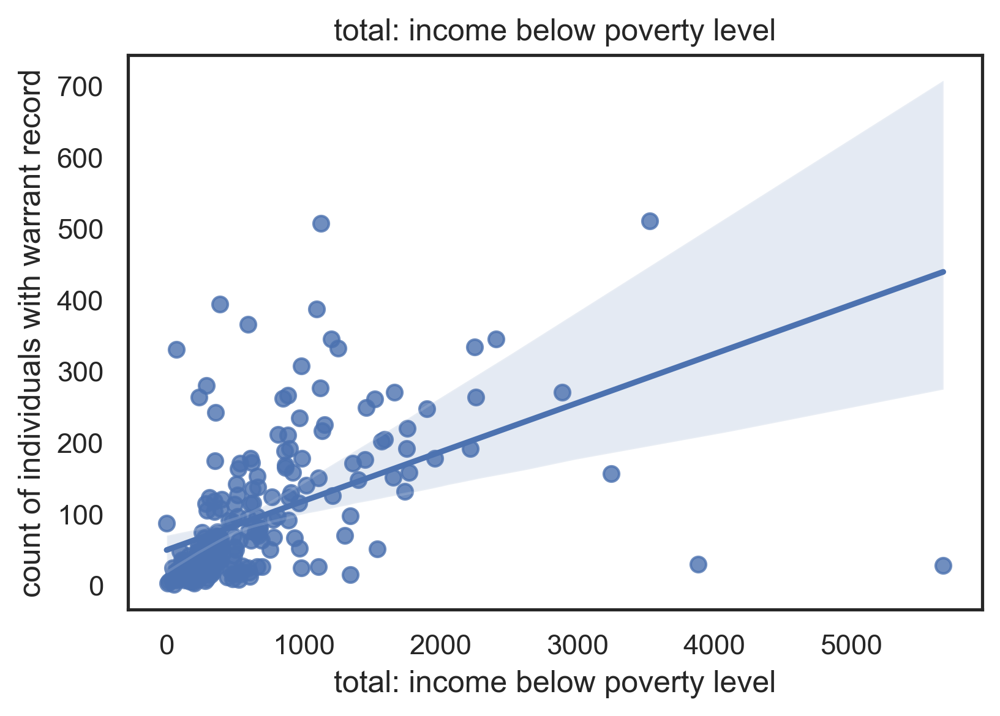

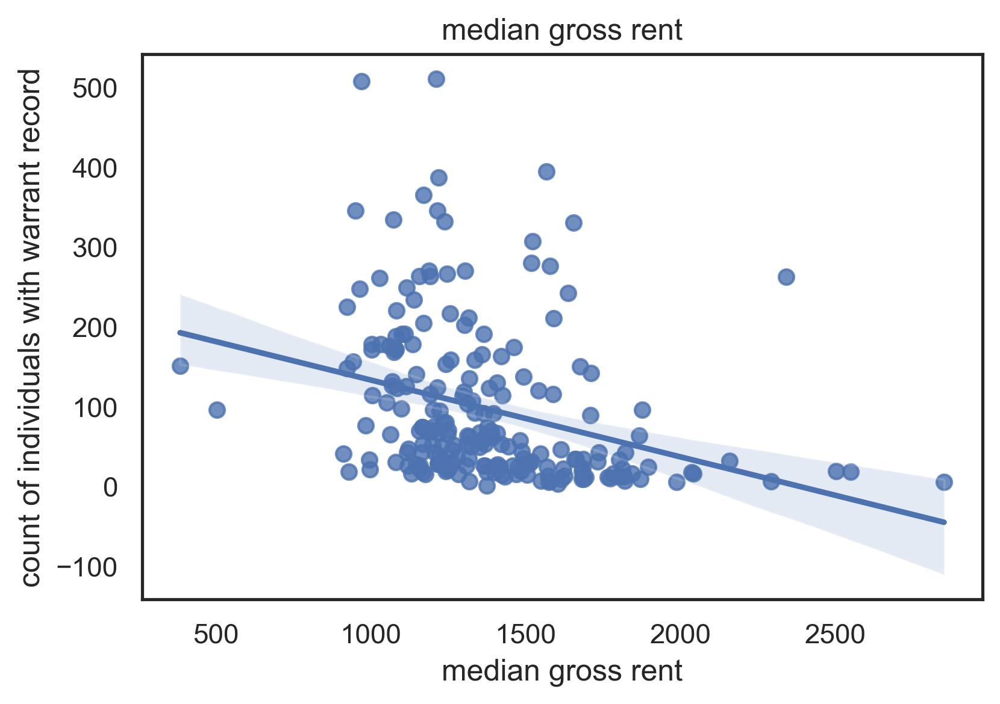

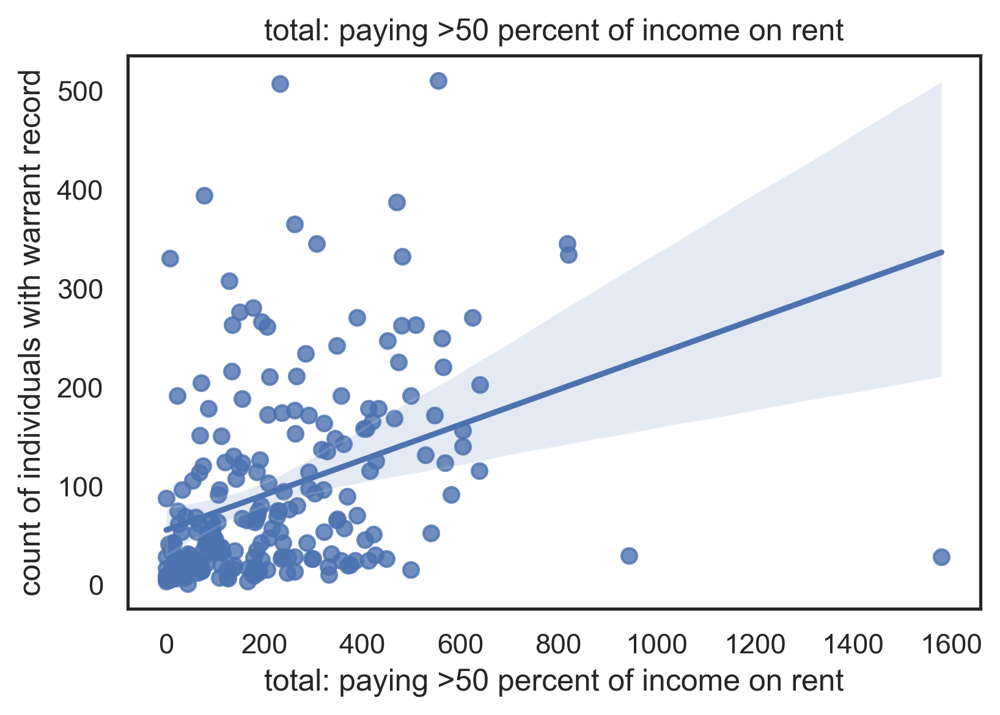

In [46]:
for col in plot_X_cols:
    ax = sns.regplot(
        data=tract_features,
        x=col,
        y='count of individuals with warrant record'
    )

    #ax.plot(ax.get_xlim(), ax. get_ylim(), ls=":", c='k')
    ax.set_title(col)
    
    plt.show()

In [47]:
total_by_tract = ids.groupby('GEOID')['Balance Due'].sum().rename('total tract balance').reset_index()

In [48]:
tract_features = tract_features.merge(total_by_tract, on='GEOID')

<AxesSubplot:>

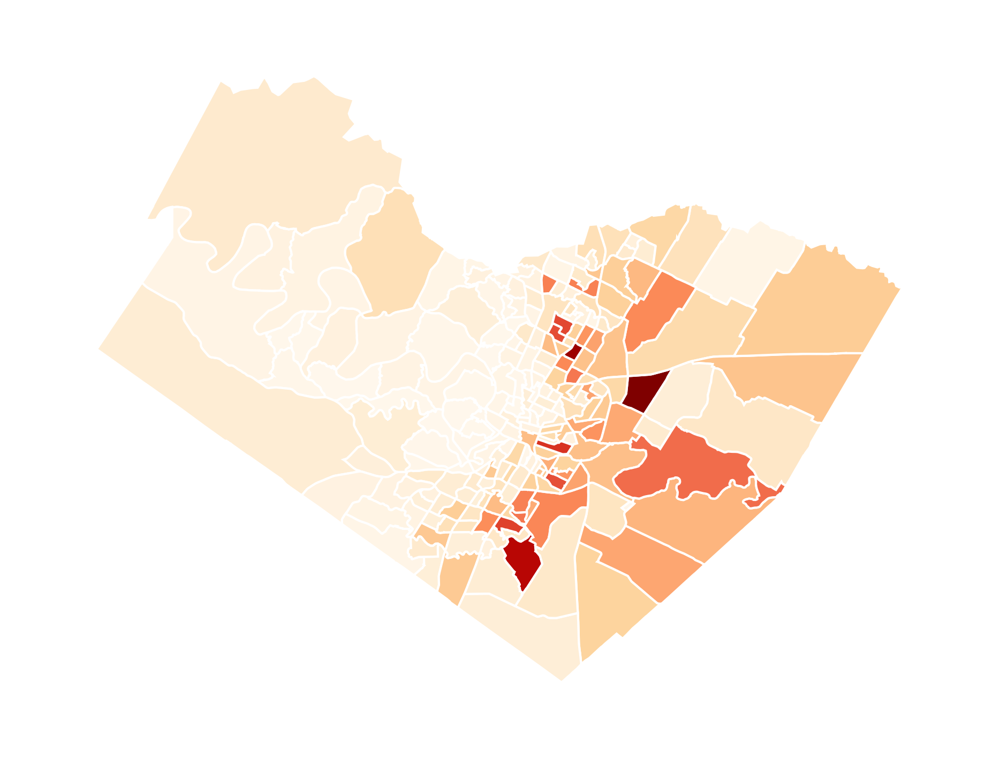

In [49]:
geoplot.choropleth(
    tract_features,
    hue='total tract balance',
    cmap='OrRd'
)

<AxesSubplot:xlabel='total: income below poverty level', ylabel='total tract balance'>

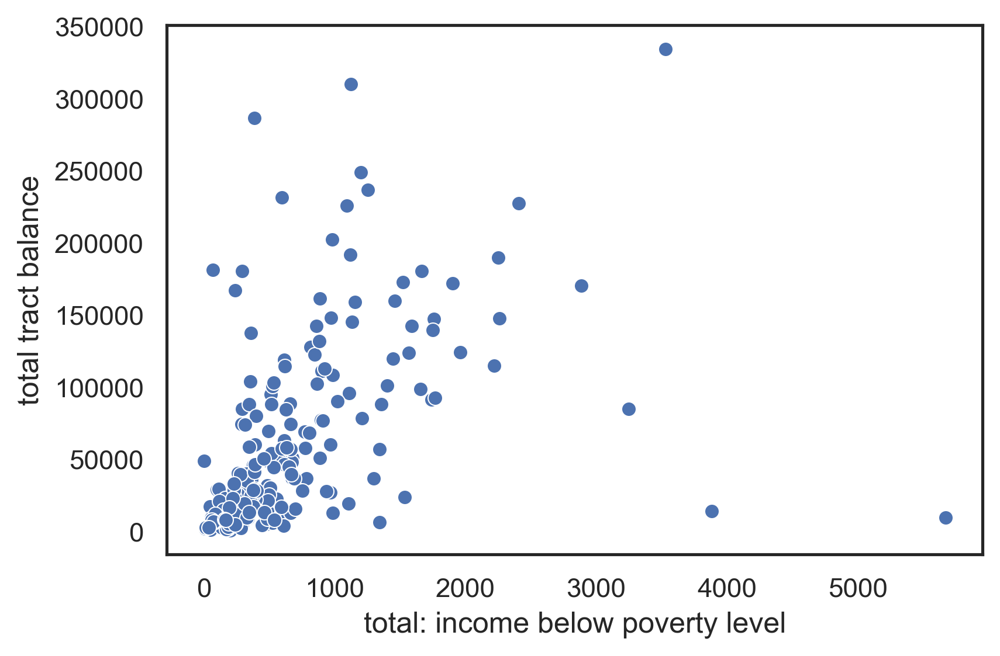

In [50]:
sns.scatterplot(
    data=tract_features,
    x='total: income below poverty level',
    y='total tract balance'
)

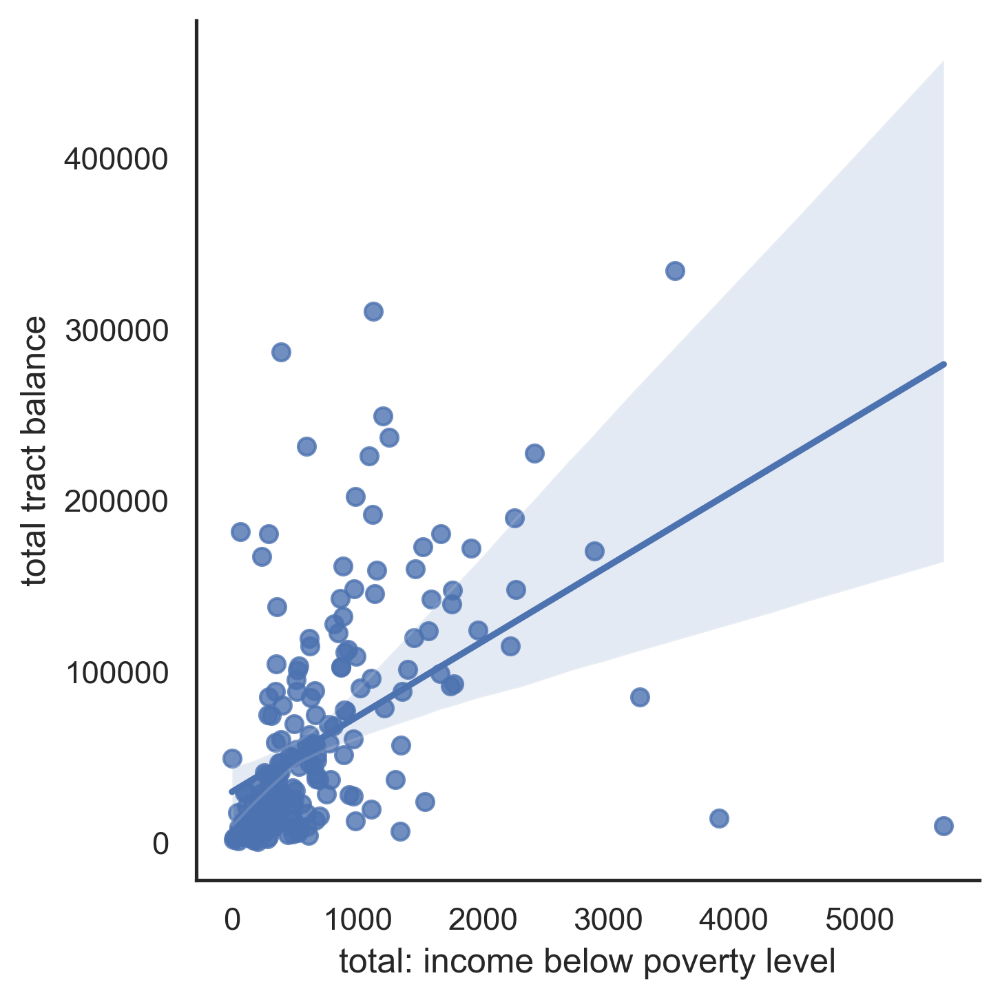

In [51]:
sns.lmplot(
    data=tract_features,
    x='total: income below poverty level',
    y='total tract balance'
)

In [52]:
tract_features.columns

Index(['GEOID', 'total population', '[denominator: total population for Race]',
       'total: White', 'total: Black', 'total: Asian',
       '[denominator: total population for Hispanic or Latino]',
       'total: Hispanic or Latino (any race)',
       '[denominator: total population for poverty]',
       'total: income below poverty level', 'median gross rent',
       '[denominator: total population for income on rent]',
       'total: paying >50 percent of income on rent', 'NAME', 'state',
       'county', 'tract', 'count of individuals with warrant record',
       'warrant prevalence', 'geometry', 'total tract balance'],
      dtype='object')

In [53]:
tract_features['percent poverty'] = tract_features['total: income below poverty level']/tract_features['[denominator: total population for poverty]']

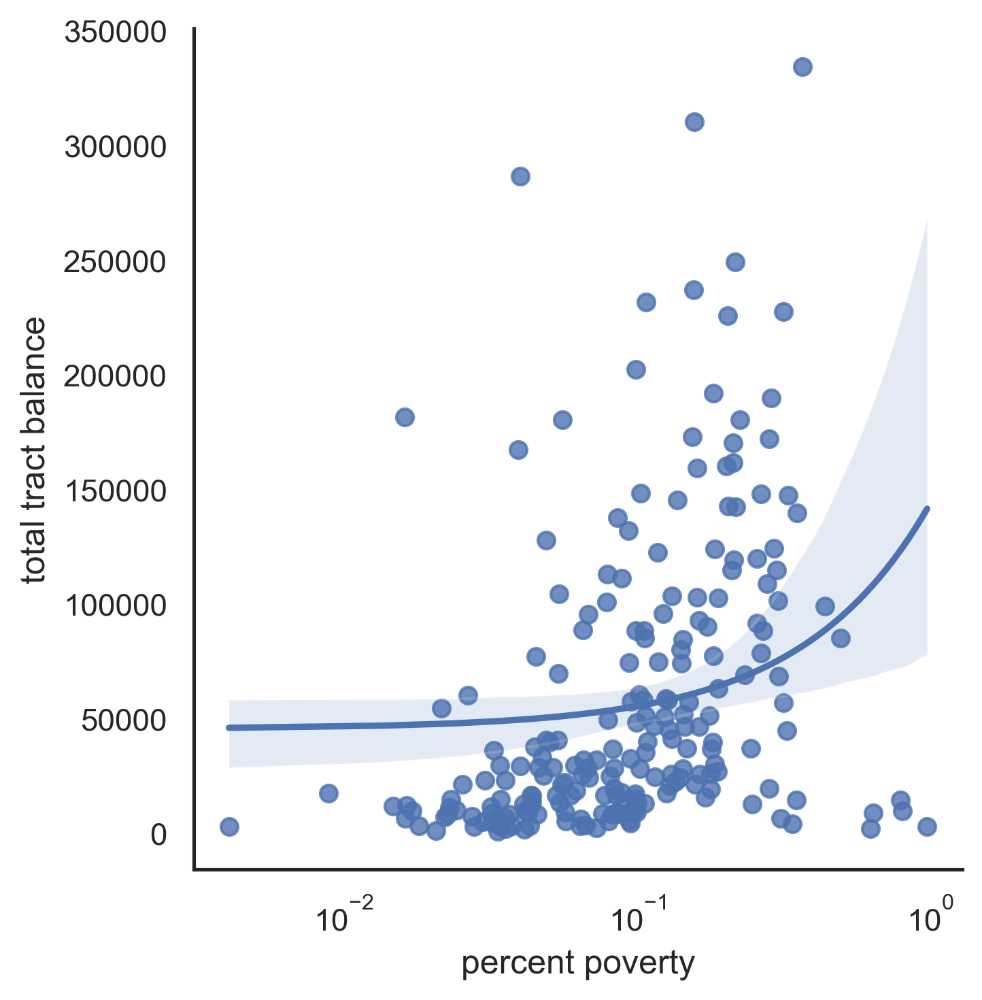

In [54]:
sns.lmplot(
    data=tract_features,
    x='percent poverty',
    y='total tract balance'
)

plt.xscale('log')

#### get total balance

In [55]:
total_balance = ids.groupby(['GEOID','ID'])['Balance Due'].sum().reset_index()

In [56]:
total_balance

,GEOID,ID,Balance Due
0,48453000101,371102,1016.5
1,48453000101,481821,234.0
2,48453000101,1369346,382.2
3,48453000101,1773579,378.3
4,48453000101,2209463,514.8
...,...,...,...
16815,48453980000,2275216,807.3
16816,48453980000,2287636,1012.6
16817,48453980000,2294319,662.3
16818,48453980000,2299321,1290.1


<AxesSubplot:xlabel='GEOID', ylabel='Balance Due'>

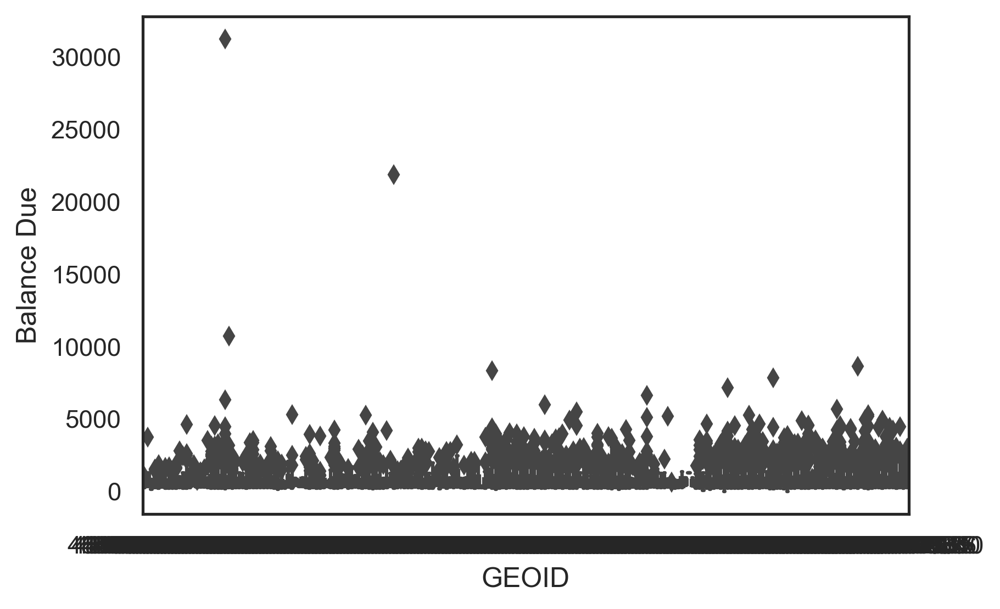

In [57]:
sns.boxplot(
    data=total_balance,
    x='GEOID',
    y='Balance Due',
)

In [58]:
tract_features = tract_features.set_index('GEOID')

In [59]:
tract_features['mean balance'] = total_balance.groupby('GEOID')['Balance Due'].mean()

<AxesSubplot:>

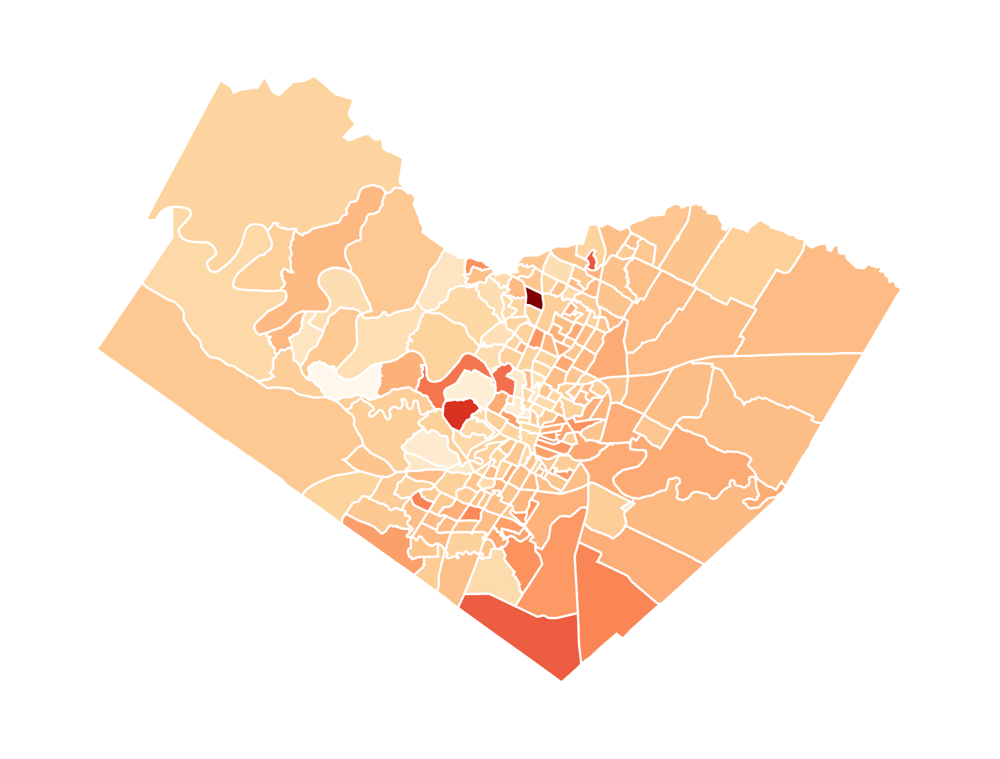

In [60]:
geoplot.choropleth(
    tract_features,
    hue='mean balance',
    cmap='OrRd'

)

In [61]:
total_balance

,GEOID,ID,Balance Due
0,48453000101,371102,1016.5
1,48453000101,481821,234.0
2,48453000101,1369346,382.2
3,48453000101,1773579,378.3
4,48453000101,2209463,514.8
...,...,...,...
16815,48453980000,2275216,807.3
16816,48453980000,2287636,1012.6
16817,48453980000,2294319,662.3
16818,48453980000,2299321,1290.1


In [62]:
tract_features

,total population,[denominator: total population for Race],total: White,total: Black,total: Asian,[denominator: total population for Hispanic or Latino],total: Hispanic or Latino (any race),[denominator: total population for poverty],total: income below poverty level,median gross rent,...,NAME,state,county,tract,count of individuals with warrant record,warrant prevalence,geometry,total tract balance,percent poverty,mean balance
GEOID,,,,,,,,,,,,,,,,,,,,,
48453001779,6546.0,6546.0,6192.0,199.0,53.0,6546.0,1193.0,6462.0,283.0,1366.0,...,"Census Tract 17.79, Travis County, Texas",48,453,001779,26,0.003972,"POLYGON ((-98.03709 30.42049, -98.03706 30.421...",16242.70,0.043794,649.708000
48453001778,4339.0,4339.0,4020.0,181.0,59.0,4339.0,378.0,4263.0,77.0,1580.0,...,"Census Tract 17.78, Travis County, Texas",48,453,001778,7,0.001613,"POLYGON ((-97.98135 30.36760, -97.98082 30.367...",3365.19,0.018062,480.741429
48453001740,5017.0,5017.0,4067.0,214.0,501.0,5017.0,985.0,5017.0,219.0,1682.0,...,"Census Tract 17.40, Travis County, Texas",48,453,001740,19,0.003787,"POLYGON ((-97.86957 30.19587, -97.86929 30.196...",13721.70,0.043652,762.316667
48453001729,5075.0,5075.0,4272.0,19.0,480.0,5075.0,1631.0,5075.0,332.0,1362.0,...,"Census Tract 17.29, Travis County, Texas",48,453,001729,57,0.011232,"POLYGON ((-97.84230 30.19542, -97.84024 30.198...",31929.28,0.065419,679.346383
48453002423,6007.0,6007.0,5252.0,373.0,133.0,6007.0,2271.0,6007.0,478.0,1710.0,...,"Census Tract 24.23, Travis County, Texas",48,453,002423,89,0.014816,"POLYGON ((-97.82000 30.17389, -97.81865 30.176...",49591.60,0.079574,751.387879
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48453000306,6029.0,6029.0,4602.0,396.0,623.0,6029.0,1162.0,6000.0,630.0,1588.0,...,"Census Tract 3.06, Travis County, Texas",48,453,000306,115,0.019074,"POLYGON ((-97.71249 30.30596, -97.71242 30.306...",58225.82,0.105000,639.844176
48453002201,2223.0,2223.0,779.0,851.0,8.0,2223.0,1117.0,2223.0,314.0,1383.0,...,"Census Tract 22.01, Travis County, Texas",48,453,002201,123,0.055331,"POLYGON ((-97.67323 30.32572, -97.67293 30.325...",74215.03,0.141251,734.802277
48453002319,2368.0,2368.0,1176.0,636.0,40.0,2368.0,827.0,37.0,36.0,NaN,...,"Census Tract 23.19, Travis County, Texas",48,453,002319,8,0.003378,"POLYGON ((-97.64923 30.19899, -97.64446 30.202...",3109.40,0.972973,444.200000


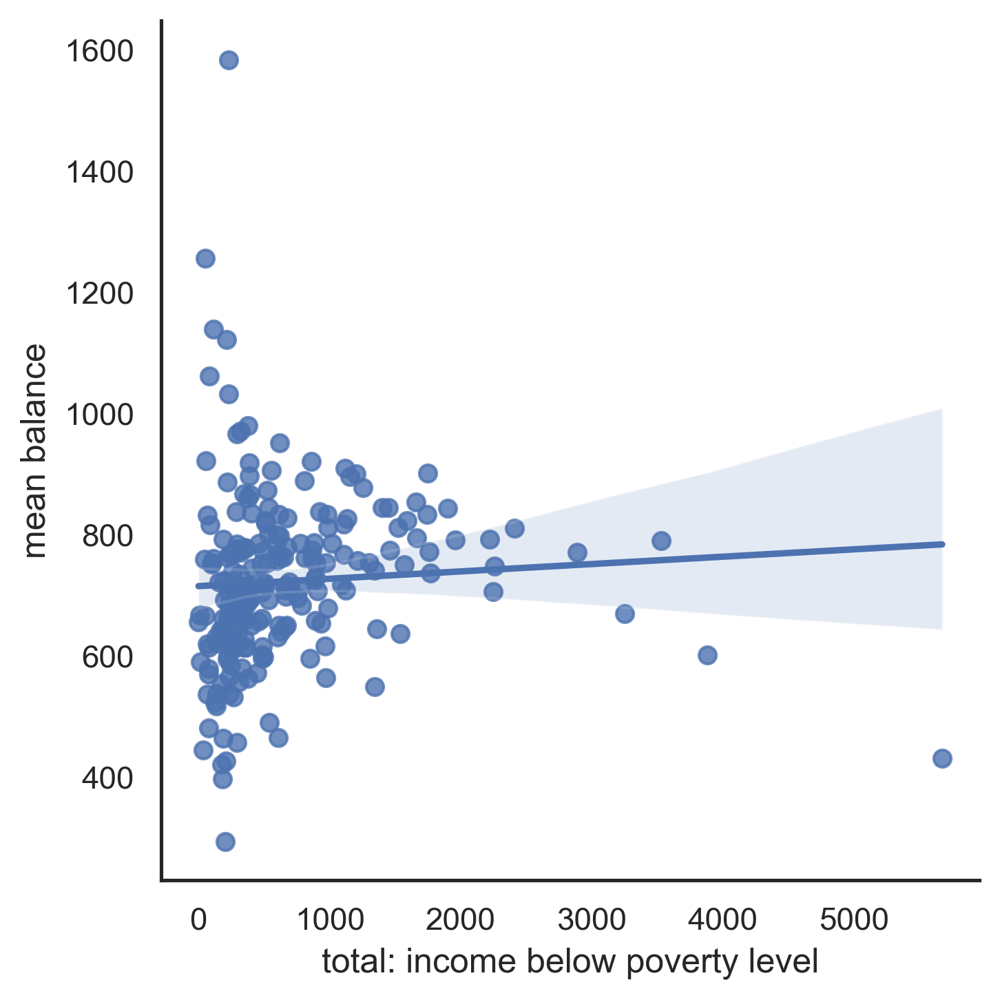

In [63]:
ax = sns.lmplot(
    data=tract_features,
    x='total: income below poverty level',
    y='mean balance'

)







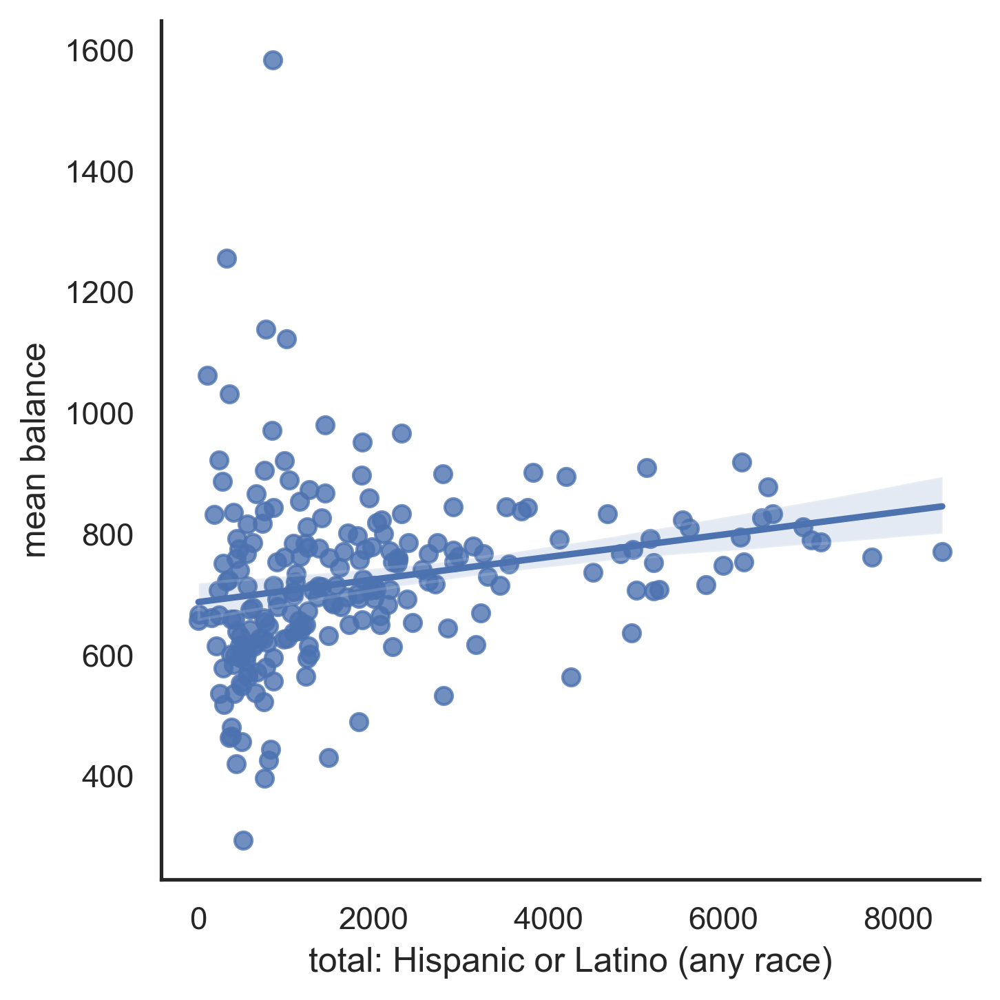

In [64]:
ax = sns.lmplot(
    data=tract_features,
    x='total: Hispanic or Latino (any race)',
    y='mean balance'

)




#### get median income

In [65]:
from cenpy import products

In [66]:
acs = products.ACS(2019)

In [68]:
median_income = acs.from_county(
    'Travis County, TX',
    variables = ['B06011_001E'],
    return_geometry=False
)

KeyError: 'Response from API is malformed. You may have submitted too many queries, formatted the request incorrectly, or experienced significant network connectivity issues. Check to make sure that your inputs, like placenames, are spelled correctly, and that your geographies match the level at which you intend to query. The original error from the Census is:\\n(API ERROR 400:Unable to complete operation.([]))'

In [ ]:
median_income = median_income.rename(columns={'B06011_001E':'median income'})

In [ ]:
median_income = median_income.set_index('GEOID')

In [ ]:
tract_features = tract_features.join(median_income['median income'])

In [ ]:
tract_features.head()

,total population,[denominator: total population for Race],total: White,total: Black,total: Asian,[denominator: total population for Hispanic or Latino],total: Hispanic or Latino (any race),[denominator: total population for poverty],total: income below poverty level,median gross rent,...,state,county,tract,count of individuals with warrant record,warrant prevalence,geometry,total tract balance,percent poverty,mean balance,median income
GEOID,,,,,,,,,,,,,,,,,,,,,
48453001779,6546.0,6546.0,6192.0,199.0,53.0,6546.0,1193.0,6462.0,283.0,1366.0,...,48,453,001779,26,0.003972,"POLYGON ((-98.03709 30.42049, -98.03706 30.421...",16242.70,0.043794,649.708000,31372.0
48453001778,4339.0,4339.0,4020.0,181.0,59.0,4339.0,378.0,4263.0,77.0,1580.0,...,48,453,001778,7,0.001613,"POLYGON ((-97.98135 30.36760, -97.98082 30.367...",3365.19,0.018062,480.741429,54214.0
48453001740,5017.0,5017.0,4067.0,214.0,501.0,5017.0,985.0,5017.0,219.0,1682.0,...,48,453,001740,19,0.003787,"POLYGON ((-97.86957 30.19587, -97.86929 30.196...",13721.70,0.043652,762.316667,49370.0
48453001729,5075.0,5075.0,4272.0,19.0,480.0,5075.0,1631.0,5075.0,332.0,1362.0,...,48,453,001729,57,0.011232,"POLYGON ((-97.84230 30.19542, -97.84024 30.198...",31929.28,0.065419,679.346383,39299.0
48453002423,6007.0,6007.0,5252.0,373.0,133.0,6007.0,2271.0,6007.0,478.0,1710.0,...,48,453,002423,89,0.014816,"POLYGON ((-97.82000 30.17389, -97.81865 30.176...",49591.60,0.079574,751.387879,39225.0


<AxesSubplot:xlabel='median income', ylabel='total tract balance'>

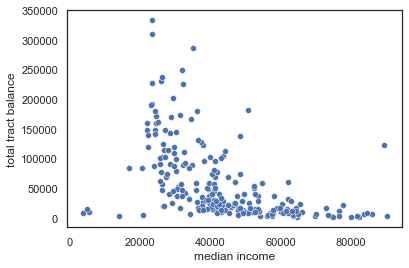

In [ ]:
sns.scatterplot(
    data=tract_features,
    x='median income',
    y='total tract balance'

)

(18000.0, 90000.0)

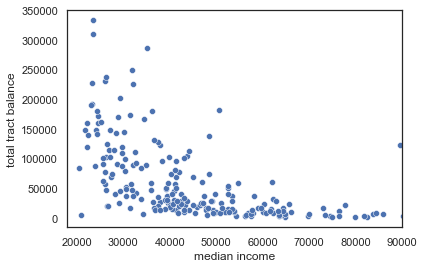

In [ ]:
sns.scatterplot(
    data=tract_features,
    x='median income',
    y='total tract balance'

)

plt.xlim(18000,90000)

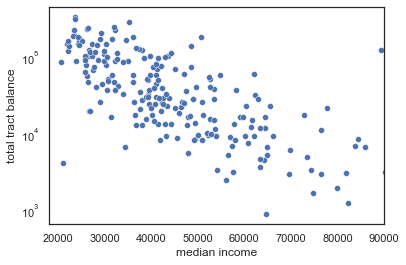

In [ ]:
sns.scatterplot(
    data=tract_features,
    x='median income',
    y='total tract balance'

)

plt.xlim(18000,90000)
plt.yscale('log')

<AxesSubplot:xlabel='median income', ylabel='mean balance'>

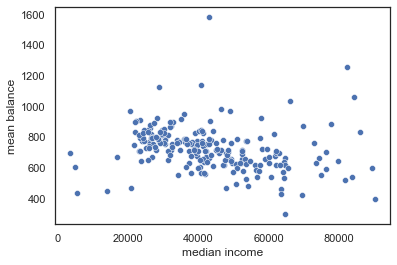

In [ ]:
sns.scatterplot(
    data=tract_features,
    x='median income',
    y='mean balance'

)

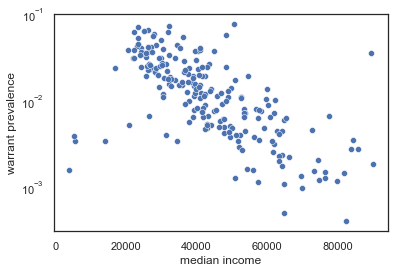

In [ ]:
sns.scatterplot(
    data=tract_features,
    x='median income',
    y='warrant prevalence'

)

plt.yscale('log')

/opt/anaconda3/envs/mapper2/lib/python3.7/site-packages/seaborn/axisgrid.py:88: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


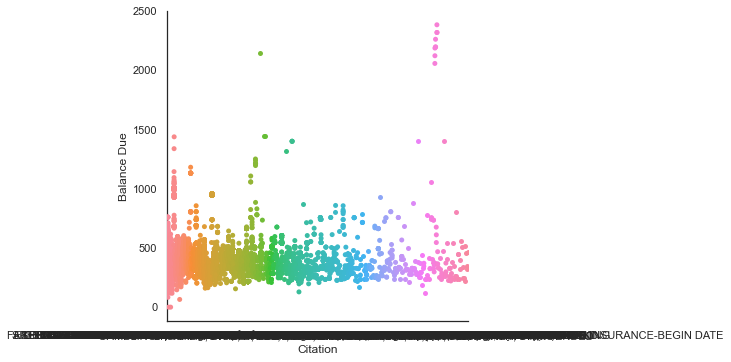

In [ ]:
sns.catplot(
    data=ids,
    x='Citation',
    y='Balance Due'

)

In [ ]:
ids['Citation'].value_counts()

FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY       6927
NO DRIVERS LICENSE                                6370
EXPIRED REGISTRATION                              2420
DRIVING WHILE LICENSE INVALID - SUSPENDED         1975
SPEEDING - STATE HIGHWAY                          1748
                                                  ... 
DRIVING IN BICYCLE LANE                              1
EXPIRED REGISTRATION-09/2017                         1
NMV - NO RIGHT/LEFT/STRAIGHT - POSTED SIGN           1
FIRE - TEMPORARY MEMBRANE OR TENT PERMIT             1
POSTED SIGN - NO STOPPING / STANDING / PARKING       1
Name: Citation, Length: 437, dtype: int64

In [ ]:
ids['Citation'].value_counts().to_dict()

{'FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY': 6927,
 'NO DRIVERS LICENSE': 6370,
 'EXPIRED REGISTRATION': 2420,
 'DRIVING WHILE LICENSE INVALID - SUSPENDED': 1975,
 'SPEEDING - STATE HIGHWAY': 1748,
 'SPEEDING - POSTED CITY STREET': 1155,
 'RAN RED LIGHT': 777,
 'ELECTRONIC DEVICE USE WHILE DRIVING': 586,
 'PUBLIC INTOXICATION': 549,
 'FAILED TO MAINTAIN ASSURED CLEAR DISTANCE-COLLISION': 542,
 'NO SEAT BELT- DRIVER': 499,
 'THEFT C - LESS THAN $100': 477,
 'POSSESSION OF DRUG PARAPHERNALIA': 476,
 'EXPIRED DRIVER LICENSE - OPERATOR (NON-COMMERCIAL)': 377,
 'RAN STOP SIGN': 372,
 'FAILED TO MAINTAIN FINANCIAL RESP 2ND CONV': 328,
 'INSPECTION STICKER - EXPIRED': 297,
 'NO SEAT BELT - CHILD UNDER 8': 248,
 'SPEEDING - SCHOOL ZONE': 246,
 'FAILED TO DISPLAY DRIVER LICENSE': 216,
 'UNREGISTERED MOTOR VEHICLE': 195,
 'SPEEDING - 30 MPH ZONE': 194,
 'FAILED TO OBTAIN TX DRIVERS LICENSE': 182,
 'ANIMAL - IMPROPER CARE': 176,
 'UNSAFE MOVEMENT LEFT/RIGHT': 175,
 'THEFT C - LESS THAN $50': 1

In [ ]:
ids[ids['Citation'].isin([
    'FAILURE TO PROCEED THROUGH GREEN LIGHT',
    'PARKING - OVER 18 INCHES FROM CURB',
    'UNIVERSAL RECYCLING - REGISTRATION',
    'PEDICAB PASSENGER NOT SITTING',
    'BICYCLE - RAN STOP SIGN',
    'FAIL TO SIGNAL INTENT TO TURN',
    'FAILURE TO SIGNAL INTENT TO CHANGE LANES',
    'STOPPING ON MAIN HIGHWAY',
    'GT - PEDI-CAB-TOO MANY PASSENGERS',
    'NMV - BICYCLE FAILED TO RIDE TO RIGHT SIDE'
      
    
])][['ID','Name','Citation','Balance Due','Status']]

,ID,Name,Citation,Balance Due,Status
16143,2032596,"Schmitz, Georgia Pearl",STOPPING ON MAIN HIGHWAY,327.60,WARRANT
21902,1014628,"Corley, Virginia N",FAILURE TO SIGNAL INTENT TO CHANGE LANES,217.00,WARRANT
39813,2068115,"Trevino, Juan",FAILURE TO PROCEED THROUGH GREEN LIGHT,406.38,WARRANT
41014,428548,"Espinoza, Leonel",UNIVERSAL RECYCLING - REGISTRATION,279.50,WARRANT
58411,2034644,"Morales, Gerardo M",GT - PEDI-CAB-TOO MANY PASSENGERS,409.50,WARRANT
70035,2257495,"Angell, Eugene",NMV - BICYCLE FAILED TO RIDE TO RIGHT SIDE,258.70,WARRANT


In [ ]:
ids[ids['Citation'].isin([
    'FAILURE TO PROCEED THROUGH GREEN LIGHT',
    'BICYCLE - RAN STOP SIGN',
    'FAIL TO SIGNAL INTENT TO TURN',
    'FAILURE TO SIGNAL INTENT TO CHANGE LANES',
    'GT - PEDI-CAB-TOO MANY PASSENGERS',
    'NMV - BICYCLE FAILED TO RIDE TO RIGHT SIDE'
      
    
])][['Name','Citation','Balance Due','Status']].sample(4)

,Name,Citation,Balance Due,Status
58411,"Morales, Gerardo M",GT - PEDI-CAB-TOO MANY PASSENGERS,409.50,WARRANT
39813,"Trevino, Juan",FAILURE TO PROCEED THROUGH GREEN LIGHT,406.38,WARRANT
70035,"Angell, Eugene",NMV - BICYCLE FAILED TO RIDE TO RIGHT SIDE,258.70,WARRANT
21902,"Corley, Virginia N",FAILURE TO SIGNAL INTENT TO CHANGE LANES,217.00,WARRANT


In [ ]:
ids[ids['Citation'].isin([
    'SIT OR LIE ON PUBLIC SIDEWALK'    
])][['ID','Name','Citation','Balance Due','Status']]   
    

,ID,Name,Citation,Balance Due,Status
26052,2214698,"Maxwell, Daisey Earlene",SIT OR LIE ON PUBLIC SIDEWALK,273.0,WARRANT
26053,2214698,"Maxwell, Daisey Earlene",SIT OR LIE ON PUBLIC SIDEWALK,273.0,WARRANT
27434,1253631,"Walker, Annie M",SIT OR LIE ON PUBLIC SIDEWALK,273.0,WARRANT
55775,2040100,"Elkins, James D",SIT OR LIE ON PUBLIC SIDEWALK,273.0,WARRANT
59238,326188,"Zeigler, Bryan J",SIT OR LIE ON PUBLIC SIDEWALK,234.0,WARRANT


In [ ]:
ids[ids['Citation'].isin([
    'SIT OR LIE ON PUBLIC SIDEWALK'    
])]

,ID,Name,GEOID,Case #,Citation,Date Ticket Issued,Time,Latest Action,Balance Due,Status,geometry,Type
26052,2214698,"Maxwell, Daisey Earlene",48453001812,8690539,SIT OR LIE ON PUBLIC SIDEWALK,5/28/2018,01:02:00,Issued,273.0,WARRANT,POINT (-97.69421 30.33438),City Ordinance
26053,2214698,"Maxwell, Daisey Earlene",48453001812,8694503,SIT OR LIE ON PUBLIC SIDEWALK,6/12/2018,08:58:00,Issued,273.0,WARRANT,POINT (-97.69421 30.33438),City Ordinance
27434,1253631,"Walker, Annie M",48453001848,8690538,SIT OR LIE ON PUBLIC SIDEWALK,5/28/2018,12:59:00,Issued,273.0,WARRANT,POINT (-97.67599 30.41699),City Ordinance
55775,2040100,"Elkins, James D",48453002112,8346867,SIT OR LIE ON PUBLIC SIDEWALK,11/2/2015,03:50:00,Issued,273.0,WARRANT,POINT (-97.67938 30.32189),City Ordinance
59238,326188,"Zeigler, Bryan J",48453001766,8078917,SIT OR LIE ON PUBLIC SIDEWALK,4/29/2014,07:55:00,Issued,234.0,WARRANT,POINT (-98.10069 30.51257),City Ordinance


In [ ]:
ids[ids['Citation'].isin([
'PEDESTRIAN WALKING AGAINST LIGHT'    
])][['ID','Name','Citation','Balance Due','Status']]

,ID,Name,Citation,Balance Due,Status
80,2187653,"Nieto, Luciano Diaz",PEDESTRIAN WALKING AGAINST LIGHT,222.3,WARRANT
968,2163695,"Phillips, Leshawnda D",PEDESTRIAN WALKING AGAINST LIGHT,222.3,WARRANT
4314,431594,"Dougherty, Gary Steven",PEDESTRIAN WALKING AGAINST LIGHT,222.3,WARRANT
4701,1763251,"Williams, Kenneth Niger",PEDESTRIAN WALKING AGAINST LIGHT,222.3,WARRANT
4891,2129077,"Benavides, Haley Ann",PEDESTRIAN WALKING AGAINST LIGHT,222.3,WARRANT
4965,2028032,"Brown, Christopher D",PEDESTRIAN WALKING AGAINST LIGHT,222.3,WARRANT
6835,2144513,"Vega-Alvarado, Casar",PEDESTRIAN WALKING AGAINST LIGHT,222.3,WARRANT
7719,2100797,"Morales, Jose Arredondo Luis",PEDESTRIAN WALKING AGAINST LIGHT,322.3,WARRANT
8953,2035837,"Simpkins, Ben",PEDESTRIAN WALKING AGAINST LIGHT,222.3,WARRANT
9501,2189996,"Houpt, Graham Parker",PEDESTRIAN WALKING AGAINST LIGHT,222.3,WARRANT


<AxesSubplot:xlabel='Balance Due', ylabel='Citation'>

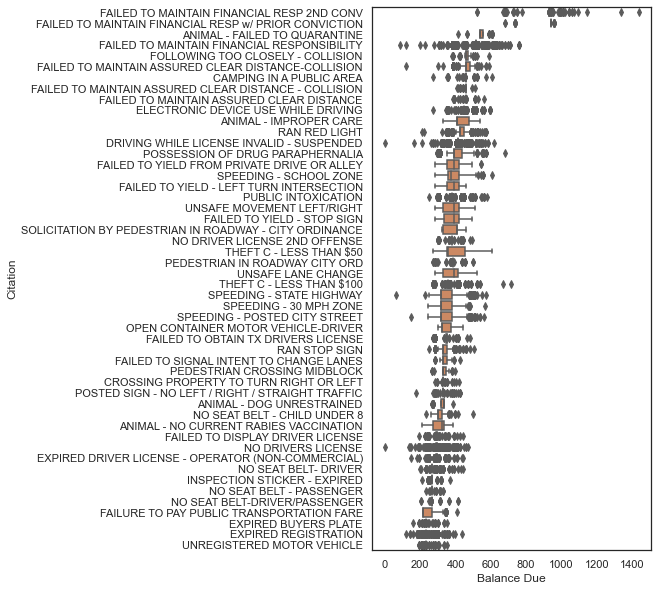

In [ ]:
fig,ax= plt.subplots(figsize=(5,10))

sns.boxplot(
    data=ids[ids['Citation'].isin(ids['Citation'].value_counts().index[:50])],
    y='Citation',
    x='Balance Due',
    order=ids[ids['Citation'].isin(ids['Citation'].value_counts().index[:50])].groupby('Citation')['Balance Due'].mean().sort_values(ascending=False).index,
    orient='h',
    ax=ax,
    color='C1'

)


<AxesSubplot:xlabel='Balance Due', ylabel='Citation'>

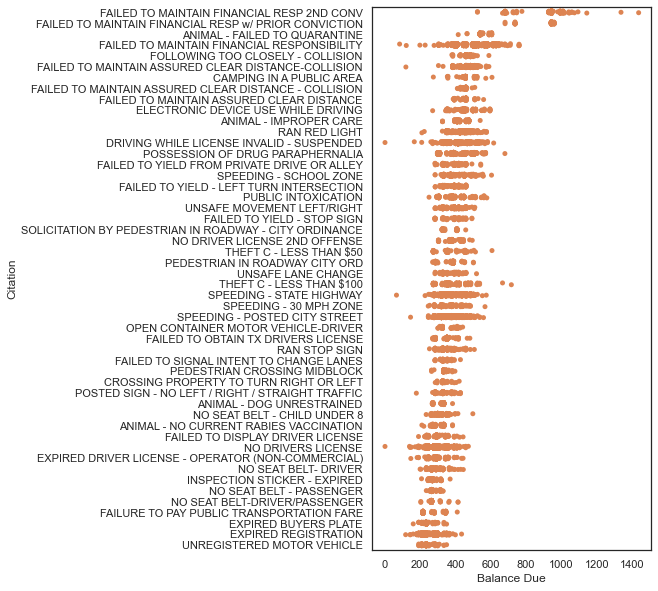

In [ ]:
fig,ax= plt.subplots(figsize=(5,10))

sns.stripplot(
    data=ids[ids['Citation'].isin(ids['Citation'].value_counts().index[:50])],
    y='Citation',
    x='Balance Due',
    order=ids[ids['Citation'].isin(ids['Citation'].value_counts().index[:50])].groupby('Citation')['Balance Due'].mean().sort_values(ascending=False).index,
    orient='h',
    ax=ax,
    color='C1'

)



<AxesSubplot:xlabel='Balance Due', ylabel='Citation'>

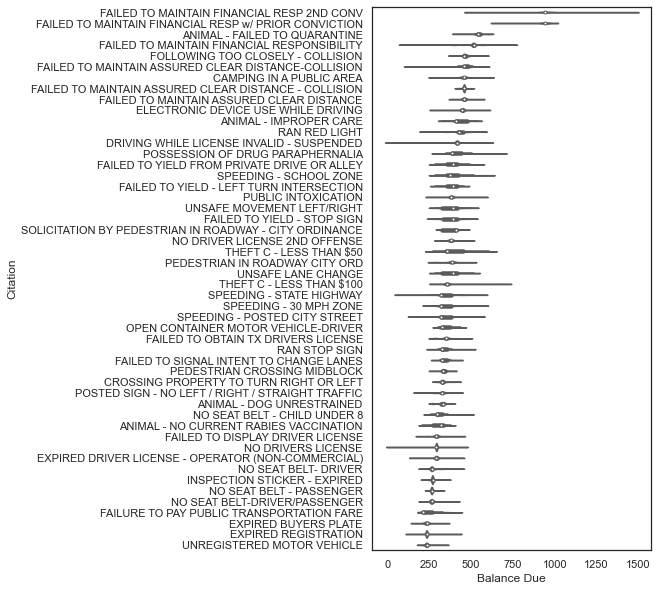

In [ ]:
fig,ax= plt.subplots(figsize=(5,10))

sns.violinplot(
    data=ids[ids['Citation'].isin(ids['Citation'].value_counts().index[:50])],
    y='Citation',
    x='Balance Due',
    order=ids[ids['Citation'].isin(ids['Citation'].value_counts().index[:50])].groupby('Citation')['Balance Due'].mean().sort_values(ascending=False).index,
    orient='h',
    ax=ax,
    color='C1'

)




In [ ]:
def_info = pd.read_csv('def_info.csv')

In [ ]:
def_info

,index,Defendant,Total Cost,Amount Paid,Balance Due,Case #
0,NaN,"Zapata, Xavier G",$499.20,$0.00,$499.20,8822364
1,NaN,"Zapata, Xavier G",$499.20,$0.00,$499.20,8822364
2,NaN,"Zapata, Xavier G",$512.20,$512.20,$0.00,8822364
3,NaN,"Zapata, Xavier G",$499.20,$0.00,$499.20,8822364
4,NaN,"Zapata, Xavier G",$943.10,$0.00,$943.10,8822364
...,...,...,...,...,...,...
95367,NaN,"Palominos, Delustano",$227.00,$0.00,$227.00,8851535
95368,NaN,"Garcia, Sayra Cristela",$186.00,$0.00,$186.00,8851542
95369,NaN,"Garcia, Sayra Cristela",$333.00,$0.00,$333.00,8851543
95370,NaN,"Herrera Jr, Rafael Antonio",$277.00,$277.00,$0.00,8851551


In [ ]:
viol_info = pd.read_csv('viol_info.csv')

In [ ]:
viol_info

,index,Code,Violation,Date Ticket Issued,Case #
0,NaN,01725,FAILED TO MAINTAIN ASSURED CLEAR DISTANCE-COLL...,3/9/2020,8822364
1,NaN,01725,FAILED TO MAINTAIN ASSURED CLEAR DISTANCE-COLL...,3/9/2020,8822364
2,NaN,04920,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,12/9/2013,8822364
3,NaN,01725,FAILED TO MAINTAIN ASSURED CLEAR DISTANCE-COLL...,3/9/2020,8822364
4,NaN,04930,FAILED TO MAINTAIN FINANCIAL RESP w/ PRIOR CON...,3/9/2020,8822364
...,...,...,...,...,...
95367,NaN,00116,SPEEDING - STATE WORK ZONE - NO WORKERS,5/6/2021,8851535
95368,NaN,10311,NO DRIVERS LICENSE,5/6/2021,8851542
95369,NaN,00570,FAILED TO YIELD - YIELD SIGN,5/6/2021,8851543
95370,NaN,00160,SPEEDING - STATE HIGHWAY,4/20/2021,8851551


In [ ]:
# which violation is the most common, per tract
# which violation produces the greatest total debt, per tract
# which violation produces the greatest mean debt, per tract

In [ ]:
ids.set_index(['GEOID','Citation'])[['Balance Due']].count(axis=1)

GEOID        Citation                                           
48453001774  ALCOHOL AT PARK                                        1
             FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY            1
             NO DRIVERS LICENSE                                     1
             SPEEDING - STATE HIGHWAY - LESS THAN 10% OVER LIMIT    1
             FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY            1
                                                                   ..
48453001919  ELECTRONIC DEVICE USE WHILE DRIVING                    1
             NO DRIVERS LICENSE                                     1
48453001918  ELECTRONIC DEVICE USE WHILE DRIVING                    1
             FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY            1
             NO DRIVERS LICENSE                                     1
Length: 33416, dtype: int64

In [ ]:
ids.set_index(['GEOID','Citation']).groupby('Citation')['Balance Due'].sum()

Citation
AGGRESSIVE CONFRONTATION                                  213.8
AIRPORT - CIRCUMVENTED SCREENING                          531.0
ALCOHOL - CONSUME WHERE PROHIBITED-TRANSIT AUTHORITY    10568.0
ALCOHOL - CONSUMING ON PREMISES                         13777.9
ALCOHOL - MINOR CONSUMING                                 650.0
                                                         ...   
ZONING - IMPERVIOUS COVER                                1830.9
ZONING - NO CERTIFICATE OF COMPLIANCE                    7020.5
ZONING - NO SITE PLAN                                    6366.6
ZONING - RV STORAGE                                       430.3
ZONING - SELLING MERCHANDISE WITHOUT LICENSE              784.5
Name: Balance Due, Length: 437, dtype: float64

In [ ]:
ids.groupby(['GEOID','Citation'])['Balance Due'].sum().sort_values(ascending=False)

GEOID        Citation                                        
48453002202  FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY         100924.2
48453002426  FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY          86531.5
48453001806  FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY          80490.7
48453002314  FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY          68867.4
48453000902  FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY          66355.9
                                                                   ...   
48453002424  EXPIRED BUYERS PLATE                                   160.0
48453001305  NO LEFT / RIGHT / STRAIGHT TRAFFIC - POSTED SIGN       154.7
48453000203  SOLICITATION - AGGRESSIVE                              128.7
48453002436  UNREGISTERED OR EXPIRED MOTOR VEHICLE                  120.0
48453002004  SPEEDING - STATE HIGHWAY                                65.0
Name: Balance Due, Length: 7509, dtype: float64

In [ ]:
ids.groupby(['GEOID','Citation'])['Case #'].value_counts()

GEOID        Citation                                   Case # 
48453000101  DRIVING WHILE LICENSE INVALID - SUSPENDED  8794015    1
             EXPIRED REGISTRATION                       8782519    1
                                                        8793661    1
                                                        8796556    1
             FAILED TO DISPLAY DRIVER LICENSE           8811305    1
                                                                  ..
48453980000  THEFT C - LESS THAN $50                    8142502    1
                                                        8167080    1
                                                        8331828    1
             UNREGISTERED MOTOR VEHICLE                 8639222    1
             UNSAFE LANE CHANGE                         8675096    1
Name: Case #, Length: 33416, dtype: int64

In [69]:
most_frequent_citation = pd.DataFrame.from_records(
    ids.groupby('GEOID')['Citation'].value_counts(   # count citations by citation type by tract
        ).groupby('GEOID').idxmax().values,          # get (tract, citation) of citation with highest count
    columns=['GEOID', 'most frequent citation']).set_index('GEOID')     # put those tuples in a frame

In [70]:
most_costly_citation = pd.DataFrame.from_records(
     ids.groupby(['GEOID','Citation'])['Balance Due'].sum(   # sum balances by citation type by tract
     ).groupby('GEOID').idxmax().values,                     # get (tract, citation) of citation with highest total balance
     columns=['GEOID', 'most costly citation']).set_index('GEOID')

In [71]:
tract_features = tract_features.join(most_frequent_citation, how='left')

In [72]:
tract_features = tract_features.join(most_costly_citation, how='left')

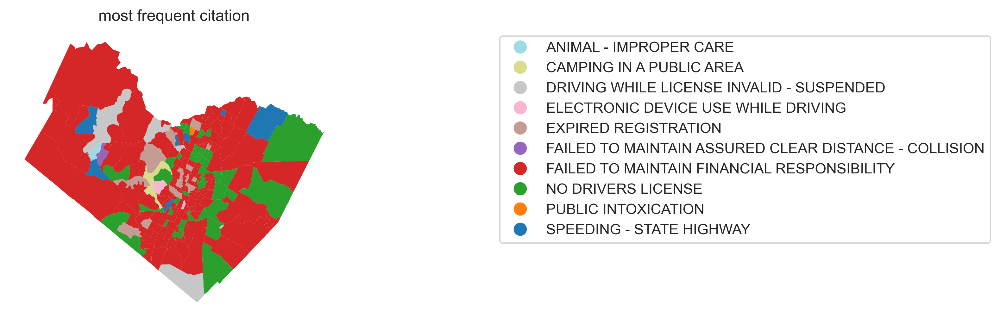

In [73]:
tract_features.plot(
    column='most frequent citation',
    legend=True,
    legend_kwds={'bbox_to_anchor':(3,1)},
    edgecolor='none',
    cmap='tab20_r'
);

plt.axis('off')
plt.title('most frequent citation');

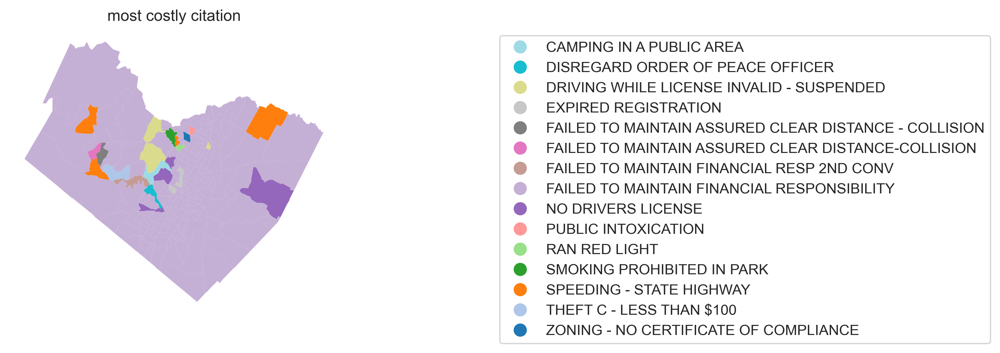

In [74]:
tract_features.plot(
    column='most costly citation',
    legend=True,
    legend_kwds={'bbox_to_anchor':(3,1)},
    edgecolor='none',
    cmap='tab20_r'
);

plt.axis('off');
plt.title('most costly citation');

In [75]:
sns.boxplot(
    data=tract_features,
    x='median income',
    y='most frequent citation',
    color='C2'
);

ValueError: Could not interpret input 'median income'

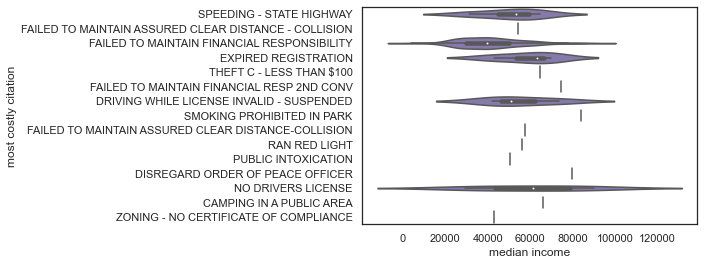

In [ ]:
sns.violinplot(
    data=tract_features,
    x='median income',
    y='most costly citation',
    color='C4'
);

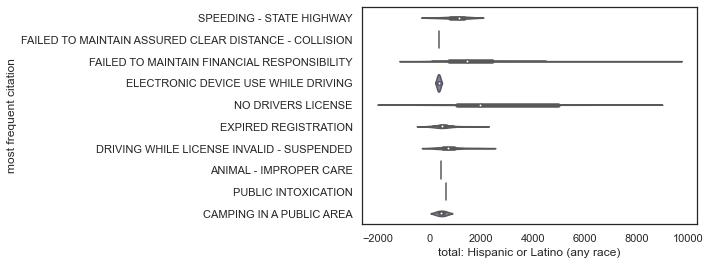

In [ ]:
sns.violinplot(
    data=tract_features,
    x='total: Hispanic or Latino (any race)',
    y='most frequent citation',
    color='C4'
);

In [ ]:
# outstanding debt per household vs median rent

In [76]:
acs.filter_tables('HOUSEHOLDS', by='description')

,description,columns
table_name,,
B09005,HOUSEHOLD TYPE FOR CHILDREN UNDER 18 YEARS IN ...,"[B09005_001E, B09005_002E, B09005_003E, B09005..."
B09010,"RECEIPT OF SUPPLEMENTAL SECURITY INCOME (SSI),...","[B09010_001E, B09010_002E, B09010_003E, B09010..."
B09018,RELATIONSHIP TO HOUSEHOLDER FOR CHILDREN UNDER...,"[B09018_001E, B09018_002E, B09018_003E, B09018..."
B10063,HOUSEHOLDS WITH GRANDPARENTS LIVING WITH OWN G...,"[B10063_001E, B10063_002E, B10063_003E, B10063..."
B11002,HOUSEHOLD TYPE BY RELATIVES AND NONRELATIVES F...,"[B11002_001E, B11002_002E, B11002_003E, B11002..."
B11005,HOUSEHOLDS BY PRESENCE OF PEOPLE UNDER 18 YEAR...,"[B11005_001E, B11005_002E, B11005_003E, B11005..."
B11006,HOUSEHOLDS BY PRESENCE OF PEOPLE 60 YEARS AND ...,"[B11006_001E, B11006_002E, B11006_003E, B11006..."
B11007,HOUSEHOLDS BY PRESENCE OF PEOPLE 65 YEARS AND ...,"[B11007_001E, B11007_002E, B11007_003E, B11007..."
B11008,COHABITING COUPLE HOUSEHOLDS BY PRESENCE AND A...,"[B11008_001E, B11008_002E, B11008_003E, B11008..."


In [77]:
acs.filter_variables('B22001_002E')['label'].to_list()

['Estimate!!Total:!!Household received Food Stamps/SNAP in the past 12 months:']

In [78]:
household_vars={
    'B11012_001E':'total: households',
    'B22001_002E':'total: hhs received SNAP'
}

In [79]:
households_count = acs.from_county(
    'Travis County, TX',
    variables = list(household_vars.keys()),
    return_geometry = False
)

KeyError: 'Response from API is malformed. You may have submitted too many queries, formatted the request incorrectly, or experienced significant network connectivity issues. Check to make sure that your inputs, like placenames, are spelled correctly, and that your geographies match the level at which you intend to query. The original error from the Census is:\\n(API ERROR 400:Unable to complete operation.([]))'

In [ ]:
households_count = households_count.rename(columns=household_vars)

In [ ]:
households_count = households_count.set_index('GEOID')

In [ ]:
tract_features = tract_features.join(households_count[household_vars.values()], how='left')

In [80]:
tract_features

,total population,[denominator: total population for Race],total: White,total: Black,total: Asian,[denominator: total population for Hispanic or Latino],total: Hispanic or Latino (any race),[denominator: total population for poverty],total: income below poverty level,median gross rent,...,county,tract,count of individuals with warrant record,warrant prevalence,geometry,total tract balance,percent poverty,mean balance,most frequent citation,most costly citation
GEOID,,,,,,,,,,,,,,,,,,,,,
48453001779,6546.0,6546.0,6192.0,199.0,53.0,6546.0,1193.0,6462.0,283.0,1366.0,...,453,001779,26,0.003972,"POLYGON ((-98.03709 30.42049, -98.03706 30.421...",16242.70,0.043794,649.708000,SPEEDING - STATE HIGHWAY,SPEEDING - STATE HIGHWAY
48453001778,4339.0,4339.0,4020.0,181.0,59.0,4339.0,378.0,4263.0,77.0,1580.0,...,453,001778,7,0.001613,"POLYGON ((-97.98135 30.36760, -97.98082 30.367...",3365.19,0.018062,480.741429,FAILED TO MAINTAIN ASSURED CLEAR DISTANCE - CO...,FAILED TO MAINTAIN ASSURED CLEAR DISTANCE - CO...
48453001740,5017.0,5017.0,4067.0,214.0,501.0,5017.0,985.0,5017.0,219.0,1682.0,...,453,001740,19,0.003787,"POLYGON ((-97.86957 30.19587, -97.86929 30.196...",13721.70,0.043652,762.316667,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY
48453001729,5075.0,5075.0,4272.0,19.0,480.0,5075.0,1631.0,5075.0,332.0,1362.0,...,453,001729,57,0.011232,"POLYGON ((-97.84230 30.19542, -97.84024 30.198...",31929.28,0.065419,679.346383,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY
48453002423,6007.0,6007.0,5252.0,373.0,133.0,6007.0,2271.0,6007.0,478.0,1710.0,...,453,002423,89,0.014816,"POLYGON ((-97.82000 30.17389, -97.81865 30.176...",49591.60,0.079574,751.387879,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48453000306,6029.0,6029.0,4602.0,396.0,623.0,6029.0,1162.0,6000.0,630.0,1588.0,...,453,000306,115,0.019074,"POLYGON ((-97.71249 30.30596, -97.71242 30.306...",58225.82,0.105000,639.844176,NO DRIVERS LICENSE,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY
48453002201,2223.0,2223.0,779.0,851.0,8.0,2223.0,1117.0,2223.0,314.0,1383.0,...,453,002201,123,0.055331,"POLYGON ((-97.67323 30.32572, -97.67293 30.325...",74215.03,0.141251,734.802277,NO DRIVERS LICENSE,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY
48453002319,2368.0,2368.0,1176.0,636.0,40.0,2368.0,827.0,37.0,36.0,NaN,...,453,002319,8,0.003378,"POLYGON ((-97.64923 30.19899, -97.64446 30.202...",3109.40,0.972973,444.200000,DRIVING WHILE LICENSE INVALID - SUSPENDED,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY


In [ ]:
tract_features['balance per household'] = tract_features['total tract balance'] / tract_features['total: households']

In [ ]:
tract_features['balance per household'] = tract_features['balance per household'].replace(np.inf, np.nan)

In [ ]:
tract_features['balance per household']

GEOID
48453001779      6.399803
48453001778      1.891619
48453001740      6.789560
48453001729     14.216064
48453002423     19.007896
                  ...    
48453000306     20.757868
48453002201    111.769623
48453002319           NaN
48453002207     67.916270
48453001859      6.631771
Name: balance per household, Length: 218, dtype: float64

In [81]:
geoplot.choropleth(
    tract_features[tract_features['balance per household'] != np.inf],
    hue='balance per household',
    cmap='Reds',
    legend=True

)

KeyError: 'balance per household'

(15000.0, 90000.0)

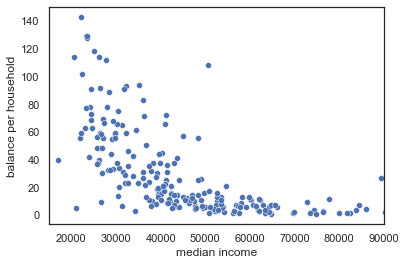

In [ ]:
sns.scatterplot(
    data=tract_features,
    x='median income',
    y='balance per household'

)

plt.xlim(15000,90000)

In [ ]:
tract_features['balance per household per median rent'] = tract_features['balance per household'] / tract_features['median gross rent']

In [ ]:
tract_features['balance per household per median rent'] = tract_features['balance per household per median rent'].replace(np.inf, np.nan)

<AxesSubplot:>

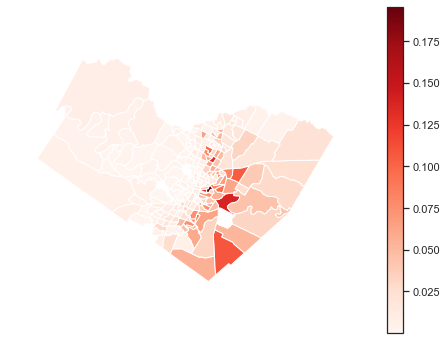

In [ ]:
geoplot.choropleth(
    tract_features[tract_features['balance per household'] != np.inf].dropna(),
    hue='balance per household per median rent',
    cmap='Reds',
    legend=True

)

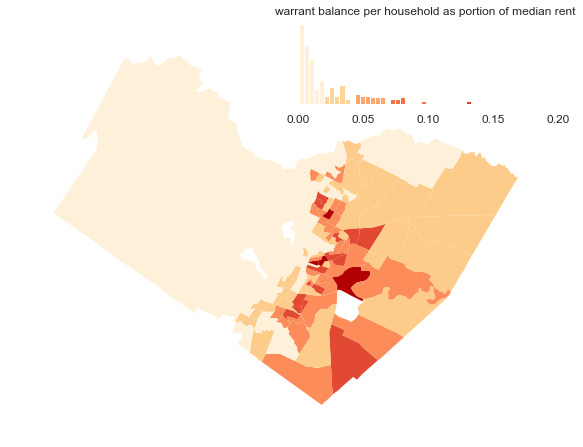

In [ ]:
scheme = mapclassify.FisherJenks(tract_features['balance per household per median rent'].dropna())
pal = colorbrewer.sequential.OrRd_5

fig, ax = plt.subplots(figsize=(10,10))

geoplot.choropleth(
    tract_features[tract_features['balance per household per median rent'] != np.inf].dropna(), 
    hue='balance per household per median rent',
    scheme=scheme,
    cmap=pal.mpl_colormap,
    edgecolor='none',
    ax=ax)

hax = legendgram(
    fig,ax,
    tract_features['balance per household per median rent'],
    breaks=scheme.bins,
    pal=pal,
    legend_size=(.5,.2), # legend size in fractions of the axis
    loc = 'upper right'
)

plt.title('warrant balance per household as portion of median rent')

plt.show()

In [ ]:
tract_features['balance per household per median rent']

GEOID
48453001779    0.004685
48453001778    0.001197
48453001740    0.004037
48453001729    0.010438
48453002423    0.011116
                 ...   
48453000306    0.013072
48453002201    0.080817
48453002319         NaN
48453002207    0.044623
48453001859    0.003596
Name: balance per household per median rent, Length: 218, dtype: float64

In [ ]:
tract_features

,total population,[denominator: total population for Race],total: White,total: Black,total: Asian,[denominator: total population for Hispanic or Latino],total: Hispanic or Latino (any race),[denominator: total population for poverty],total: income below poverty level,median gross rent,...,total tract balance,percent poverty,mean balance,median income,most frequent citation,most costly citation,total: households,total: hhs received SNAP,balance per household,balance per household per median rent
GEOID,,,,,,,,,,,,,,,,,,,,,
48453001779,6546.0,6546.0,6192.0,199.0,53.0,6546.0,1193.0,6462.0,283.0,1366.0,...,16242.70,0.043794,649.708000,31372.0,SPEEDING - STATE HIGHWAY,SPEEDING - STATE HIGHWAY,2538.0,144.0,6.399803,0.004685
48453001778,4339.0,4339.0,4020.0,181.0,59.0,4339.0,378.0,4263.0,77.0,1580.0,...,3365.19,0.018062,480.741429,54214.0,FAILED TO MAINTAIN ASSURED CLEAR DISTANCE - CO...,FAILED TO MAINTAIN ASSURED CLEAR DISTANCE - CO...,1779.0,41.0,1.891619,0.001197
48453001740,5017.0,5017.0,4067.0,214.0,501.0,5017.0,985.0,5017.0,219.0,1682.0,...,13721.70,0.043652,762.316667,49370.0,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,2021.0,11.0,6.789560,0.004037
48453001729,5075.0,5075.0,4272.0,19.0,480.0,5075.0,1631.0,5075.0,332.0,1362.0,...,31929.28,0.065419,679.346383,39299.0,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,2246.0,27.0,14.216064,0.010438
48453002423,6007.0,6007.0,5252.0,373.0,133.0,6007.0,2271.0,6007.0,478.0,1710.0,...,49591.60,0.079574,751.387879,39225.0,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,2609.0,80.0,19.007896,0.011116
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48453000306,6029.0,6029.0,4602.0,396.0,623.0,6029.0,1162.0,6000.0,630.0,1588.0,...,58225.82,0.105000,639.844176,54676.0,NO DRIVERS LICENSE,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,2805.0,122.0,20.757868,0.013072
48453002201,2223.0,2223.0,779.0,851.0,8.0,2223.0,1117.0,2223.0,314.0,1383.0,...,74215.03,0.141251,734.802277,27679.0,NO DRIVERS LICENSE,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,664.0,100.0,111.769623,0.080817
48453002319,2368.0,2368.0,1176.0,636.0,40.0,2368.0,827.0,37.0,36.0,NaN,...,3109.40,0.972973,444.200000,14063.0,DRIVING WHILE LICENSE INVALID - SUSPENDED,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,0.0,0.0,NaN,NaN


In [ ]:
tract_centroids = gpd.GeoDataFrame(
    index=tract_features.index,
    geometry=tract_features.to_crs('EPSG:32040').centroid
)

<AxesSubplot:>

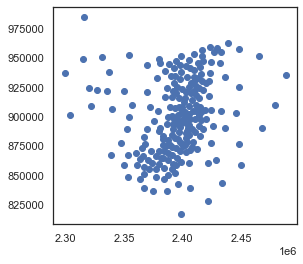

In [ ]:
tract_centroids.plot()

In [ ]:
tract_centroids = tract_centroids.dropna().reset_index()

In [ ]:
W = libpysal.weights.DistanceBand.from_dataframe(
    tract_centroids,
    threshold=500000,
    binary=False
)

/opt/anaconda3/envs/mapper2/lib/python3.7/site-packages/scipy/sparse/data.py:117: RuntimeWarning: divide by zero encountered in reciprocal
  return self._with_data(data ** n)


In [ ]:
W.pct_nonzero

99.54128440366972

In [ ]:
W.transform='r'

(<Figure size 432x288 with 1 Axes>, <AxesSubplot:>)

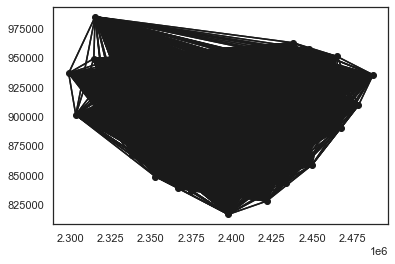

In [ ]:
W.plot(tract_centroids)

In [ ]:
W.weights

{0: [3.3928108943162974e-05,
  9.794318833794804e-06,
  9.769682598137506e-06,
  8.822161185243488e-06,
  1.2424422809348193e-05,
  9.749835391730087e-06,
  1.0290586350130316e-05,
  9.261093433324144e-06,
  1.0991361970721981e-05,
  1.0732123696791796e-05,
  8.269968886915229e-06,
  1.1756880545073648e-05,
  1.067578970215192e-05,
  1.106301344912382e-05,
  1.0577566631497701e-05,
  9.113651951198774e-06,
  9.02614411939844e-06,
  7.911427648917413e-06,
  7.359949238375362e-06,
  5.926083485170629e-06,
  2.42056676187424e-05,
  2.0355373128825262e-05,
  9.292894689661131e-06,
  1.5826669155048758e-05,
  8.194690885601812e-06,
  1.094589225373821e-05,
  9.092954122079689e-06,
  9.310760544417035e-06,
  8.615255538142893e-06,
  1.0921998540621585e-05,
  1.1863989144387994e-05,
  1.2526442548761592e-05,
  9.976749818570397e-06,
  9.856120009904116e-06,
  1.0622070224831478e-05,
  1.1302653564010518e-05,
  9.96086407696775e-06,
  1.0662083342312417e-05,
  9.217164922816953e-06,
  8.346305

In [ ]:
morans = esda.Moran(
    y=tract_features['total tract balance'],
    w=W
)

In [ ]:
morans.I

0.07848733143977951

In [ ]:
def compute_Morans_I(y):
    if y.isna().any():
        y_ = y.dropna()
        W_ = libpysal.weights.DistanceBand.from_dataframe(
            tract_centroids.loc[y_.index],
            threshold=500000,
            binary=False
        )
    else:
        y_ = y
        W_ = W
    return esda.Moran(y=y_,w=W_).I

In [ ]:
#tract_morans = tract_features.apply(
#    lambda y: compute_Morans_I(y))

In [ ]:
tract_features.columns.to_list()

['total population',
 '[denominator: total population for Race]',
 'total: White',
 'total: Black',
 'total: Asian',
 '[denominator: total population for Hispanic or Latino]',
 'total: Hispanic or Latino (any race)',
 '[denominator: total population for poverty]',
 'total: income below poverty level',
 'median gross rent',
 '[denominator: total population for income on rent]',
 'total: paying >50 percent of income on rent',
 'NAME',
 'state',
 'county',
 'tract',
 'count of individuals with warrant record',
 'warrant prevalence',
 'geometry',
 'total tract balance',
 'percent poverty',
 'mean balance',
 'median income',
 'most frequent citation',
 'most costly citation',
 'total: households',
 'total: hhs received SNAP',
 'balance per household',
 'balance per household per median rent']

In [ ]:
variables = [
    'total population',
 'total: White',
 'total: Black',
 'total: Asian',
 'total: Hispanic or Latino (any race)',
 'total: income below poverty level',
 'median gross rent',
 'total: paying >50 percent of income on rent',
 'count of individuals with warrant record',
 'warrant prevalence',
 'total tract balance',
 'percent poverty',
 'mean balance',
 'median income',
 'total: hhs received SNAP',
 'balance per household',
 'balance per household per median rent'
]

In [ ]:
Morans = []
na_cols = []

for y in variables:
    if tract_features[y].notna().all():
        y_ = tract_features[y]
        W_ = W
        Morans.append({y:esda.Moran(y=y_,w=W_).I})
    
    else:
        na_cols.append(y)

In [ ]:
Morans

[{'total population': 0.034231593609738306},
 {'total: White': 0.040554519252306756},
 {'total: Black': 0.09283082095818064},
 {'total: Asian': 0.05628630954129634},
 {'total: Hispanic or Latino (any race)': 0.08144583271735122},
 {'total: income below poverty level': 0.044627650991757674},
 {'total: paying >50 percent of income on rent': 0.03192960353634501},
 {'count of individuals with warrant record': 0.07649936272986081},
 {'total tract balance': 0.07848733143977951},
 {'mean balance': 0.018614572729321936},
 {'total: hhs received SNAP': 0.08459503021632823}]

In [ ]:
na_cols

['median gross rent',
 'warrant prevalence',
 'percent poverty',
 'median income',
 'balance per household',
 'balance per household per median rent']

In [ ]:
Morans = []

for y in variables:
    
    y_ = None
    W_ = None
    
    if tract_features[y].notna().all():
        y_ = tract_features[y]
        W_ = W
        
        print(f'y_: {y_.shape}')
        print(f'W_: {len(W_.weights.keys())}')
        
        I = esda.Moran(y=y_,w=W_).I
        
    else:
        y_ = tract_features[y].dropna()
        
        print(f'y_: {y_.shape}')
        
        W_ = libpysal.weights.DistanceBand.from_dataframe(
                tract_centroids[tract_centroids['GEOID'].isin(y_.index)],
                threshold=500000,
                binary=False
        )
        
        print(f'W_: {len(W_.weights.keys())}')
        
        I = esda.Moran(y=y_,w=W_).I

    Morans.append((y,I))

y_: (218,)
W_: 218
y_: (218,)
W_: 218
y_: (218,)
W_: 218
y_: (218,)
W_: 218
y_: (218,)
W_: 218
y_: (218,)
W_: 218
y_: (212,)
W_: 212
y_: (218,)
W_: 218
y_: (218,)
W_: 218
y_: (217,)
W_: 217
y_: (218,)
W_: 218
y_: (217,)
W_: 217
y_: (218,)
W_: 218
y_: (216,)
W_: 216
y_: (218,)
W_: 218
y_: (215,)
W_: 215
y_: (212,)
W_: 212


In [ ]:
Morans

[('total population', 0.034231593609738306),
 ('total: White', 0.040554519252306756),
 ('total: Black', 0.09283082095818064),
 ('total: Asian', 0.05628630954129634),
 ('total: Hispanic or Latino (any race)', 0.08144583271735122),
 ('total: income below poverty level', 0.044627650991757674),
 ('median gross rent', 0.0523398180341604),
 ('total: paying >50 percent of income on rent', 0.03192960353634501),
 ('count of individuals with warrant record', 0.07649936272986081),
 ('warrant prevalence', 0.054132897689373384),
 ('total tract balance', 0.07848733143977951),
 ('percent poverty', 0.08125508102845636),
 ('mean balance', 0.018614572729321936),
 ('median income', 0.11438319543713135),
 ('total: hhs received SNAP', 0.08459503021632823),
 ('balance per household', 0.10766387058556219),
 ('balance per household per median rent', 0.09965024475662736)]

<AxesSubplot:ylabel='variable'>

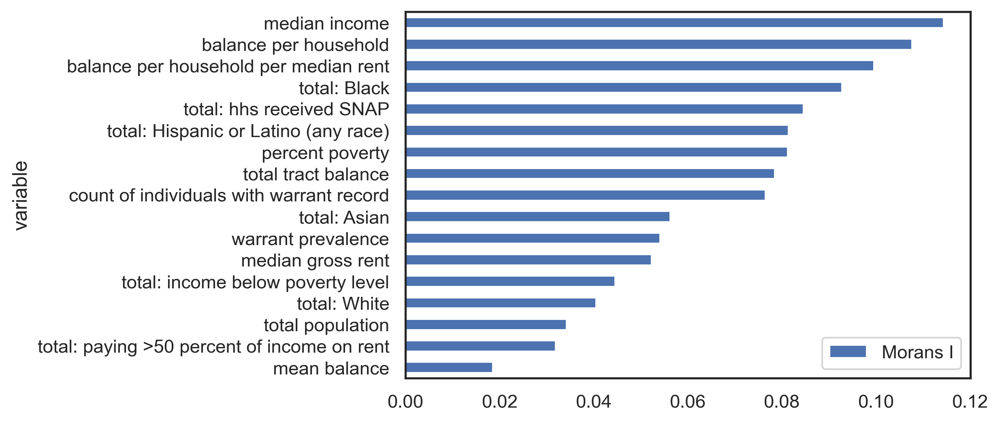

In [ ]:
pd.DataFrame.from_records(Morans, columns=['variable','Morans I']).set_index('variable').sort_values(by='Morans I').plot.barh()

In [ ]:
from libpysal.weights import Queen

In [ ]:
W_queen = Queen.from_dataframe(
    tract_centroids,
    ids = 'GEOID'
)

In [ ]:
W_queen.weights

{'48453001779': [1.0, 1.0, 1.0, 1.0, 1.0],
 '48453001778': [1.0, 1.0, 1.0, 1.0],
 '48453001740': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '48453001729': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '48453002423': [1.0, 1.0, 1.0, 1.0, 1.0],
 '48453001918': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '48453002005': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '48453001901': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '48453002003': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '48453001602': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '48453001603': [1.0, 1.0, 1.0, 1.0, 1.0],
 '48453002412': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '48453001752': [1.0, 1.0, 1.0, 1.0, 1.0],
 '48453001505': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '48453001849': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '48453001864': [1.0, 1.0, 1.0, 1.0, 1.0],
 '48453002106': [1.0, 1.0, 1.0, 1.0],
 '48453002112': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '48453002202': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '48453001856': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '48453002209': [1.0, 1.0, 1.0, 1.0],
 '48453

In [ ]:
W_queen.transform = 'r'

In [ ]:
W_queen.weights

{'48453001779': [0.2, 0.2, 0.2, 0.2, 0.2],
 '48453001778': [0.25, 0.25, 0.25, 0.25],
 '48453001740': [0.14285714285714285,
  0.14285714285714285,
  0.14285714285714285,
  0.14285714285714285,
  0.14285714285714285,
  0.14285714285714285,
  0.14285714285714285],
 '48453001729': [0.16666666666666666,
  0.16666666666666666,
  0.16666666666666666,
  0.16666666666666666,
  0.16666666666666666,
  0.16666666666666666],
 '48453002423': [0.2, 0.2, 0.2, 0.2, 0.2],
 '48453001918': [0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125],
 '48453002005': [0.16666666666666666,
  0.16666666666666666,
  0.16666666666666666,
  0.16666666666666666,
  0.16666666666666666,
  0.16666666666666666],
 '48453001901': [0.16666666666666666,
  0.16666666666666666,
  0.16666666666666666,
  0.16666666666666666,
  0.16666666666666666,
  0.16666666666666666],
 '48453002003': [0.14285714285714285,
  0.14285714285714285,
  0.14285714285714285,
  0.14285714285714285,
  0.14285714285714285,
  0.14285714285714285,
  0.14

In [ ]:
Morans_queen = []

for y in variables:
    
    y_ = None
    W_ = None
    
    if tract_features[y].notna().all():
        y_ = tract_features[y]
        W_ = W_queen
        I = esda.Moran(y=y_,w=W_).I
        
    else:
        y_ = tract_features[y].dropna()        
        W_ = Queen.from_dataframe(
                tract_centroids[tract_centroids['GEOID'].isin(y_.index)],
                ids = 'GEOID',
        )
        W_.transform = 'r'        
        I = esda.Moran(y=y_,w=W_).I

    Morans_queen.append((y,I))

<AxesSubplot:ylabel='variable'>

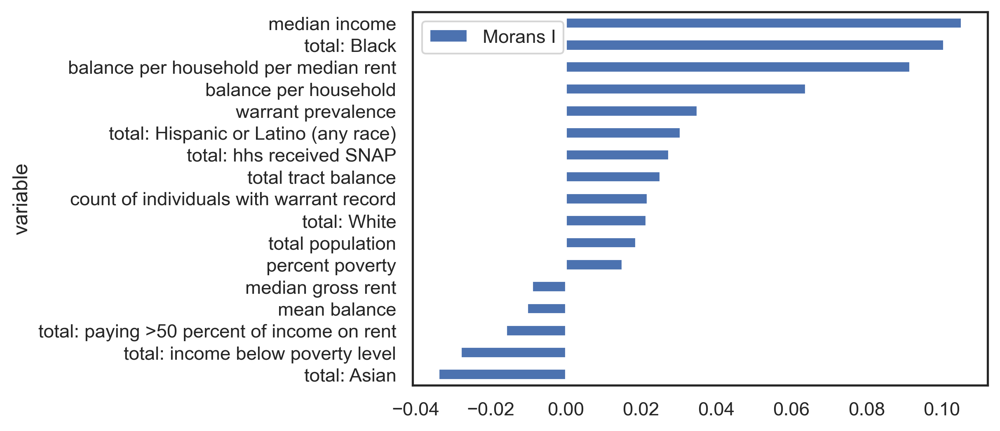

In [ ]:
pd.DataFrame.from_records(Morans_queen, columns=['variable','Morans I']).set_index('variable').sort_values(by='Morans I').plot.barh()

In [ ]:
tract_features[variables].describe().T

,count,mean,std,min,25%,50%,75%,max
total population,218.0,5627.545872,3294.881927,0.000000,3433.250000,4929.000000,6842.750000,24015.000000
total: White,218.0,4078.192661,2410.371494,0.000000,2479.000000,3716.000000,4862.750000,17456.000000
total: Black,218.0,467.683486,584.941177,0.000000,78.750000,235.500000,628.500000,3767.000000
total: Asian,218.0,377.325688,509.504720,0.000000,87.500000,197.000000,411.500000,3000.000000
total: Hispanic or Latino (any race),218.0,1902.500000,1763.147116,0.000000,631.750000,1257.000000,2366.750000,8502.000000
total: income below poverty level,218.0,659.564220,706.773820,0.000000,238.000000,404.500000,864.000000,5671.000000
median gross rent,212.0,1377.683962,320.229863,385.000000,1169.750000,1319.000000,1548.500000,2851.000000
total: paying >50 percent of income on rent,218.0,221.954128,203.207727,0.000000,71.000000,180.500000,329.500000,1581.000000
count of individuals with warrant record,218.0,94.591743,98.539909,1.000000,24.000000,55.000000,139.250000,510.000000
warrant prevalence,217.0,0.018476,0.019983,0.000395,0.004889,0.012264,0.025583,0.187500


(-98.2131489067198, -97.32936709727277, 29.994311495815758, 30.658436520626807)

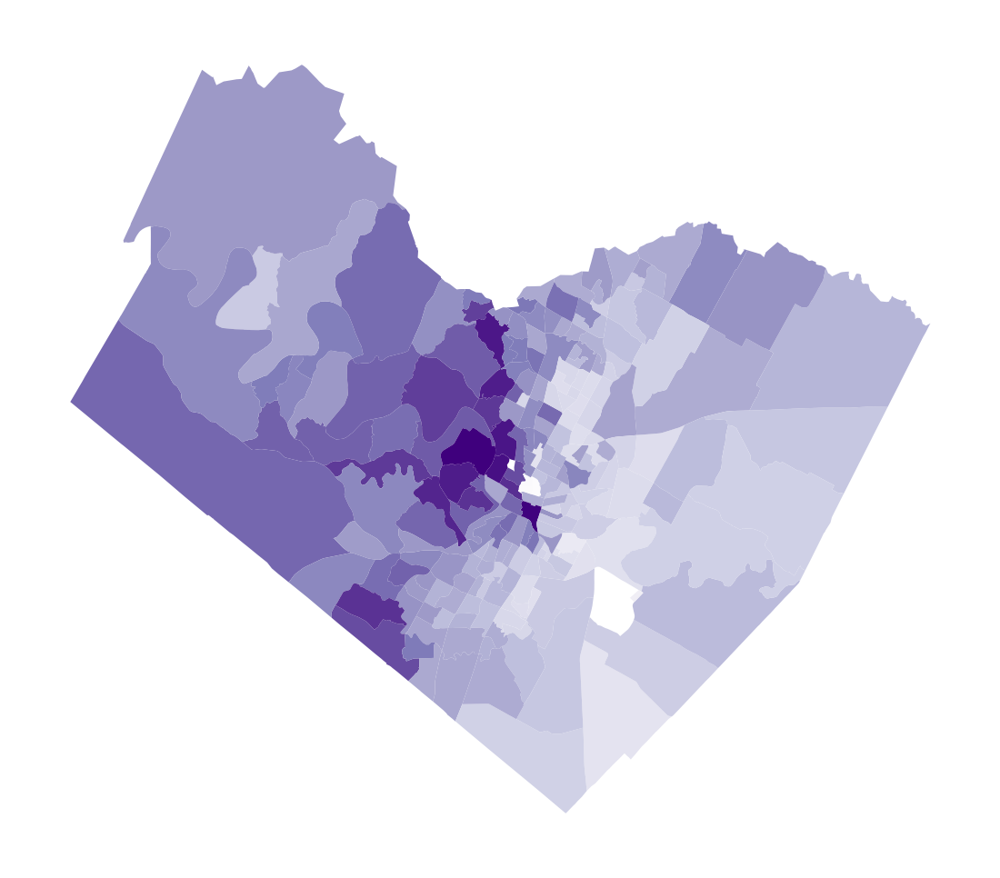

In [ ]:
tract_features.plot(
    column='median income',
    edgecolor='none',
    cmap='Purples'
)

plt.axis('off')

In [ ]:
from esda import Geary

In [ ]:
Gearys_queen = []

for y in variables:
    
    y_ = None
    W_ = None
    
    if tract_features[y].notna().all():
        y_ = tract_features[y]
        W_ = W_queen

        
    else:
        y_ = tract_features[y].dropna()        
        W_ = Queen.from_dataframe(
                tract_centroids[tract_centroids['GEOID'].isin(y_.index)],
                ids = 'GEOID',
        )
        W_.transform = 'r'        

    c = esda.Geary(y=y_,w=W_).C
    Gearys_queen.append((y,c))

<AxesSubplot:ylabel='variable'>

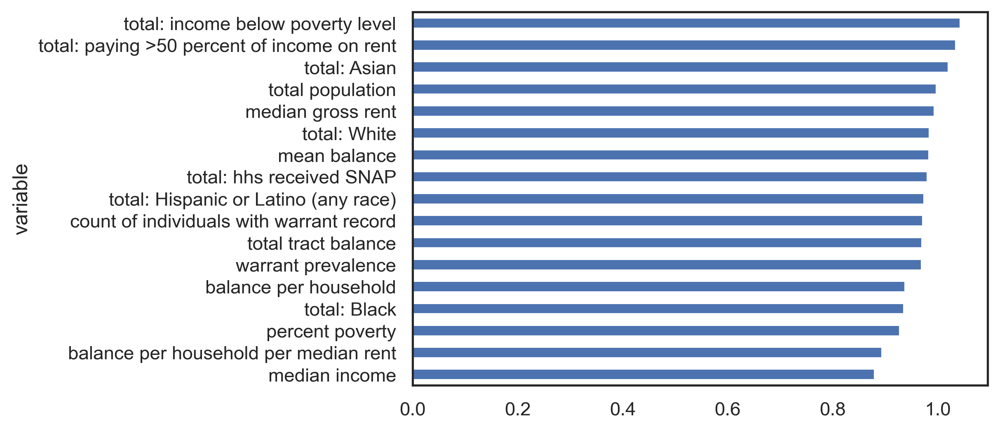

In [ ]:
pd.DataFrame.from_records(
    Gearys_queen, 
    columns=['variable','Gearys c']
    ).set_index('variable'
    ).sort_values(by='Gearys c'
    ).plot.barh(legend=False
    )

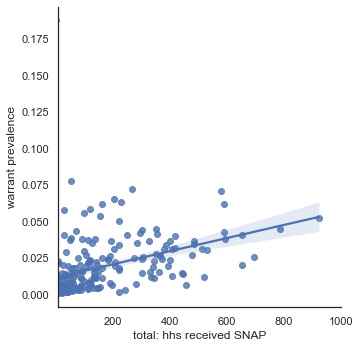

In [ ]:
sns.lmplot(
    data=tract_features,
    x='total: hhs received SNAP',
    y='warrant prevalence'

)

plt.xlim(10,1000);

In [ ]:
## warrants per stop, in every hex 6

In [ ]:
case_info['Type'].value_counts()

Traffic            79927
Crim Misd           8208
City Ordinance      7138
Civil                 81
Parking                8
Higher Charge          6
Civil Red Light        3
Search Warrant         1
Name: Type, dtype: int64

In [ ]:
case_info

,index,Case #,Type,Status,Date Filed,Date Closed
0,NaN,8822364,Traffic,WARRANT,3/12/2020,NaN
1,NaN,8822364,Traffic,WARRANT,3/12/2020,NaN
2,NaN,8822364,Traffic,TERMINATED,12/11/2013,3/13/2018
3,NaN,8822364,Traffic,WARRANT,3/12/2020,NaN
4,NaN,8822364,Traffic,WARRANT,3/12/2020,NaN
...,...,...,...,...,...,...
95367,NaN,8851535,Traffic,JUDGE TO SIGN,5/8/2021,NaN
95368,NaN,8851542,Traffic,JUDGE TO SIGN,5/8/2021,NaN
95369,NaN,8851543,Traffic,WARRANT,5/8/2021,NaN
95370,NaN,8851551,Traffic,WARRANT,5/8/2021,NaN


In [ ]:
ids

,ID,Name,GEOID,Case #,Citation,Date Ticket Issued,Time,Latest Action,Balance Due,Status,geometry,Type
0,913064,"Abbott, Randall R",48453001774,8082522,ALCOHOL AT PARK,4/30/2014,04:14:00,Issued,456.3,WARRANT,POINT (-97.84550 30.15781),City Ordinance
1,2137171,"Acosta, Jose",48453001774,8638021,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,11/6/2017,12:20:00,Issued,514.8,WARRANT,POINT (-97.84166 30.15631),Traffic
2,2137171,"Acosta, Jose",48453001774,8638022,NO DRIVERS LICENSE,11/6/2017,12:20:00,Issued,292.5,WARRANT,POINT (-97.84166 30.15631),Traffic
3,2137171,"Acosta, Jose",48453001774,8638023,SPEEDING - STATE HIGHWAY - LESS THAN 10% OVER ...,11/6/2017,12:20:00,Issued,280.8,WARRANT,POINT (-97.84166 30.15631),Traffic
4,2153515,"Aguilar-Garcia, Jessica",48453001774,8820781,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,2/27/2020,04:07:00,Issued,514.1,WARRANT,POINT (-97.83633 30.15367),Traffic
...,...,...,...,...,...,...,...,...,...,...,...,...
74523,2243277,"Martinez, Richard",48453001919,8745028,ELECTRONIC DEVICE USE WHILE DRIVING,2/7/2019,08:22:00,Issued,448.5,WARRANT,POINT (-97.78762 30.27831),City Ordinance
74524,2243277,"Martinez, Richard",48453001919,8745029,NO DRIVERS LICENSE,2/7/2019,08:22:00,Issued,292.5,WARRANT,POINT (-97.78762 30.27831),Traffic
74525,1787280,"Gutierres, Maria",48453001918,8231835,ELECTRONIC DEVICE USE WHILE DRIVING,2/10/2015,10:05:00,Issued,448.5,WARRANT,POINT (-97.81685 30.29616),City Ordinance
74526,1787280,"Gutierres, Maria",48453001918,8231836,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,2/10/2015,10:05:00,Issued,514.8,WARRANT,POINT (-97.81685 30.29616),Traffic


In [ ]:
most_frequent_type = pd.DataFrame.from_records(
    ids.groupby('GEOID')['Type'].value_counts(       # count records by citation type by tract
        ).groupby('GEOID').idxmax().values,          # get (tract, type) of citation with highest count
    columns=['GEOID', 'most frequent type']).set_index('GEOID')     # put those tuples in a frame

In [ ]:
most_frequent_type['most frequent type'].value_counts()

Traffic           214
City Ordinance      2
Crim Misd           2
Name: most frequent type, dtype: int64

In [ ]:
ids['Type']

0        City Ordinance
1               Traffic
2               Traffic
3               Traffic
4               Traffic
              ...      
74523    City Ordinance
74524           Traffic
74525    City Ordinance
74526           Traffic
74527           Traffic
Name: Type, Length: 33416, dtype: object

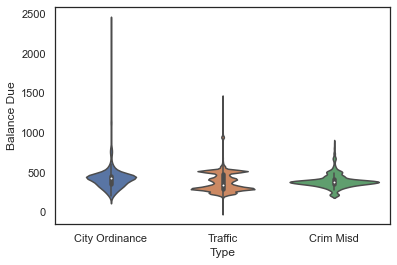

In [ ]:
sns.violinplot(
    data=ids[ids['Type'].isin(['City Ordinance', 'Traffic', 'Crim Misd'])],
    x='Type',
    y='Balance Due',
);

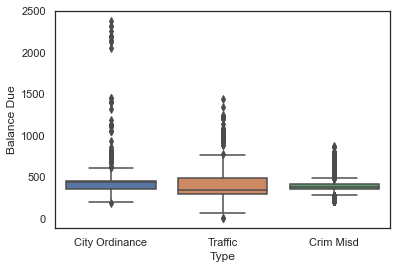

In [ ]:
sns.boxplot(
    data=ids[ids['Type'].isin(['City Ordinance', 'Traffic', 'Crim Misd'])],
    x='Type',
    y='Balance Due',
);

In [ ]:
ids.columns

Index(['ID', 'Name', 'GEOID', 'Case #', 'Citation', 'Date Ticket Issued',
       'Time', 'Latest Action', 'Balance Due', 'Status', 'geometry', 'Type'],
      dtype='object')

In [ ]:
ids['Status'].value_counts()

WARRANT    33416
Name: Status, dtype: int64

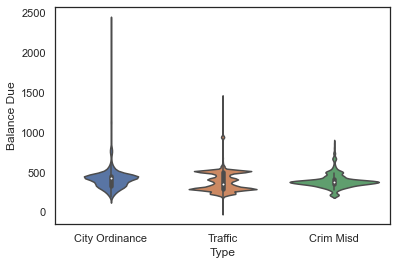

In [ ]:
sns.violinplot(
    data=ids_warrant[ids_warrant['Type'].isin(['City Ordinance', 'Traffic', 'Crim Misd'])],
    x='Type',
    y='Balance Due',
    split=True
);

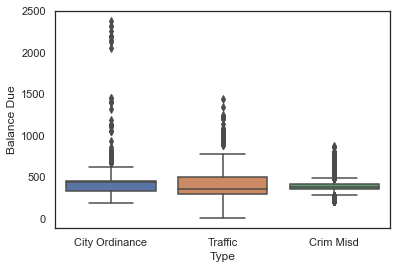

In [ ]:
sns.boxplot(
    data=ids_warrant[ids_warrant['Type'].isin(['City Ordinance', 'Traffic', 'Crim Misd'])],
    x='Type',
    y='Balance Due',
);

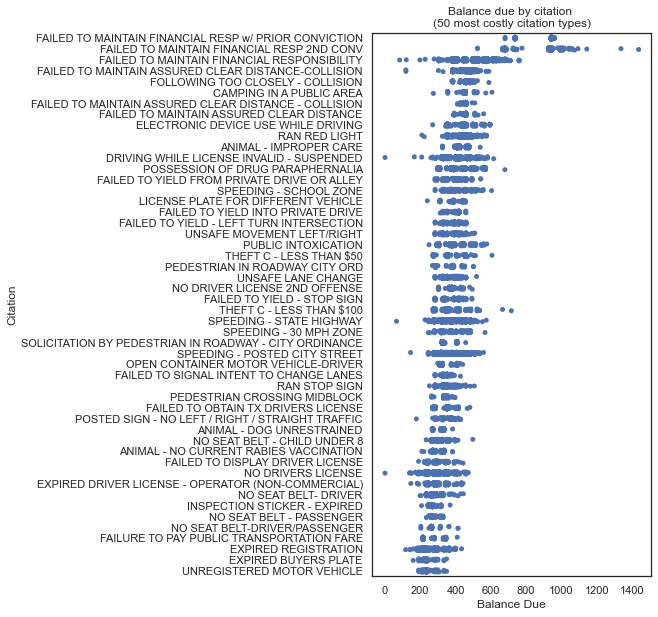

In [ ]:
fig,ax= plt.subplots(figsize=(5,10))

sns.stripplot(
    data=ids_warrant[ids_warrant['Citation'].isin(ids_warrant['Citation'].value_counts().index[:50])],
    y='Citation',
    x='Balance Due',
    order=ids_warrant[ids_warrant['Citation'].isin(ids_warrant['Citation'].value_counts().index[:50])].groupby('Citation')['Balance Due'].mean().sort_values(ascending=False).index,
    orient='h',
    ax=ax,
    color='C0'

);

plt.title('Balance due by citation \n(50 most costly citation types)');

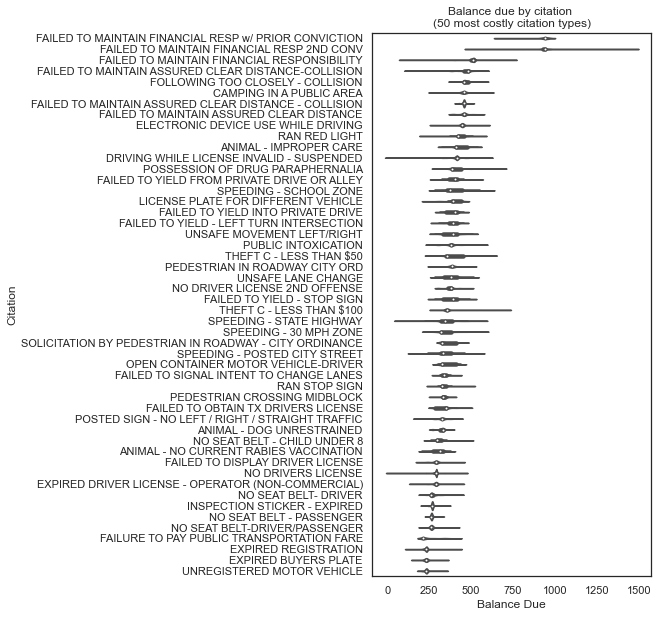

In [ ]:
fig,ax= plt.subplots(figsize=(5,10))

sns.violinplot(
    data=ids_warrant[ids_warrant['Citation'].isin(ids_warrant['Citation'].value_counts().index[:50])],
    y='Citation',
    x='Balance Due',
    order=ids_warrant[ids_warrant['Citation'].isin(ids_warrant['Citation'].value_counts().index[:50])].groupby('Citation')['Balance Due'].mean().sort_values(ascending=False).index,
    orient='h',
    ax=ax,
    color='C0',
    whis=1
    

);

plt.title('Balance due by citation \n(50 most costly citation types)');

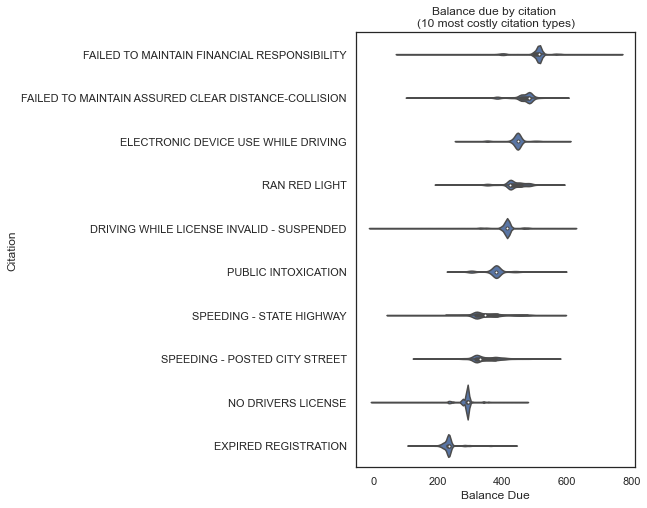

In [ ]:
fig,ax= plt.subplots(figsize=(5,8))

sns.violinplot(
    data=ids_warrant[ids_warrant['Citation'].isin(ids_warrant['Citation'].value_counts().index[:10])],
    y='Citation',
    x='Balance Due',
    order=ids_warrant[ids_warrant['Citation'].isin(ids_warrant['Citation'].value_counts().index[:10])].groupby('Citation')['Balance Due'].mean().sort_values(ascending=False).index,
    orient='h',
    ax=ax,
    color='C0',
    whis=1
    

);

plt.title('Balance due by citation \n(10 most costly citation types)');

In [ ]:
def categorical_kde_plot(
    df,
    variable,
    category,
    category_order=None,
    horizontal=False,
    rug=True,
    figsize=None,
    color='lightslategray',
    bw_adjust=0.5
):
    """Draw a categorical KDE plot

    Parameters
    ----------
    df: pd.DataFrame
        The data to plot
    variable: str
        The column in the `df` to plot (continuous variable)
    category: str
        The column in the `df` to use for grouping (categorical variable)
    horizontal: bool
        If True, draw density plots horizontally. Otherwise, draw them
        vertically.
    rug: bool
        If True, add also a sns.rugplot.
    figsize: tuple or None
        If None, use default figsize of (7, 1*len(categories))
        If tuple, use that figsize. Given to plt.subplots as an argument.
    """
    if category_order is None:
        categories = list(df[category].unique())
    else:
        categories = category_order[:]

    figsize = (7, 1.0 * len(categories))

    fig, axes = plt.subplots(
        nrows=len(categories) if horizontal else 1,
        ncols=1 if horizontal else len(categories),
        figsize=figsize[::-1] if not horizontal else figsize,
        sharex=horizontal,
        sharey=not horizontal,
    )

    for i, (cat, ax) in enumerate(zip(categories, axes)):
        sns.kdeplot(
            data=df[df[category] == cat],
            x=variable if horizontal else None,
            y=None if horizontal else variable,
            # kde kwargs
            bw_adjust=bw_adjust,
            clip_on=False,
            fill=True,
            alpha=1,
            linewidth=1.5,
            ax=ax,
            color=color,
        )

        keep_variable_axis = (i == len(fig.axes) - 1) if horizontal else (i == 0)

        if rug:
            sns.rugplot(
                data=df[df[category] == cat],
                x=variable if horizontal else None,
                y=None if horizontal else variable,
                ax=ax,
                color="black",
                height=0.025 if keep_variable_axis else 0.04,
            )

        _format_axis(
            ax,
            cat,
            horizontal,
            keep_variable_axis=keep_variable_axis,
        )

    plt.tight_layout()
    plt.show()
    
    return fig,axes


def _format_axis(ax, category, horizontal=False, keep_variable_axis=True):

    # Remove the axis lines
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)

    if horizontal:
        ax.set_ylabel(None)
        lim = ax.get_ylim()
        ax.set_yticks([(lim[0] + lim[1]) / 2])
        ax.set_yticklabels([category])
        if not keep_variable_axis:
            ax.get_xaxis().set_visible(False)
            ax.spines["bottom"].set_visible(False)
    else:
        ax.set_xlabel(None)
        lim = ax.get_xlim()
        ax.set_xticks([(lim[0] + lim[1]) / 2])
        ax.set_xticklabels([category])
        if not keep_variable_axis:
            ax.get_yaxis().set_visible(False)
            ax.spines["left"].set_visible(False)
            

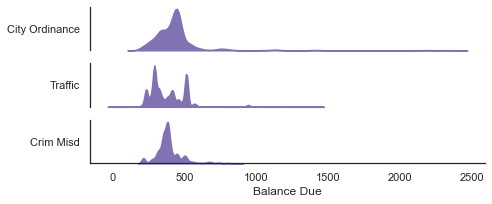

In [ ]:
fig, ax = categorical_kde_plot(
    df=ids,
    variable='Balance Due',
    category='Type',
    rug=False,
    horizontal=True,
    color='C4',
    bw_adjust=.7
)


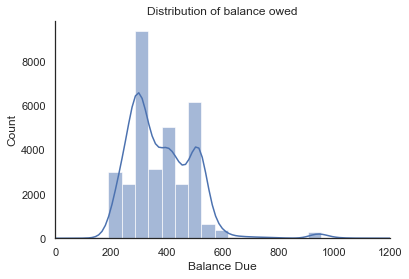

In [ ]:
sns.histplot(
    data=ids,
    x='Balance Due',
    bins=50,
    kde=True,
    kde_kws={'bw_adjust':2}
)

plt.xlim(0,1200)
plt.title('Distribution of balance owed')
sns.despine()

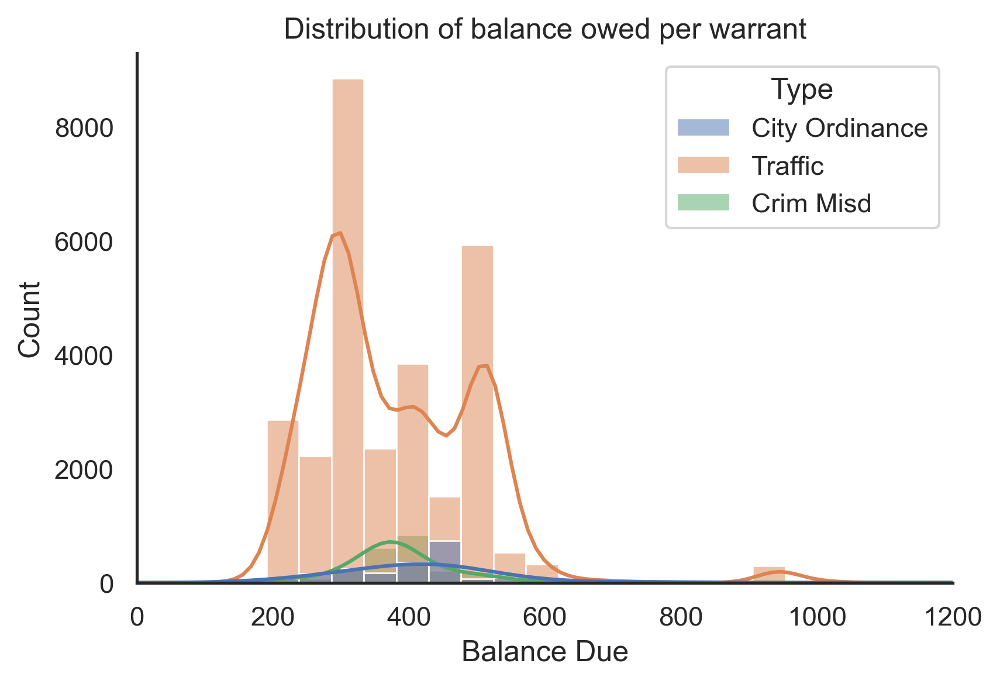

In [ ]:
sns.histplot(
    data=ids,
    x='Balance Due',
    bins=50,
    hue='Type',
    hue_order=['City Ordinance', 'Traffic', 'Crim Misd'],
    kde=True,
    kde_kws={'bw_adjust':2},


)

plt.xlim(0,1200)
plt.title('Distribution of balance owed per warrant')


sns.despine()

In [ ]:
ids.Type.unique()

array(['City Ordinance', 'Traffic', 'Crim Misd'], dtype=object)

In [ ]:
ids.groupby('ID').agg({'Balance Due':'sum', 'Type':'min'})

,Balance Due,Type
ID,,
188,848.20,Traffic
718,650.00,Traffic
1417,219.00,Traffic
1427,607.10,Traffic
1654,807.30,Traffic
...,...,...
2322383,2362.70,Traffic
2322733,407.00,Traffic
2322855,928.07,Traffic


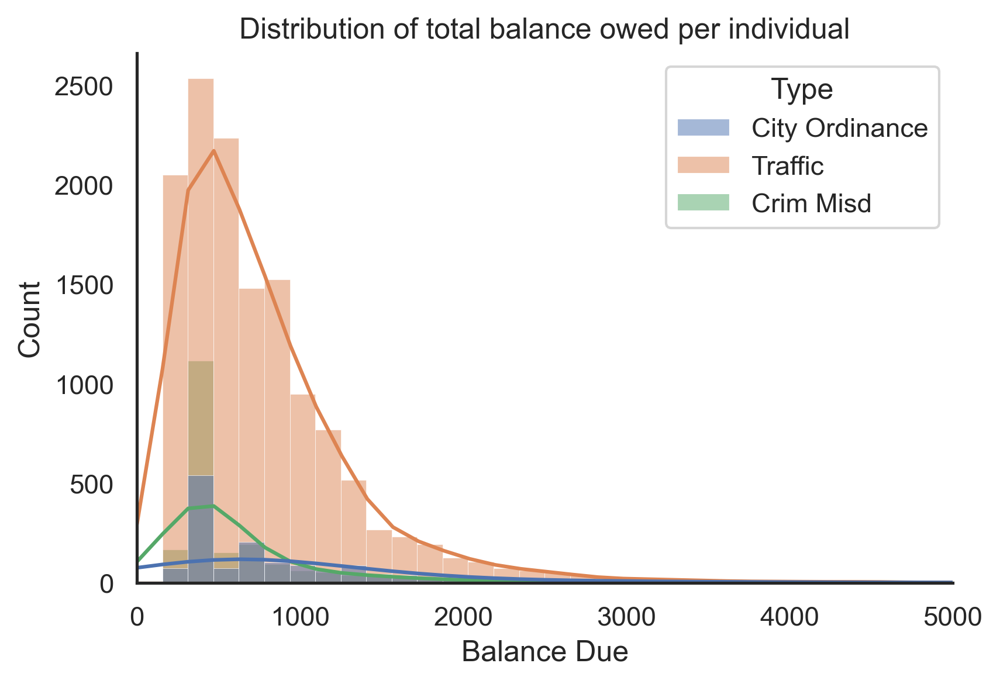

In [ ]:
sns.histplot(
    data=ids.groupby('ID').agg({'Balance Due':'sum', 'Type':'min'}),
    x='Balance Due',
    bins=200,
    hue='Type',
    kde=True,
    kde_kws={'bw_adjust':2},
    hue_order=['City Ordinance', 'Traffic', 'Crim Misd']
)

plt.xlim(0,5000)
plt.title('Distribution of total balance owed per individual')


sns.despine()

In [ ]:
ids.groupby('ID')['Name'].count().mean()

1.9866825208085612

In [ ]:
ids.groupby('ID')['Name'].count().mean()

1.9866825208085612

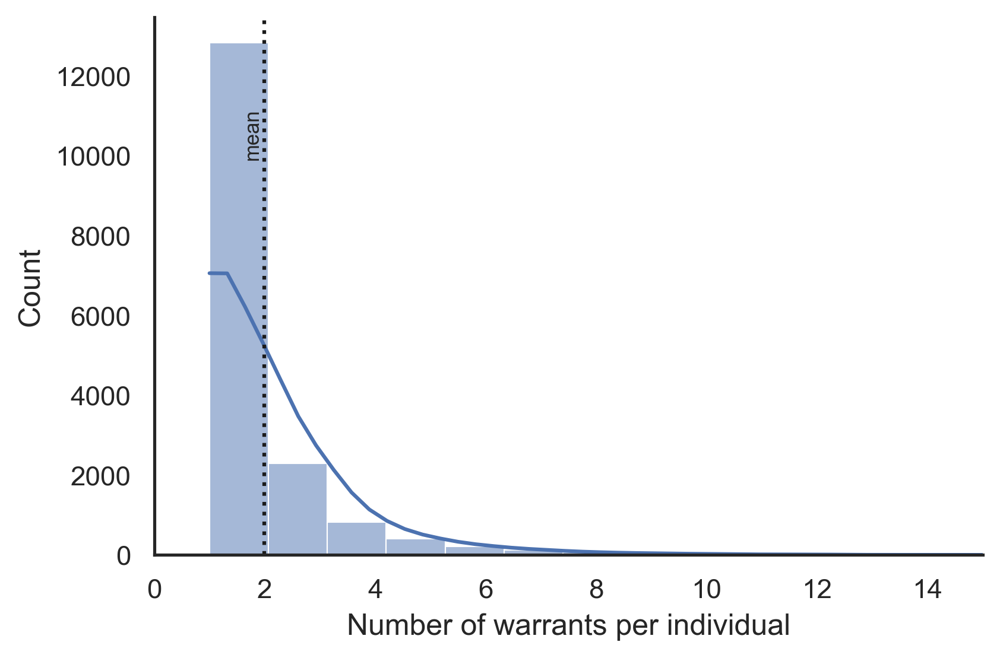

In [ ]:
fig,ax = plt.subplots()

sns.histplot(
    data=ids.groupby('ID')['Name'].count(),
    bins=60,
    kde=True,
    kde_kws={'bw_adjust':2.5},
    ax=ax,


)

ax.axvline(ids.groupby('ID')['Name'].count().mean(), 0, 1, c='k', ls=':')
ax.annotate('mean',(1.6,10000), rotation='vertical', size='x-small')

plt.xlim(0,15)

plt.xlabel('Number of warrants per individual')
sns.despine()

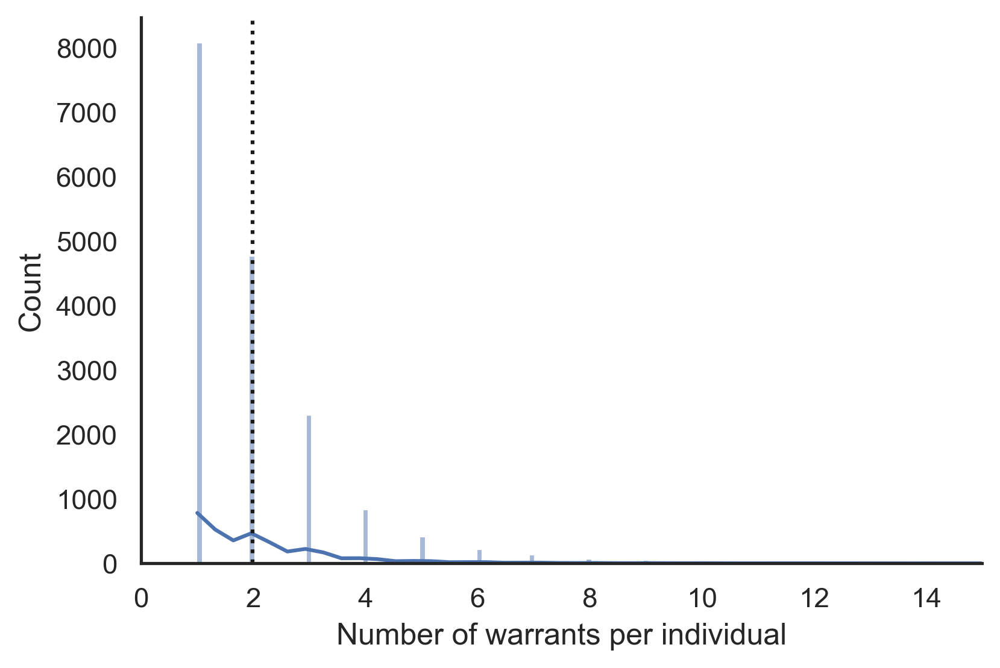

In [ ]:
fig,ax = plt.subplots()

sns.histplot(
    data=ids.groupby('ID')['Name'].count(),
    kde=True,
    kde_kws={'bw_adjust':1.5},
    ax=ax,


)

ax.axvline(ids.groupby('ID')['Name'].count().mean(), 0, 1, c='k', ls=':')
ax.annotate('mean',(1.6,10000), rotation='vertical', size='x-small')

plt.xlim(0,15)

plt.xlabel('Number of warrants per individual')
sns.despine()

In [ ]:
ids.groupby('ID')['Name'].count().value_counts()

1     8063
2     4756
3     2292
4      821
5      401
6      211
7      120
8       61
9       38
10      24
11      11
12      11
14       3
18       2
27       1
20       1
29       1
13       1
65       1
15       1
Name: Name, dtype: int64

In [ ]:
ids.groupby('ID')['Name'].count()

ID
188        2
718        2
1417       1
1427       2
1654       2
          ..
2322383    6
2322733    1
2322855    2
2323873    1
2324817    2
Name: Name, Length: 16820, dtype: int64

In [ ]:
ids['ID'].value_counts().value_counts() / len(ids['ID'].value_counts())

1     0.479370
2     0.282759
3     0.136266
4     0.048811
5     0.023841
6     0.012545
7     0.007134
8     0.003627
9     0.002259
10    0.001427
11    0.000654
12    0.000654
14    0.000178
18    0.000119
29    0.000059
13    0.000059
15    0.000059
20    0.000059
27    0.000059
65    0.000059
Name: ID, dtype: float64

In [ ]:
case_info[case_info['Status'] == 'WARRANT'].drop_duplicates()

,index,Case #,Type,Status,Date Filed,Date Closed
0,NaN,8822364,Traffic,WARRANT,3/12/2020,NaN
12,NaN,8822364,Traffic,WARRANT,12/12/2013,NaN
13,NaN,8822364,Traffic,WARRANT,3/26/2019,NaN
14,NaN,8822364,Traffic,WARRANT,10/4/2020,NaN
15,NaN,8822364,Traffic,WARRANT,6/30/2016,NaN
...,...,...,...,...,...,...
95245,NaN,8851436,Traffic,WARRANT,5/6/2021,NaN
95247,NaN,8851453,Traffic,WARRANT,5/6/2021,NaN
95248,NaN,8851456,Traffic,WARRANT,5/6/2021,NaN
95249,NaN,8851465,Traffic,WARRANT,5/6/2021,NaN


In [ ]:
acs.filter_tables('TOTAL', by='description')

,description,columns
table_name,,
B01003,TOTAL POPULATION,[B01003_001E]
B15012,TOTAL FIELDS OF BACHELOR'S DEGREES REPORTED,"[B15012_001E, B15012_002E, B15012_003E, B15012..."
B25008,TOTAL POPULATION IN OCCUPIED HOUSING UNITS BY ...,"[B25008_001E, B25008_002E, B25008_003E]"
B25026,TOTAL POPULATION IN OCCUPIED HOUSING UNITS BY ...,"[B25026_001E, B25026_002E, B25026_003E, B25026..."
B25033,TOTAL POPULATION IN OCCUPIED HOUSING UNITS BY ...,"[B25033_001E, B25033_002E, B25033_003E, B25033..."
B98003,UNWEIGHTED TOTAL POPULATION SAMPLE,[B98003_001E]
B98012,TOTAL POPULATION COVERAGE RATE BY SEX,"[B98012_001E, B98012_002E, B98012_003E]"
B98013,TOTAL POPULATION COVERAGE RATE BY WEIGHTING RA...,"[B98013_001E, B98013_002E, B98013_003E, B98013..."


In [ ]:
acs.filter_variables('B01003')

,label,concept,predicateType,group,limit,predicateOnly,hasGeoCollectionSupport,attributes,required
B01003_001E,Estimate!!Total,TOTAL POPULATION,int,B01003,0,NaN,NaN,"B01003_001EA,B01003_001M,B01003_001MA",NaN


In [ ]:
austin_pop = acs.from_place(
    'Austin, TX',
    variables='B01003_001E',
    return_geometry=False
    
)

Matched: Austin, TX to Austin city within layer Incorporated Places


In [ ]:
austin_total_pop = austin_pop['B01003_001E'].sum()

In [ ]:
austin_total_pop

611935.0

In [ ]:
## nah that's wrong. just use the 2020 Census number  https://data.census.gov/cedsci/all?q=population%20of%20austin%20tx

In [ ]:
austin_total_pop = 961855

In [ ]:
total_warrants = case_info[case_info['Status'] == 'WARRANT'].drop_duplicates().shape[0]

In [ ]:
warrants_per_total_pop = total_warrants / austin_total_pop

In [ ]:
warrants_per_total_pop

0.060672346663478385

In [ ]:
ids['ID'].nunique()

16820

In [ ]:
individuals_with_warrants_per_total_pop = ids['ID'].nunique() / austin_total_pop

In [ ]:
individuals_with_warrants_per_total_pop

0.017487043265357046

In [ ]:
ids['ID'].nunique() / case_info[case_info['Status'] == 'WARRANT'].drop_duplicates().shape[0]

0.2882209808423866

In [ ]:
# multiply warrants per total pop by this multiplier to get individuals with warrants per total pop

warrants_to_individuals_with_warrants_ratio = ids['ID'].nunique() / case_info[case_info['Status'] == 'WARRANT'].drop_duplicates().shape[0]

Text(0.5, 1.0, 'Austin')

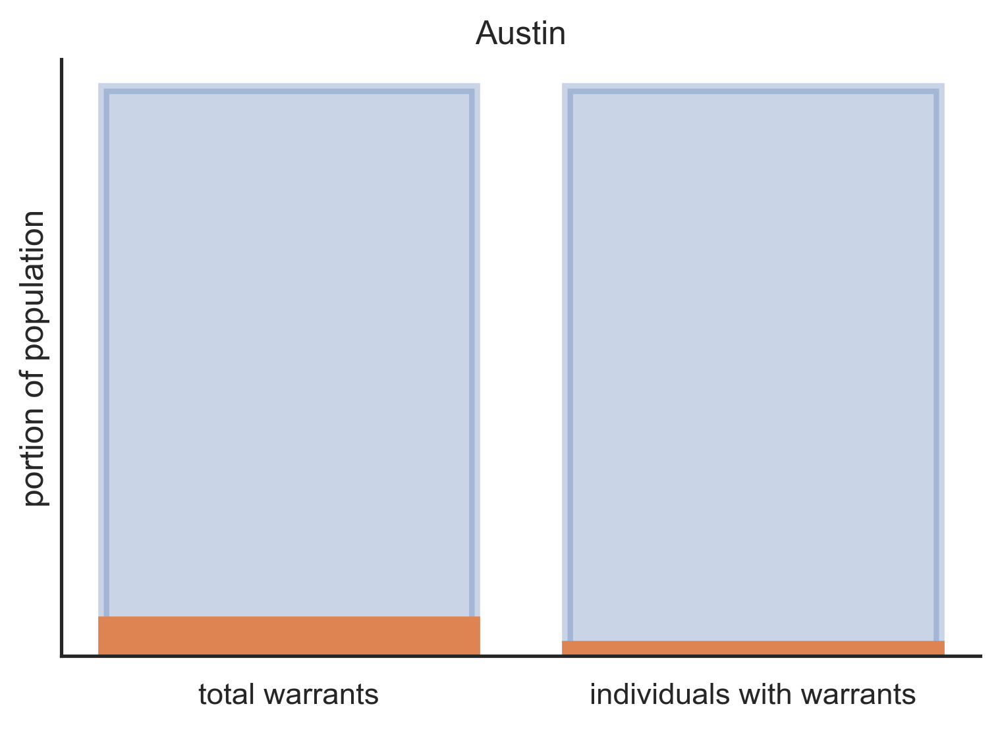

In [ ]:
fig, ax = plt.subplots()

ax.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[austin_total_pop,austin_total_pop],
    edgecolor='C0',
    alpha=0.3,
    linewidth=4
)

ax.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[total_warrants, ids['ID'].nunique()],
    color='C1',
    edgecolor='C1',
    linewidth=4
)

plt.ylabel('portion of population')
plt.ticklabel_format(axis="y", style="plain")

plt.yticks([])
sns.despine()

plt.title('Austin')

Text(0.5, 1.0, 'Austin')

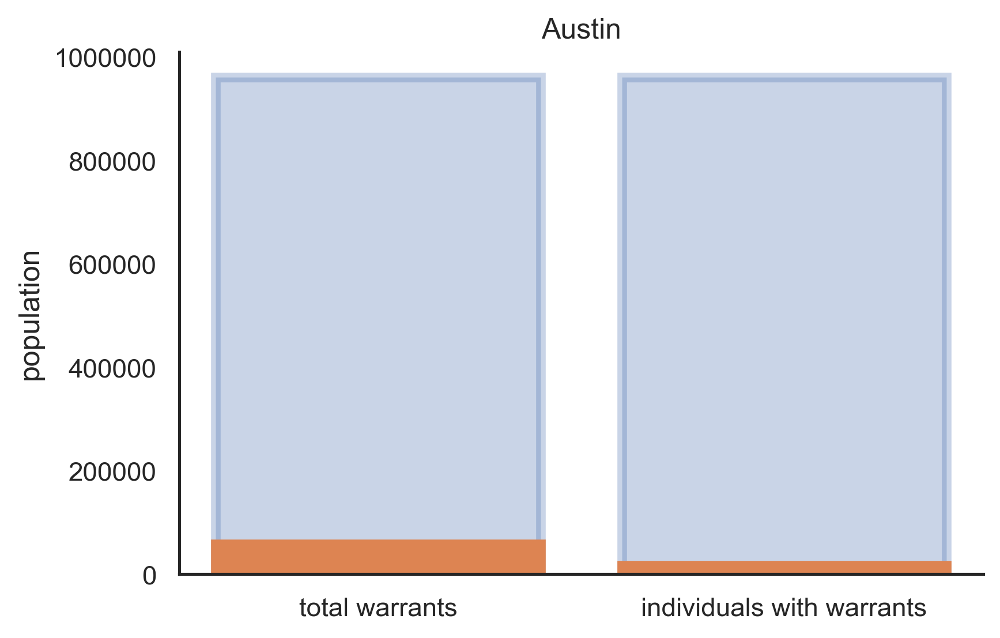

In [ ]:
fig, ax = plt.subplots()

ax.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[austin_total_pop,austin_total_pop],
    edgecolor='C0',
    alpha=0.3,
    linewidth=4
)

ax.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[total_warrants, ids['ID'].nunique()],
    color='C1',
    edgecolor='C1',
    linewidth=4
)

plt.ylabel('population')
plt.ticklabel_format(axis="y", style="plain")


sns.despine()

plt.title('Austin')

In [ ]:
stlouis_total_pop = 308174

In [ ]:
stlouis_total_pop * .99 * warrants_to_individuals_with_warrants_ratio / stlouis_total_pop

0.24202902772541898

Text(0.5, 1.0, 'St. Louis (modeled)')

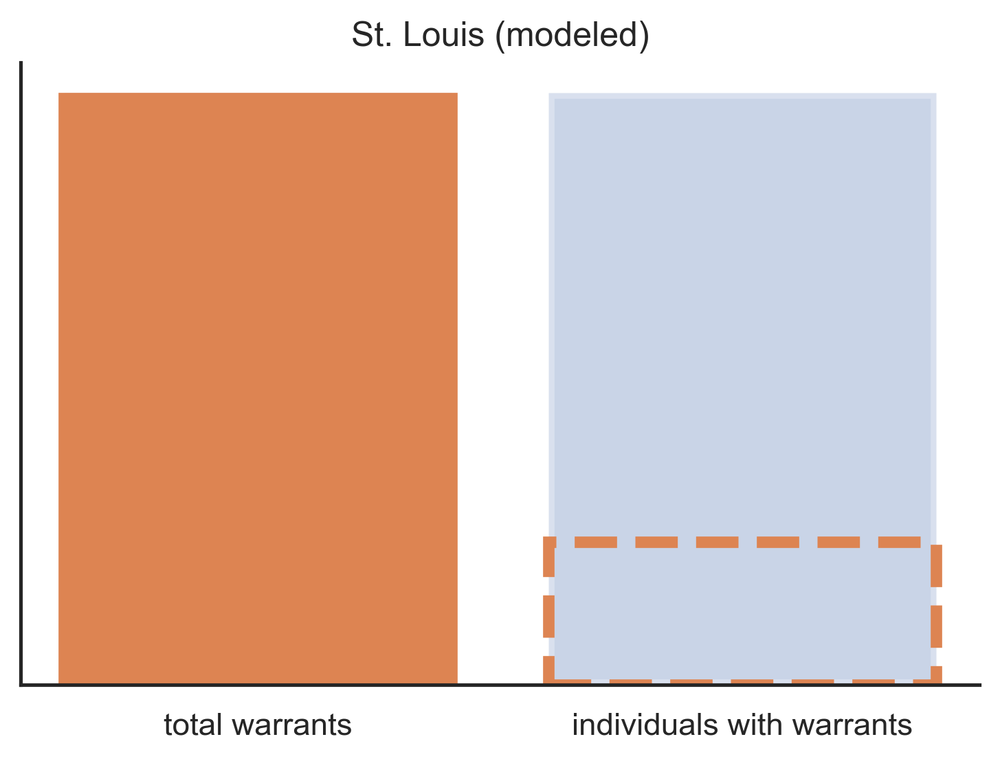

In [ ]:
fig, ax = plt.subplots()

ax.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[stlouis_total_pop,stlouis_total_pop],
    edgecolor='C0',
    alpha=0.3,
    linewidth=4
    
)

ax.bar(
    x='total warrants',
    height=stlouis_total_pop * .99,
    color='C1',
    edgecolor='C1',
    linewidth=4,
)

ax.bar(
    x='individuals with warrants',
    height=stlouis_total_pop * .99 * warrants_to_individuals_with_warrants_ratio,
    color='none',
    edgecolor='C1',
    linewidth=4,
    ls='--'
)

plt.ylabel('population')
plt.yticks([])
ax.get_yaxis().set_visible(False)

sns.despine()

plt.title('St. Louis (modeled)')



Text(0.5, 1.0, 'St. Louis (modeled)')

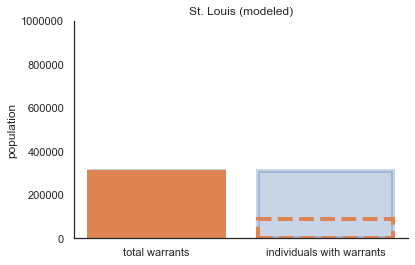

In [ ]:
fig, ax = plt.subplots()

ax.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[stlouis_total_pop,stlouis_total_pop],
    edgecolor='C0',
    alpha=0.3,
    linewidth=4
    
)

ax.bar(
    x='total warrants',
    height=stlouis_total_pop * .99,
    color='C1',
    edgecolor='C1',
    linewidth=4,
)

ax.bar(
    x='individuals with warrants',
    height=stlouis_total_pop * .99 * warrants_to_individuals_with_warrants_ratio,
    color='none',
    edgecolor='C1',
    linewidth=4,
    ls='--'
)

plt.ylabel('population')
plt.ylim(0,1000000)
plt.ticklabel_format(axis="y", style="plain")



sns.despine()

plt.title('St. Louis (modeled)')




Text(0.5, 1.0, 'St. Louis (modeled)')

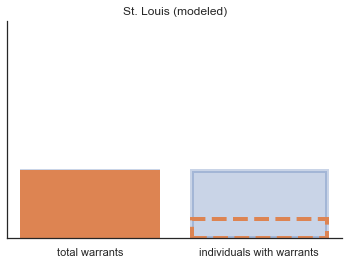

In [ ]:
fig, ax = plt.subplots()

ax.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[stlouis_total_pop,stlouis_total_pop],
    edgecolor='C0',
    alpha=0.3,
    linewidth=4
    
)

ax.bar(
    x='total warrants',
    height=stlouis_total_pop * .99,
    color='C1',
    edgecolor='C1',
    linewidth=4,
)

ax.bar(
    x='individuals with warrants',
    height=stlouis_total_pop * .99 * warrants_to_individuals_with_warrants_ratio,
    color='none',
    edgecolor='C1',
    linewidth=4,
    ls='--'
)

plt.ylabel('population')
plt.ylim(0,1000000)
plt.ticklabel_format(axis="y", style="plain")
ax.get_yaxis().set_visible(False)


sns.despine()

plt.title('St. Louis (modeled)')





In [ ]:
## the tract that has the highest prevalence, how much is it as a multiple of the mean rate?n

In [ ]:
tract_features.columns

Index(['total population', '[denominator: total population for Race]',
       'total: White', 'total: Black', 'total: Asian',
       '[denominator: total population for Hispanic or Latino]',
       'total: Hispanic or Latino (any race)',
       '[denominator: total population for poverty]',
       'total: income below poverty level', 'median gross rent',
       '[denominator: total population for income on rent]',
       'total: paying >50 percent of income on rent', 'NAME', 'state',
       'county', 'tract', 'count of individuals with warrant record',
       'warrant prevalence', 'geometry', 'total tract balance',
       'percent poverty', 'mean balance', 'median income',
       'most frequent citation', 'most costly citation', 'total: households',
       'total: hhs received SNAP', 'balance per household',
       'balance per household per median rent'],
      dtype='object')

In [ ]:
tract_features['warrant prevalence'].max()

0.1875

In [ ]:
tract_features.loc[tract_features['warrant prevalence'].idxmax()]

total population                                                                                       16.0
[denominator: total population for Race]                                                               16.0
total: White                                                                                           10.0
total: Black                                                                                            3.0
total: Asian                                                                                            0.0
[denominator: total population for Hispanic or Latino]                                                 16.0
total: Hispanic or Latino (any race)                                                                    5.0
[denominator: total population for poverty]                                                            16.0
total: income below poverty level                                                                      10.0
median gross rent           

In [ ]:
max_prevalence = tract_features[tract_features['total population'] > 200]['warrant prevalence'].max()

In [ ]:
max_prevalence

0.07722911303533816

In [ ]:
individuals_with_warrants_per_total_pop

0.017487043265357046

In [ ]:
max_prevalence / individuals_with_warrants_per_total_pop

4.416361980892104

In [ ]:
# st louis mean

(stlouis_total_pop * .99 * warrants_to_individuals_with_warrants_ratio) / stlouis_total_pop

0.28533877103396277

In [ ]:
# st. louis total pop * multiplier

# 126% --- so..

((stlouis_total_pop * .99 * warrants_to_individuals_with_warrants_ratio) / stlouis_total_pop) * (max_prevalence / individuals_with_warrants_per_total_pop)

1.2601593000688702

In [ ]:
# how about measured in standard deviations

In [ ]:
tract_features[tract_features['total population'] > 200]['warrant prevalence'].describe()

count    216.000000
mean       0.017694
std        0.016361
min        0.000395
25%        0.004883
50%        0.012189
75%        0.025341
max        0.077229
Name: warrant prevalence, dtype: float64

In [ ]:
# max prevalence is 3.6 std above mean
(max_prevalence - tract_features[tract_features['total population'] > 200]['warrant prevalence'].mean())/tract_features[tract_features['total population'] > 200]['warrant prevalence'].std()

3.638878277890422

$$z = (x - \mu) / \sigma$$

3.63 = (0.077 - 0.018) / 0.016

$$3.6 = (x - \mu_{stl}) / \sigma_{stl}$$ 
$$3.6 * \sigma_{stl} = x - \mu_{stl}$$
$$3.6 * \sigma_{stl} + \mu_{stl} = x$$

assume $\sigma_{stl}$ = scaled $\sigma_{austin}$ = 

$$\sigma_{austin} * \frac{\mu_{stl}}{\mu_{austin}}$$

In [ ]:
mu_stl = ((stlouis_total_pop * .99 * warrants_to_individuals_with_warrants_ratio) / stlouis_total_pop)
mu_austin = individuals_with_warrants_per_total_pop
sigma_austin = tract_features[tract_features['total population'] > 200]['warrant prevalence'].std()

In [ ]:
sigma_stl = sigma_austin * (mu_stl / mu_austin)

In [ ]:
max_stl = 3.6388 * sigma_stl + mu_stl

In [ ]:
max_stl

# also 125%. 

1.2567657989574024

In [ ]:
austin_pop, austin_bound = acs.from_place(
    'Austin, TX',
    variables='B01003_001E',
    return_bounds=True
    
)

/opt/anaconda3/envs/mapper2/lib/python3.7/site-packages/cenpy/geoparser.py:226: UserWarning: Shape is invalid: 
Ring Self-intersection[-10884881.1468 3554135.7868]
  tell_user("Shape is invalid: \n{}".format(vexplain))
/opt/anaconda3/envs/mapper2/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


Matched: Austin, TX to Austin city within layer Incorporated Places


<AxesSubplot:>

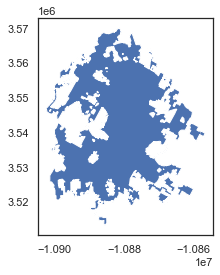

In [ ]:
austin_bound.plot()

<AxesSubplot:>

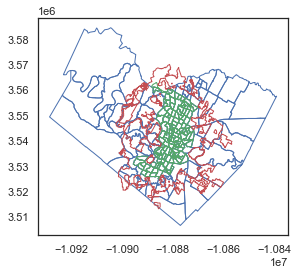

In [ ]:
fig,ax = plt.subplots()

tract_features.to_crs(austin_bound.crs).plot(
    facecolor='none',
    edgecolor='b',
    ax=ax
)

austin_pop.plot(
    facecolor='none',
    edgecolor='g',
    ax=ax
)

austin_bound.plot(
    facecolor='none',
    edgecolor='r',
    ax=ax
    

)

In [ ]:
ids_in_acl = gpd.sjoin(ids.to_crs(austin_bound.crs),austin_bound)

In [ ]:
ids_in_acl['ID'].nunique()

14267

In [ ]:
individuals_with_warrants_acl = ids_in_acl['ID'].nunique()

In [ ]:
individuals_with_warrants_per_total_pop_ = ids_in_acl['ID'].nunique() / austin_total_pop

In [ ]:
# multiply warrants per total pop by this multiplier to get individuals with warrants per total pop

warrants_to_individuals_with_warrants_ratio = ids_in_acl['ID'].nunique() / case_info[case_info['Status'] == 'WARRANT'].drop_duplicates().shape[0]

In [ ]:
warrants_to_individuals_with_warrants_ratio

0.2444737653792111

Text(0.5, 1.0, 'Austin')

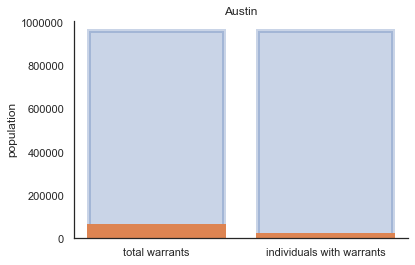

In [ ]:
fig, ax = plt.subplots()

ax.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[austin_total_pop,austin_total_pop],
    edgecolor='C0',
    alpha=0.3,
    linewidth=4
)

ax.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[total_warrants, individuals_with_warrants_acl],
    color='C1',
    edgecolor='C1',
    linewidth=4
)

plt.ylabel('population')
plt.ticklabel_format(axis="y", style="plain")


sns.despine()

plt.title('Austin')

Text(0.5, 1.0, 'Austin')

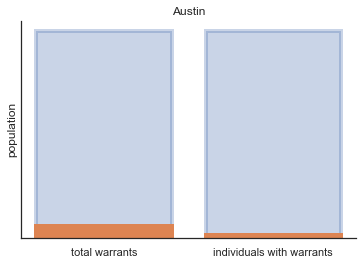

In [ ]:
fig, ax = plt.subplots()

ax.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[austin_total_pop,austin_total_pop],
    edgecolor='C0',
    alpha=0.3,
    linewidth=4
)

ax.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[total_warrants, individuals_with_warrants_acl],
    color='C1',
    edgecolor='C1',
    linewidth=4
)

plt.ylabel('population')
plt.ticklabel_format(axis="y", style="plain")

plt.yticks([])
sns.despine()

plt.title('Austin')

Text(0.5, 1.0, 'St. Louis (modeled)')

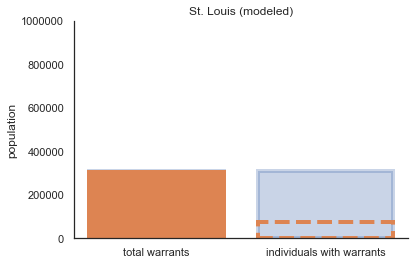

In [ ]:
fig, ax = plt.subplots()

ax.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[stlouis_total_pop,stlouis_total_pop],
    edgecolor='C0',
    alpha=0.3,
    linewidth=4
    
)

ax.bar(
    x='total warrants',
    height=stlouis_total_pop * .99,
    color='C1',
    edgecolor='C1',
    linewidth=4,
)

ax.bar(
    x='individuals with warrants',
    height=stlouis_total_pop * .99 * warrants_to_individuals_with_warrants_ratio,
    color='none',
    edgecolor='C1',
    linewidth=4,
    ls='--'
)

plt.ylabel('population')
plt.ylim(0,1000000)
plt.ticklabel_format(axis="y", style="plain")



sns.despine()

plt.title('St. Louis (modeled)')





Text(0.5, 1.0, 'St. Louis (modeled)')

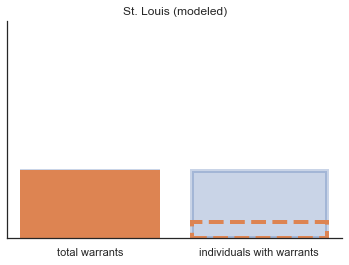

In [ ]:
fig, ax = plt.subplots()

ax.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[stlouis_total_pop,stlouis_total_pop],
    edgecolor='C0',
    alpha=0.3,
    linewidth=4
    
)

ax.bar(
    x='total warrants',
    height=stlouis_total_pop * .99,
    color='C1',
    edgecolor='C1',
    linewidth=4,
)

ax.bar(
    x='individuals with warrants',
    height=stlouis_total_pop * .99 * warrants_to_individuals_with_warrants_ratio,
    color='none',
    edgecolor='C1',
    linewidth=4,
    ls='--'
)

plt.ylabel('population')
plt.ylim(0,1000000)
plt.ticklabel_format(axis="y", style="plain")
ax.get_yaxis().set_visible(False)


sns.despine()

plt.title('St. Louis (modeled)')






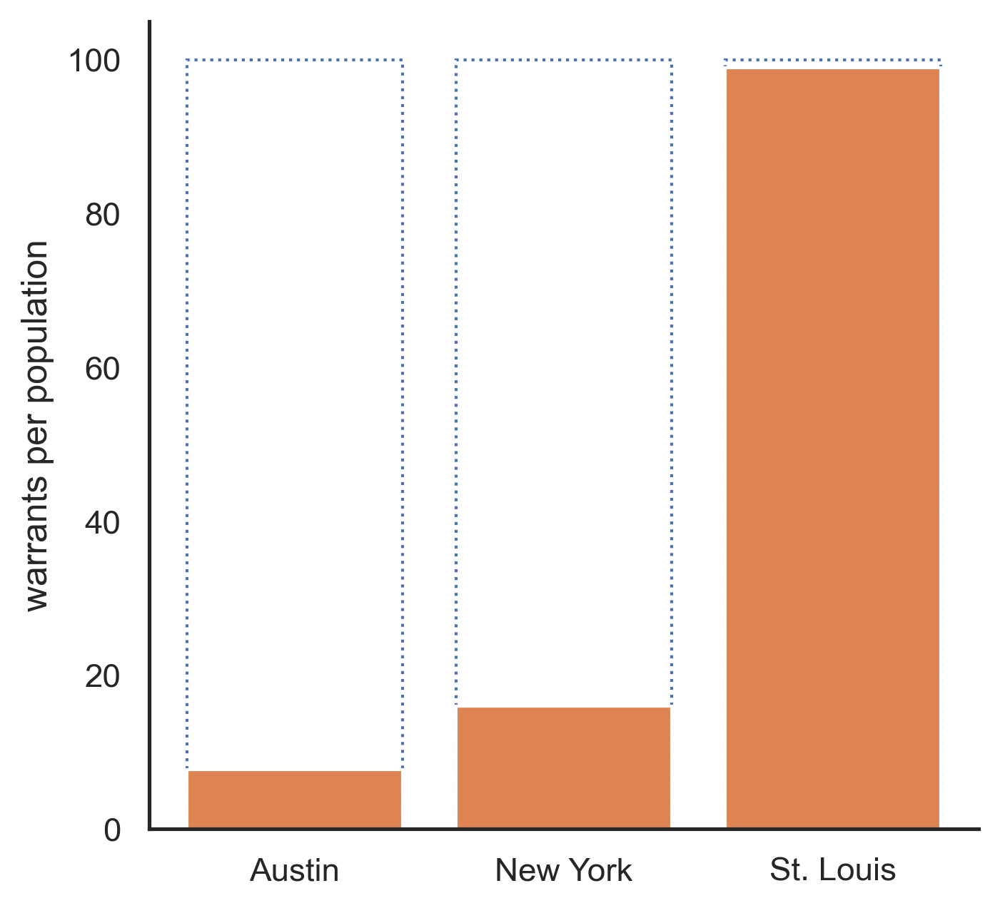

In [ ]:
# warrant prevalence
fig,ax = plt.subplots(figsize=(5,5), dpi=300)

ax.bar(
    x=['Austin','New York', 'St. Louis'],
    height=[100,100,100],
    facecolor='none',
    edgecolor='C0',
    linestyle=':',
)

ax.bar(
    x=['Austin','New York', 'St. Louis'],
    height=[7.7, 16, 99],
    color='C1',
)

ax.set_facecolor('none')
plt.ylabel('warrants per population')
sns.despine()

In [ ]:
## spatially lagged regression for warrant count ~ median income

(15000.0, 90000.0)

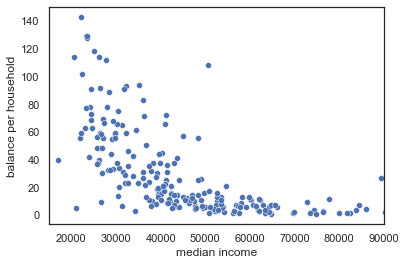

In [ ]:
sns.scatterplot(
    data=tract_features,
    x='median income',
    y='balance per household'

)

plt.xlim(15000,90000)

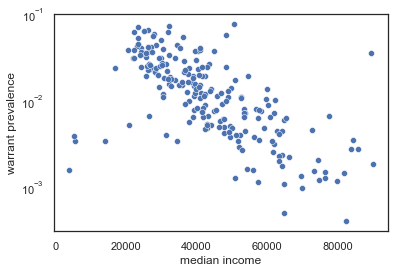

In [ ]:
sns.scatterplot(
    data=tract_features,
    x='median income',
    y='warrant prevalence'

)

plt.yscale('log')

In [ ]:
tract_features['log_prevalence'] = np.log(tract_features['warrant prevalence'])

Text(25.835, 0.5, 'log warrant prevalence')

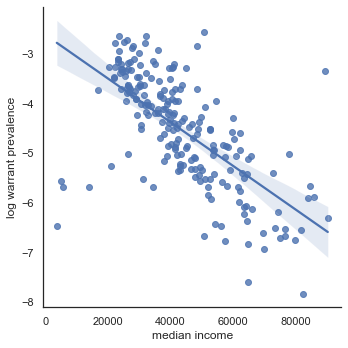

In [ ]:
sns.lmplot(
    data=tract_features,
    x='median income',
    y='log_prevalence'

)

plt.ylabel('log warrant prevalence')

In [ ]:
import statsmodels.formula.api as smf

In [ ]:
lm = smf.ols('log_prevalence ~ Q("median income")', data=tract_features).fit()

In [ ]:
lm.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         log_prevalence   R-squared:                       0.436
Model:                            OLS   Adj. R-squared:                  0.433
Method:                 Least Squares   F-statistic:                     165.2
Date:                Thu, 05 May 2022   Prob (F-statistic):           2.16e-28
Time:                        09:34:12   Log-Likelihood:                -265.08
No. Observations:                 216   AIC:                             534.2
Df Residuals:                     214   BIC:                             540.9
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Intercept             -2.6171      0.159    -16.449      0.000      -2.931      -2.303
Q("median income") -4.409e-05   3.43e-06    -12.852      0.000   -5.09e-05   -3.73e-05
==============================================================================
Omnibus:                       35.822   Durbin-Watson:                   1.928
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              105.773
Skew:                          -0.668   Prob(JB):                     1.08e-23
Kurtosis:                       6.157   Cond. No.                     1.31e+05
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.31e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
tract_features.columns

Index(['total population', '[denominator: total population for Race]',
       'total: White', 'total: Black', 'total: Asian',
       '[denominator: total population for Hispanic or Latino]',
       'total: Hispanic or Latino (any race)',
       '[denominator: total population for poverty]',
       'total: income below poverty level', 'median gross rent',
       '[denominator: total population for income on rent]',
       'total: paying >50 percent of income on rent', 'NAME', 'state',
       'county', 'tract', 'count of individuals with warrant record',
       'warrant prevalence', 'geometry', 'total tract balance',
       'percent poverty', 'mean balance', 'median income',
       'most frequent citation', 'most costly citation', 'total: households',
       'total: hhs received SNAP', 'balance per household',
       'balance per household per median rent', 'log_prevalence'],
      dtype='object')

In [ ]:
tract_features['median income'].isna().any()

True

In [ ]:
tract_features['log_prevalence'].isna().any()

True

In [ ]:
tract_features_nonan = tract_features.dropna(subset=['median income','log_prevalence'])

In [ ]:
W = libpysal.weights.DistanceBand.from_dataframe(
    tract_features_nonan,
    threshold=500000,
    binary=False
)

/opt/anaconda3/envs/mapper2/lib/python3.7/site-packages/scipy/sparse/data.py:117: RuntimeWarning: divide by zero encountered in reciprocal
  return self._with_data(data ** n)


In [ ]:
tract_features_nonan['lagged_median_income'] = libpysal.weights.lag_spatial(
    y=tract_features_nonan['median income'],
    w=W

)

/opt/anaconda3/envs/mapper2/lib/python3.7/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [ ]:
tract_features_nonan['median_income_less_lagged_median_income'] = tract_features_nonan['median income'] - tract_features_nonan['lagged_median_income']

/opt/anaconda3/envs/mapper2/lib/python3.7/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [ ]:
tract_features_nonan

,total population,[denominator: total population for Race],total: White,total: Black,total: Asian,[denominator: total population for Hispanic or Latino],total: Hispanic or Latino (any race),[denominator: total population for poverty],total: income below poverty level,median gross rent,...,median income,most frequent citation,most costly citation,total: households,total: hhs received SNAP,balance per household,balance per household per median rent,log_prevalence,lagged_median_income,median_income_less_lagged_median_income
GEOID,,,,,,,,,,,,,,,,,,,,,
48453001779,6546.0,6546.0,6192.0,199.0,53.0,6546.0,1193.0,6462.0,283.0,1366.0,...,31372.0,SPEEDING - STATE HIGHWAY,SPEEDING - STATE HIGHWAY,2538.0,144.0,6.399803,0.004685,-5.528513,3.685164e+07,-3.682027e+07
48453001778,4339.0,4339.0,4020.0,181.0,59.0,4339.0,378.0,4263.0,77.0,1580.0,...,54214.0,FAILED TO MAINTAIN ASSURED CLEAR DISTANCE - CO...,FAILED TO MAINTAIN ASSURED CLEAR DISTANCE - CO...,1779.0,41.0,1.891619,0.001197,-6.429489,4.965133e+07,-4.959712e+07
48453001740,5017.0,5017.0,4067.0,214.0,501.0,5017.0,985.0,5017.0,219.0,1682.0,...,49370.0,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,2021.0,11.0,6.789560,0.004037,-5.576148,8.007604e+07,-8.002667e+07
48453001729,5075.0,5075.0,4272.0,19.0,480.0,5075.0,1631.0,5075.0,332.0,1362.0,...,39299.0,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,2246.0,27.0,14.216064,0.010438,-4.489031,9.507991e+07,-9.504061e+07
48453002423,6007.0,6007.0,5252.0,373.0,133.0,6007.0,2271.0,6007.0,478.0,1710.0,...,39225.0,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,2609.0,80.0,19.007896,0.011116,-4.212044,8.938390e+07,-8.934468e+07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48453000306,6029.0,6029.0,4602.0,396.0,623.0,6029.0,1162.0,6000.0,630.0,1588.0,...,54676.0,NO DRIVERS LICENSE,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,2805.0,122.0,20.757868,0.013072,-3.959404,1.140085e+08,-1.139538e+08
48453002201,2223.0,2223.0,779.0,851.0,8.0,2223.0,1117.0,2223.0,314.0,1383.0,...,27679.0,NO DRIVERS LICENSE,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,664.0,100.0,111.769623,0.080817,-2.894429,8.315691e+07,-8.312923e+07
48453002319,2368.0,2368.0,1176.0,636.0,40.0,2368.0,827.0,37.0,36.0,NaN,...,14063.0,DRIVING WHILE LICENSE INVALID - SUSPENDED,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,0.0,0.0,NaN,NaN,-5.690359,5.704104e+07,-5.702697e+07


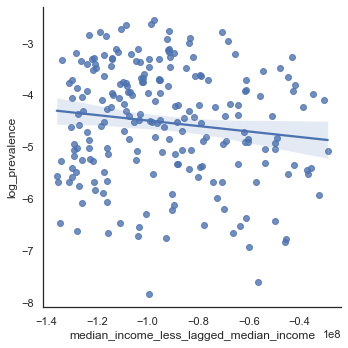

In [ ]:
sns.lmplot(
    data=tract_features_nonan,
    x='median_income_less_lagged_median_income',
    y='log_prevalence'
)

In [ ]:
lm_ = smf.ols('log_prevalence ~ median_income_less_lagged_median_income', data=tract_features_nonan).fit()
lm_.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         log_prevalence   R-squared:                       0.017
Model:                            OLS   Adj. R-squared:                  0.012
Method:                 Least Squares   F-statistic:                     3.699
Date:                Thu, 05 May 2022   Prob (F-statistic):             0.0558
Time:                        09:48:27   Log-Likelihood:                -325.00
No. Observations:                 216   AIC:                             654.0
Df Residuals:                     214   BIC:                             660.8
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
===========================================================================================================
                                              coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
Intercept                                  -5.0233      0.268    -18.770      0.000      -5.551      -4.496
median_income_less_lagged_median_income -5.285e-09   2.75e-09     -1.923      0.056   -1.07e-08    1.31e-10
==============================================================================
Omnibus:                        9.530   Durbin-Watson:                   1.507
Prob(Omnibus):                  0.009   Jarque-Bera (JB):                9.115
Skew:                          -0.451   Prob(JB):                       0.0105
Kurtosis:                       2.553   Cond. No.                     3.50e+08
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 3.5e+08. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
lm_ = smf.ols('log_prevalence ~ Q("median income") + lagged_median_income', data=tract_features_nonan).fit()
lm_.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         log_prevalence   R-squared:                       0.445
Model:                            OLS   Adj. R-squared:                  0.440
Method:                 Least Squares   F-statistic:                     85.49
Date:                Thu, 05 May 2022   Prob (F-statistic):           5.54e-28
Time:                        09:49:22   Log-Likelihood:                -263.21
No. Observations:                 216   AIC:                             532.4
Df Residuals:                     213   BIC:                             542.5
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
Intercept               -3.0047      0.256    -11.751      0.000      -3.509      -2.501
Q("median income")   -4.377e-05   3.41e-06    -12.826      0.000   -5.05e-05    -3.7e-05
lagged_median_income  3.995e-09   2.07e-09      1.929      0.055    -8.8e-11    8.08e-09
==============================================================================
Omnibus:                       44.796   Durbin-Watson:                   1.986
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              141.005
Skew:                          -0.830   Prob(JB):                     2.41e-31
Kurtosis:                       6.593   Cond. No.                     4.44e+08
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 4.44e+08. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
lm_ = smf.ols('Q("count of individuals with warrant record") ~ Q("median income") + lagged_median_income', data=tract_features_nonan).fit()
lm_.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                          OLS Regression Results                                         
=========================================================================================================
Dep. Variable:     Q("count of individuals with warrant record")   R-squared:                       0.348
Model:                                                       OLS   Adj. R-squared:                  0.342
Method:                                            Least Squares   F-statistic:                     56.83
Date:                                           Fri, 06 May 2022   Prob (F-statistic):           1.67e-20
Time:                                                   16:17:19   Log-Likelihood:                -1251.9
No. Observations:                                            216   AIC:                             2510.
Df Residuals:                                                213   BIC:                             2520.
Df Model:                                                      2                                         
Covariance Type:                                       nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
Intercept              857.2525    110.513      7.757      0.000     639.412    1075.093
Q("median income")      -0.0010      0.000     -1.989      0.048      -0.002   -8.75e-06
lagged_median_income    -0.0169      0.003     -5.789      0.000      -0.023      -0.011
==============================================================================
Omnibus:                       70.618   Durbin-Watson:                   2.009
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              185.288
Skew:                           1.444   Prob(JB):                     5.83e-41
Kurtosis:                       6.499   Cond. No.                     1.26e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.26e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
import spreg

In [ ]:
np.expand_dims(tract_features_nonan['log_prevalence'].values,1)

(216, 1)

In [ ]:
np.expand_dims(tract_features_nonan['median income'].values,1).shape

(216, 1)

In [ ]:
tract_features_nonan[['median income','total: hhs received SNAP']].values

array([[3.1372e+04, 1.4400e+02],
       [5.4214e+04, 4.1000e+01],
       [4.9370e+04, 1.1000e+01],
       [3.9299e+04, 2.7000e+01],
       [3.9225e+04, 8.0000e+01],
       [8.2348e+04, 0.0000e+00],
       [3.9764e+04, 1.0100e+02],
       [5.2070e+04, 7.9000e+01],
       [3.0698e+04, 1.6200e+02],
       [4.3082e+04, 1.4000e+01],
       [6.9646e+04, 0.0000e+00],
       [2.3365e+04, 3.5100e+02],
       [2.6574e+04, 1.2300e+02],
       [4.4148e+04, 6.0000e+01],
       [5.2528e+04, 9.0000e+01],
       [4.1438e+04, 1.2200e+02],
       [3.3866e+04, 5.7000e+01],
       [2.4141e+04, 6.5200e+02],
       [2.3497e+04, 9.2200e+02],
       [4.1239e+04, 1.3700e+02],
       [3.2588e+04, 3.4000e+02],
       [6.4787e+04, 3.0000e+00],
       [6.4756e+04, 0.0000e+00],
       [6.9885e+04, 2.3000e+01],
       [7.4375e+04, 1.0000e+01],
       [4.2297e+04, 3.8000e+01],
       [5.3469e+04, 6.0000e+01],
       [3.5968e+04, 1.4800e+02],
       [3.9570e+04, 1.3400e+02],
       [3.4463e+04, 7.2000e+01],
       [5.

In [ ]:
mllag = spreg.ML_Lag(
    y=np.expand_dims(tract_features_nonan['log_prevalence'].values,1),
    x=np.expand_dims(tract_features_nonan['median income'].values,1),
    w=W,
    method='ord'
)

In [ ]:
mllag.betas

array([[-3.03588808e+00],
       [-4.34142792e-05],
       [-3.97903355e-05]])

In [ ]:
mllag.pr2

0.4463989146135684

In [ ]:
tract_features.columns

Index(['total population', '[denominator: total population for Race]',
       'total: White', 'total: Black', 'total: Asian',
       '[denominator: total population for Hispanic or Latino]',
       'total: Hispanic or Latino (any race)',
       '[denominator: total population for poverty]',
       'total: income below poverty level', 'median gross rent',
       '[denominator: total population for income on rent]',
       'total: paying >50 percent of income on rent', 'NAME', 'state',
       'county', 'tract', 'count of individuals with warrant record',
       'warrant prevalence', 'geometry', 'total tract balance',
       'percent poverty', 'mean balance', 'median income',
       'most frequent citation', 'most costly citation', 'total: households',
       'total: hhs received SNAP', 'balance per household',
       'balance per household per median rent', 'log_prevalence'],
      dtype='object')

In [ ]:
pm = smf.poisson('Q("count of individuals with warrant record") ~ Q("median income")', data=tract_features).fit()

         Current function value: 615452707824372144930816.000000
         Iterations: 35


/opt/anaconda3/envs/mapper2/lib/python3.7/site-packages/statsmodels/base/model.py:606: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)


In [ ]:
pm.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                        Poisson Regression Results                                       
=========================================================================================================
Dep. Variable:     Q("count of individuals with warrant record")   No. Observations:                  216
Model:                                                   Poisson   Df Residuals:                      214
Method:                                                      MLE   Df Model:                            1
Date:                                           Thu, 05 May 2022   Pseudo R-squ.:              -1.315e+22
Time:                                                   11:28:59   Log-Likelihood:            -1.3294e+26
converged:                                                 False   LL-Null:                       -10109.
Covariance Type:                                       nonrobust   LLR p-value:                     1.000
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
Intercept            -30.4456   1.24e-11  -2.46e+12      0.000     -30.446     -30.446
Q("median income")     0.0010   1.37e-16   7.28e+12      0.000       0.001       0.001
======================================================================================
"""

In [ ]:
pm = smf.poisson('Q("warrant prevalence") ~ Q("median income")', data=tract_features).fit()

         Current function value: 114566548083349143552.000000
         Iterations: 35


/opt/anaconda3/envs/mapper2/lib/python3.7/site-packages/statsmodels/base/model.py:606: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)


In [ ]:
pm.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                             Poisson Regression Results                            
===================================================================================
Dep. Variable:     Q("warrant prevalence")   No. Observations:                  216
Model:                             Poisson   Df Residuals:                      214
Method:                                MLE   Df Model:                            1
Date:                     Thu, 05 May 2022   Pseudo R-squ.:              -1.444e+21
Time:                             11:30:44   Log-Likelihood:            -2.4746e+22
converged:                           False   LL-Null:                       -17.136
Covariance Type:                 nonrobust   LLR p-value:                     1.000
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
Intercept            -39.0345   9.05e-10  -4.31e+10      0.000     -39.035     -39.035
Q("median income")     0.0010   1.01e-14   9.93e+10      0.000       0.001       0.001
======================================================================================
"""

In [ ]:
import statsmodels
from statsmodels.tools.tools import add_constant

In [ ]:
pm_ = statsmodels.discrete.discrete_model.Poisson(
    endog=tract_features_nonan['warrant prevalence'],
    exog=add_constant(tract_features_nonan['median income'])
).fit(maxiter=200)

Optimization terminated successfully.
         Current function value: 0.076935
         Iterations 93


In [ ]:
pm_.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                          Poisson Regression Results                          
==============================================================================
Dep. Variable:     warrant prevalence   No. Observations:                  216
Model:                        Poisson   Df Residuals:                      214
Method:                           MLE   Df Model:                            1
Date:                Thu, 05 May 2022   Pseudo R-squ.:                 0.03023
Time:                        11:40:02   Log-Likelihood:                -16.618
converged:                       True   LL-Null:                       -17.136
Covariance Type:            nonrobust   LLR p-value:                    0.3087
=================================================================================
                    coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------
const            -2.6650      1.370     -1.945      0.052      -5.351       0.021
median income -3.504e-05   3.61e-05     -0.971      0.332      -0.000    3.57e-05
=================================================================================
"""

In [ ]:
pm_w = statsmodels.discrete.discrete_model.Poisson(
    endog=tract_features_nonan['warrant prevalence'],
    exog=add_constant(tract_features_nonan[['median income','lagged_median_income']])
).fit(maxiter=200)

Optimization terminated successfully.
         Current function value: 0.075633
         Iterations 140


In [ ]:
pm_w.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                          Poisson Regression Results                          
==============================================================================
Dep. Variable:     warrant prevalence   No. Observations:                  216
Model:                        Poisson   Df Residuals:                      213
Method:                           MLE   Df Model:                            2
Date:                Fri, 06 May 2022   Pseudo R-squ.:                 0.04665
Time:                        15:18:28   Log-Likelihood:                -16.337
converged:                       True   LL-Null:                       -17.136
Covariance Type:            nonrobust   LLR p-value:                    0.4496
========================================================================================
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    6.0404     12.236      0.494      0.622     -17.942      30.022
median income        -1.095e-05   5.07e-05     -0.216      0.829      -0.000    8.84e-05
lagged_median_income    -0.0002      0.000     -0.714      0.475      -0.001       0.000
========================================================================================
"""

In [ ]:
tract_features.columns

Index(['total population', '[denominator: total population for Race]',
       'total: White', 'total: Black', 'total: Asian',
       '[denominator: total population for Hispanic or Latino]',
       'total: Hispanic or Latino (any race)',
       '[denominator: total population for poverty]',
       'total: income below poverty level', 'median gross rent',
       '[denominator: total population for income on rent]',
       'total: paying >50 percent of income on rent', 'NAME', 'state',
       'county', 'tract', 'count of individuals with warrant record',
       'warrant prevalence', 'geometry', 'total tract balance',
       'percent poverty', 'mean balance', 'median income',
       'most frequent citation', 'most costly citation', 'total: households',
       'total: hhs received SNAP', 'balance per household',
       'balance per household per median rent', 'log_prevalence'],
      dtype='object')

In [ ]:
plt.rcParams["figure.dpi"] = 100

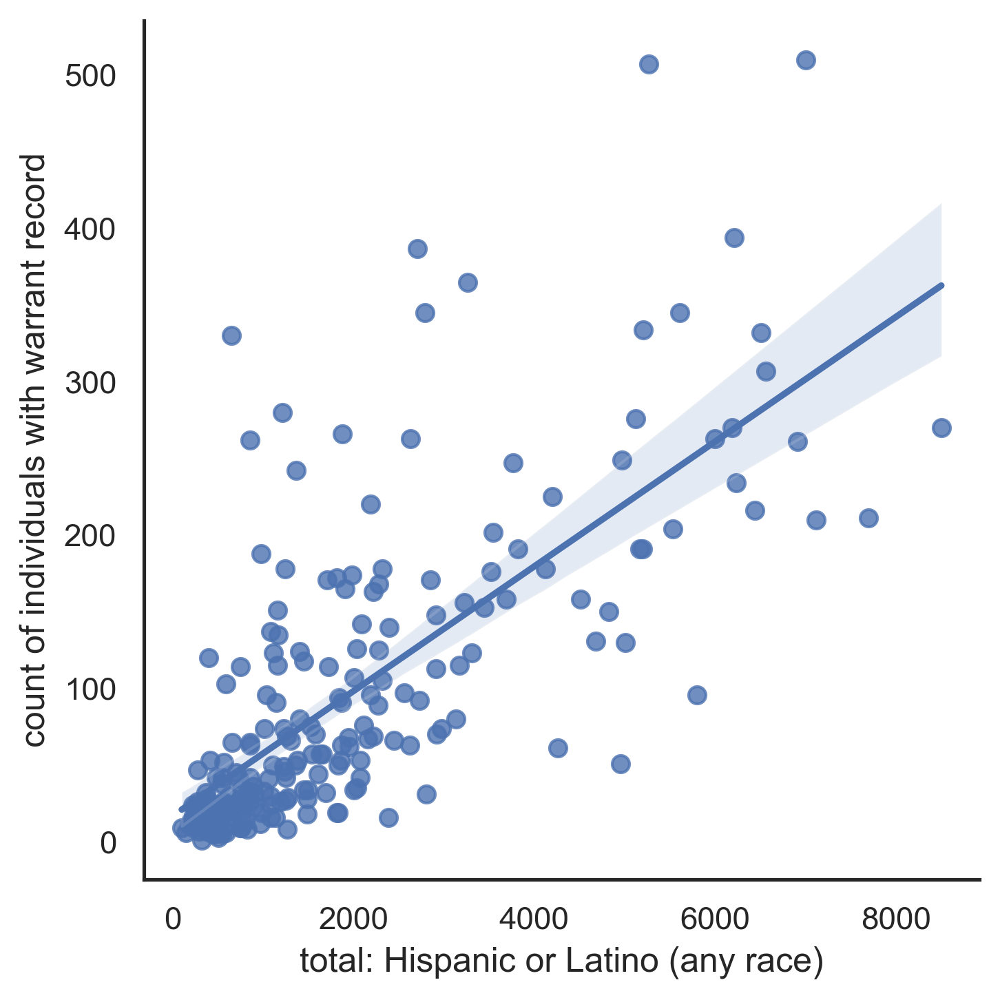

In [ ]:
sns.lmplot(
    data=tract_features_nonan,
    y='count of individuals with warrant record',
    x='total: Hispanic or Latino (any race)'
)

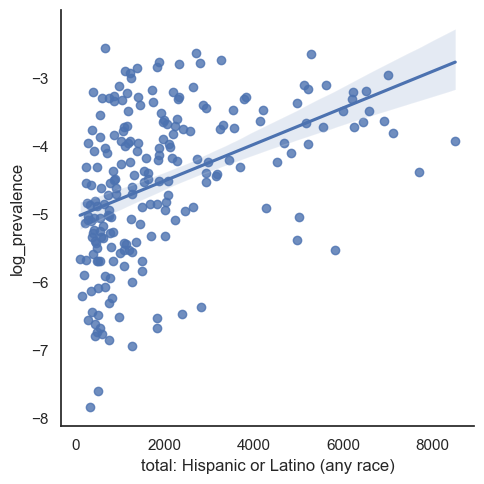

In [ ]:
sns.lmplot(
    data=tract_features_nonan,
    y='log_prevalence',
    x='total: Hispanic or Latino (any race)'
)

In [ ]:
lm_ = smf.ols('Q("count of individuals with warrant record") ~ Q("total: Hispanic or Latino (any race)")', data=tract_features_nonan).fit()
lm_.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                          OLS Regression Results                                         
=========================================================================================================
Dep. Variable:     Q("count of individuals with warrant record")   R-squared:                       0.526
Model:                                                       OLS   Adj. R-squared:                  0.524
Method:                                            Least Squares   F-statistic:                     237.4
Date:                                           Fri, 06 May 2022   Prob (F-statistic):           1.56e-36
Time:                                                   15:49:34   Log-Likelihood:                -1217.5
No. Observations:                                            216   AIC:                             2439.
Df Residuals:                                                214   BIC:                             2446.
Df Model:                                                      1                                         
Covariance Type:                                       nonrobust                                         
=============================================================================================================
                                                coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------------
Intercept                                    16.9639      6.871      2.469      0.014       3.420      30.507
Q("total: Hispanic or Latino (any race)")     0.0407      0.003     15.407      0.000       0.035       0.046
==============================================================================
Omnibus:                       86.476   Durbin-Watson:                   1.649
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              273.432
Skew:                           1.703   Prob(JB):                     4.22e-60
Kurtosis:                       7.334   Cond. No.                     3.86e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 3.86e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
tract_features_nonan['lagged_Hispanic'] = libpysal.weights.lag_spatial(
    y=tract_features_nonan['total: Hispanic or Latino (any race)'],
    w=W

)

/opt/anaconda3/envs/mapper2/lib/python3.7/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [ ]:
lm_ = smf.ols('Q("count of individuals with warrant record") ~ Q("total: Hispanic or Latino (any race)") + lagged_Hispanic', data=tract_features_nonan).fit()
lm_.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                          OLS Regression Results                                         
=========================================================================================================
Dep. Variable:     Q("count of individuals with warrant record")   R-squared:                       0.601
Model:                                                       OLS   Adj. R-squared:                  0.598
Method:                                            Least Squares   F-statistic:                     160.7
Date:                                           Fri, 06 May 2022   Prob (F-statistic):           2.87e-43
Time:                                                   15:53:43   Log-Likelihood:                -1198.8
No. Observations:                                            216   AIC:                             2404.
Df Residuals:                                                213   BIC:                             2414.
Df Model:                                                      2                                         
Covariance Type:                                       nonrobust                                         
=============================================================================================================
                                                coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------------
Intercept                                   -72.6296     15.455     -4.699      0.000    -103.095     -42.165
Q("total: Hispanic or Latino (any race)")     0.0399      0.002     16.443      0.000       0.035       0.045
lagged_Hispanic                             2.28e-05   3.59e-06      6.351      0.000    1.57e-05    2.99e-05
==============================================================================
Omnibus:                       93.093   Durbin-Watson:                   1.957
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              337.797
Skew:                           1.781   Prob(JB):                     4.45e-74
Kurtosis:                       7.985   Cond. No.                     1.51e+07
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.51e+07. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
lm_ = smf.ols('log_prevalence ~ Q("total: Hispanic or Latino (any race)") + lagged_Hispanic', data=tract_features_nonan).fit()
lm_.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         log_prevalence   R-squared:                       0.438
Model:                            OLS   Adj. R-squared:                  0.433
Method:                 Least Squares   F-statistic:                     83.02
Date:                Fri, 06 May 2022   Prob (F-statistic):           2.20e-27
Time:                        16:18:17   Log-Likelihood:                -264.61
No. Observations:                 216   AIC:                             535.2
Df Residuals:                     213   BIC:                             545.3
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
=============================================================================================================
                                                coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------------
Intercept                                    -6.8772      0.205    -33.617      0.000      -7.280      -6.474
Q("total: Hispanic or Latino (any race)")     0.0003   3.21e-05      7.863      0.000       0.000       0.000
lagged_Hispanic                            4.667e-07   4.75e-08      9.823      0.000    3.73e-07     5.6e-07
==============================================================================
Omnibus:                        2.127   Durbin-Watson:                   1.962
Prob(Omnibus):                  0.345   Jarque-Bera (JB):                1.819
Skew:                          -0.128   Prob(JB):                        0.403
Kurtosis:                       3.369   Cond. No.                     1.51e+07
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.51e+07. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
lm_ = smf.ols('Q("warrant prevalence") ~ Q("total: Hispanic or Latino (any race)") + lagged_Hispanic', data=tract_features_nonan).fit()
lm_.summary()




<class 'statsmodels.iolib.summary.Summary'>
"""
                               OLS Regression Results                              
===================================================================================
Dep. Variable:     Q("warrant prevalence")   R-squared:                       0.338
Model:                                 OLS   Adj. R-squared:                  0.332
Method:                      Least Squares   F-statistic:                     54.40
Date:                     Fri, 06 May 2022   Prob (F-statistic):           8.22e-20
Time:                             16:19:04   Log-Likelihood:                 626.95
No. Observations:                      216   AIC:                            -1248.
Df Residuals:                          213   BIC:                            -1238.
Df Model:                                2                                         
Covariance Type:                 nonrobust                                         
=============================================================================================================
                                                coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------------
Intercept                                    -0.0130      0.003     -3.955      0.000      -0.020      -0.007
Q("total: Hispanic or Latino (any race)")  3.267e-06   5.18e-07      6.303      0.000    2.25e-06    4.29e-06
lagged_Hispanic                            6.129e-09   7.66e-10      8.002      0.000    4.62e-09    7.64e-09
==============================================================================
Omnibus:                       83.367   Durbin-Watson:                   2.069
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              237.096
Skew:                           1.691   Prob(JB):                     3.27e-52
Kurtosis:                       6.860   Cond. No.                     1.51e+07
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.51e+07. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

## how many people with warrants per person in Austin?

In [ ]:
austin_bound

,MTFCC,OID,GEOID,STATE,PLACE,BASENAME,NAME,LSADC,FUNCSTAT,PLACECC,...,AREAWATER,CBSAPCI,NECTAPCI,CENTLAT,CENTLON,INTPTLAT,INTPTLON,PLACENS,OBJECTID,geometry
0,G4110,27859327911139,4805000,48,05000,Austin,Austin city,25,A,C1,...,17024633,Y,N,+30.3004390,-097.7522144,+30.3011573,-097.7526951,02409761,13137,"MULTIPOLYGON (((-10861395.963 3539572.137, -10..."


In [ ]:
ids

,ID,Name,GEOID,Case #,Citation,Date Ticket Issued,Time,Latest Action,Balance Due,Status,geometry,Type
0,913064,"Abbott, Randall R",48453001774,8082522,ALCOHOL AT PARK,4/30/2014,04:14:00,Issued,456.3,WARRANT,POINT (-97.84550 30.15781),City Ordinance
1,2137171,"Acosta, Jose",48453001774,8638021,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,11/6/2017,12:20:00,Issued,514.8,WARRANT,POINT (-97.84166 30.15631),Traffic
2,2137171,"Acosta, Jose",48453001774,8638022,NO DRIVERS LICENSE,11/6/2017,12:20:00,Issued,292.5,WARRANT,POINT (-97.84166 30.15631),Traffic
3,2137171,"Acosta, Jose",48453001774,8638023,SPEEDING - STATE HIGHWAY - LESS THAN 10% OVER ...,11/6/2017,12:20:00,Issued,280.8,WARRANT,POINT (-97.84166 30.15631),Traffic
4,2153515,"Aguilar-Garcia, Jessica",48453001774,8820781,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,2/27/2020,04:07:00,Issued,514.1,WARRANT,POINT (-97.83633 30.15367),Traffic
...,...,...,...,...,...,...,...,...,...,...,...,...
74523,2243277,"Martinez, Richard",48453001919,8745028,ELECTRONIC DEVICE USE WHILE DRIVING,2/7/2019,08:22:00,Issued,448.5,WARRANT,POINT (-97.78762 30.27831),City Ordinance
74524,2243277,"Martinez, Richard",48453001919,8745029,NO DRIVERS LICENSE,2/7/2019,08:22:00,Issued,292.5,WARRANT,POINT (-97.78762 30.27831),Traffic
74525,1787280,"Gutierres, Maria",48453001918,8231835,ELECTRONIC DEVICE USE WHILE DRIVING,2/10/2015,10:05:00,Issued,448.5,WARRANT,POINT (-97.81685 30.29616),City Ordinance
74526,1787280,"Gutierres, Maria",48453001918,8231836,FAILED TO MAINTAIN FINANCIAL RESPONSIBILITY,2/10/2015,10:05:00,Issued,514.8,WARRANT,POINT (-97.81685 30.29616),Traffic


In [ ]:
ids_in_austin = gpd.sjoin(ids.to_crs(austin_bound.crs), austin_bound)

In [ ]:
ids_in_austin['ID'].shape[0]

28332

In [ ]:
ids_in_austin['ID'].nunique()

14267

In [ ]:
ids_in_austin['ID'].nunique() / austin_total_pop

0.014832797043213374

In [ ]:
individuals_with_warrants_in_austin_per_total_pop = ids_in_austin['ID'].nunique() / austin_total_pop

In [ ]:
case_table[case_table['Status'].isin(['WARRANT','COMMITMENT'])]['Case #'].nunique()

65682

In [ ]:
case_table[case_table['Status'].isin(['WARRANT','COMMITMENT'])]['Case #'].nunique() / austin_total_pop

0.06828679998544479

In [ ]:
warrant_records_per_total_pop = case_table[case_table['Status'].isin(['WARRANT','COMMITMENT'])]['Case #'].nunique() / austin_total_pop

In [ ]:
individuals_with_warrants_in_austin_per_total_pop  / warrant_records_per_total_pop

0.21721323954812582

In [ ]:
# for St Louis number 

0.99 * (individuals_with_warrants_in_austin_per_total_pop  / warrant_records_per_total_pop)

0.21504110715264457

In [ ]:
austin_total_pop

961855

In [ ]:
ids_in_austin['ID'].nunique()

14267

In [ ]:
individuals_with_warrants_acl

14267

Text(0.5, 1.0, 'St. Louis (modeled)')

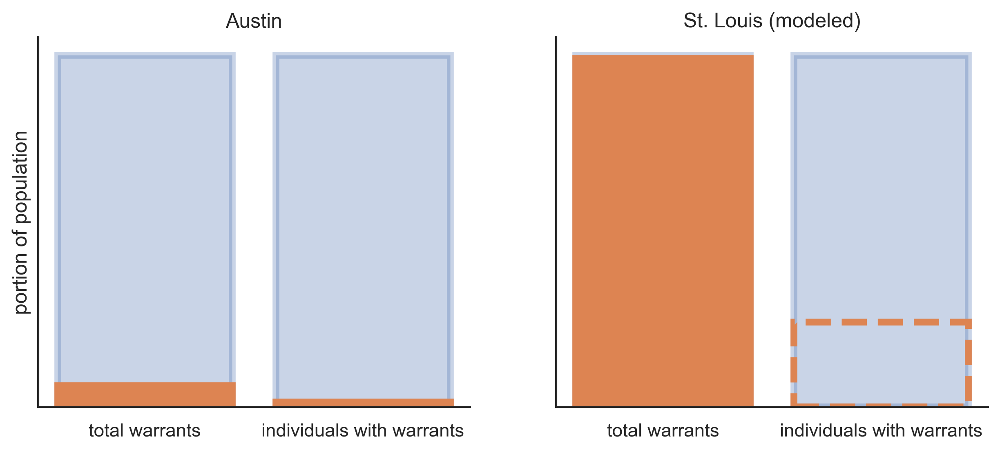

In [ ]:
fig, (aust, stlo) = plt.subplots(1,2,figsize=(10,4),dpi=300)

aust.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[austin_total_pop,austin_total_pop],
    edgecolor='C0',
    alpha=0.3,
    linewidth=4
)

aust.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[total_warrants, individuals_with_warrants_acl],
    color='C1',
    edgecolor='C1',
    linewidth=4
)

aust.set_ylabel('portion of population')
aust.set_yticks([])
#aust.ticklabel_format(axis="y", style="plain")


sns.despine()

aust.set_title('Austin')

stlo.bar(
    x=['total warrants', 'individuals with warrants'],
    height=[stlouis_total_pop,stlouis_total_pop],
    edgecolor='C0',
    alpha=0.3,
    linewidth=4
    
)

stlo.bar(
    x='total warrants',
    height=stlouis_total_pop * .99,
    color='C1',
    edgecolor='C1',
    linewidth=4,
)

stlo.bar(
    x='individuals with warrants',
    height=stlouis_total_pop * .99 * warrants_to_individuals_with_warrants_ratio,
    color='none',
    edgecolor='C1',
    linewidth=4,
    ls='--'
)


stlo.get_yaxis().set_visible(False)


sns.despine()

stlo.set_title('St. Louis (modeled)')







In [ ]:
tract_features.to_file('tract_features__.geojson', driver='GeoJSON')